## Step 1: load data into python file
### Step 1.1: Load interest rate and libor rate

In [544]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import seaborn as sns
import os 
sns.set_style('whitegrid')

import string
from datetime import datetime
import re
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.tokenize import RegexpTokenizer
from nltk.stem.porter import PorterStemmer

tokenizer = RegexpTokenizer(r'\w+') # initialize regex tokenizer
exclude = set(string.punctuation)
en_stop = set(stopwords.words('english'))# create English stop words list
lemma = WordNetLemmatizer()
p_stemmer = PorterStemmer() # Create p_stemmer of class PorterStemmer

def preprocess_data(doc_set):
    """
    Input  : docuemnt list
    Purpose: preprocess text (tokenize, removing stopwords, and stemming)
    Output : preprocessed text
    """
    # list for tokenized documents in loop
    texts = []
    # loop through document list
    for raw in doc_set:
        # clean and tokenize document string
        tokens = tokenizer.tokenize(raw.lower())
        # remove stop words and unwanted words from tokens
        stopped_tokens = [i for i in tokens if (i not in en_stop) and (i not in exclude)]
        # stem tokens
        stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in stopped_tokens]
        # add tokens to list
        texts.append(stemmed_tokens)
    return texts
def show_section_name(document_list):
    return [[k[0] for k in i] for i in document_list]

def show_unique_section_name(document_list):
    result = {}
    for i in document_list:
        for k in i:
            if k[0] not in result:
                result[k[0]]=1
            else:
                result[k[0]]+=1
    return {k: v for k, v in sorted(result.items(), key=lambda item: -item[1])}



def rule_for_merge(list_of_names,target_name,document_list):
    new_document_list = document_list.copy()
    list_of_names = list_of_names+[target_name]
    for n,document in enumerate(document_list):
        new_document = []
        merged_paragraph = [target_name]
        for paragraph in document:
            if paragraph[0] not in list_of_names:
                new_document.append(paragraph)
            else:
                merged_paragraph = merged_paragraph + paragraph[1:]
        if merged_paragraph!=[target_name]:
            new_document.append(merged_paragraph)
        new_document_list[n] = new_document
    return new_document_list

def rule_for_replace(dict1,document_list):
    for orignal_name in dict1.keys():
        target_name = dict1[orignal_name]
        for n,document in enumerate(document_list):
            for k,paragraph in enumerate(document):
                if paragraph[0] == orignal_name:
                    document_list[n][k][0]= target_name
    return document_list


def encode_doc_minutes(Document_list):
    return '##NewTopic##'.join(['##NewPara##'.join(i) for i in Document_list])

def decode_doc_minutes(Doc_string):
    return [i.split('##NewPara##') for i in Doc_string.split('##NewTopic##')]

def load_up_from_cleaned_minutes():
    MPC_minutes = pd.read_excel('./scripter/cleaned_dataset/MPC_minutes.xlsx')
    file_list = os.listdir("./scripter/cleaned_dataset/Minutes_MPC")
    for n,file in enumerate(file_list):
        text_file = open("./scripter/cleaned_dataset/Minutes_MPC/{}".format(file), "r").read()
        MPC_minutes.loc[MPC_minutes['title']==file[:-4],'document_string'] = text_file
    return MPC_minutes

def write_file(Document_list,folder,file):
    Word_set = encode_doc_minutes(Document_list)
    text_file = open("./scripter/cleaned_dataset/{}/{}.txt".format(folder,file[:-5]), "w")
    text_file.write(Word_set)
    text_file.close()    
    return None

def load_interest_rate():
    data_list = []
    for i in ['LIBOR_1M.csv','LIBOR_3M.csv','LIBOR_6M.csv','LIBOR_1Y.csv']:
        df = pd.read_csv('./scripter/cleaned_dataset/{}'.format(i),index_col = 0)
        df.columns = [i[:-4]]
        data_list.append(df)
    libor_rate = pd.concat(data_list,axis=1).dropna()
    for i in range(3):
        libor_rate.iloc[:,i] = libor_rate.iloc[:,i].astype(float).round(4)
        
    data_list = []
    for i in ['interbank_sonia.csv','interbank_1M.csv','interbank_1Y.csv','Euro_currency_offered_rates_USD.csv','Euro_currency_offered_rates_EUR.csv']:
        df = pd.read_csv('./scripter/cleaned_dataset/{}'.format(i),index_col = 0)
        df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
        df.columns = [i[:-4]]
        data_list.append(df)
    sonia_rate = data_list[0].join(data_list[1]).join(data_list[2]).join(data_list[3]).join(data_list[4])
    merged_dataset = libor_rate.join(sonia_rate,how='outer')
    items = list(merged_dataset)
    merged_dataset = merged_dataset.loc[merged_dataset.index>'1997-01-01',:]
    return merged_dataset

def create_label_for_dictionary(list_of_value,date_range):
    date_range = merged_dataset.index
    if list_of_value[-1] == np.nan:
        list_of_value[-1] = list_of_value[-2]
    plot_positive = [np.nan for i in list_of_value]
    plot_negative = [np.nan for i in list_of_value]

    rate_change = [0 for i in list_of_value]
    threshold = 0.1
    for i in range(12,len(rate_change)-12):
        if list_of_value[i]-list_of_value[i+12]>threshold:
            rate_change[i] = -1
            plot_negative[i] = list_of_value[i]
        elif list_of_value[i]-list_of_value[i+12]<-threshold:
            rate_change[i] = 1
            plot_positive[i] = list_of_value[i]
    plt.figure(figsize=(10,5),dpi=120)
    plt.plot(date_range,list_of_value,color='#757575')
    plt.plot(date_range,plot_positive,color='#42bdb9',lw=3,label='positive label')
    plt.plot(date_range,plot_negative,color='#ef6565',lw=3,label='negative label')
    plt.legend()
    return rate_change

def create_label_for_dictionary_2(list_of_value,date_range):
    date_range = merged_dataset.index
    if list_of_value[-1] == np.nan:
        list_of_value[-1] = list_of_value[-2]
    plot_positive = [np.nan for i in list_of_value]
    plot_negative = [np.nan for i in list_of_value]

    rate_change = [0 for i in list_of_value]

    N = len(rate_change)
    for i in range(0,N-8):
        for k in range(7):
            if list_of_value[i+k] == list_of_value[i+k+1]:
                pass
            elif list_of_value[i+k] > list_of_value[i+k+1]:
                rate_change[i] = -1
                plot_negative[i] = list_of_value[i]
                break
            elif list_of_value[i+k] < list_of_value[i+k+1]:
                rate_change[i] = 1
                plot_positive[i] = list_of_value[i]
                break
        if rate_change[i] == 0 and i>=1:
            if list_of_value[i] > list_of_value[i-1]:
                rate_change[i] = 1
                plot_positive[i] = list_of_value[i] 
            elif list_of_value[i] < list_of_value[i-1]:
                rate_change[i] = -1
                plot_negative[i] = list_of_value[i]                
    plt.figure(figsize=(10,5),dpi=120)
    plt.plot(date_range,list_of_value,color='#757575')
    plt.plot(date_range,plot_positive,color='#42bdb9',lw=3,label='positive label')
    plt.plot(date_range,plot_negative,color='#ef6565',lw=3,label='negative label')
    plt.legend()
    return rate_change



[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\lunarhero\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\lunarhero\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\lunarhero\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


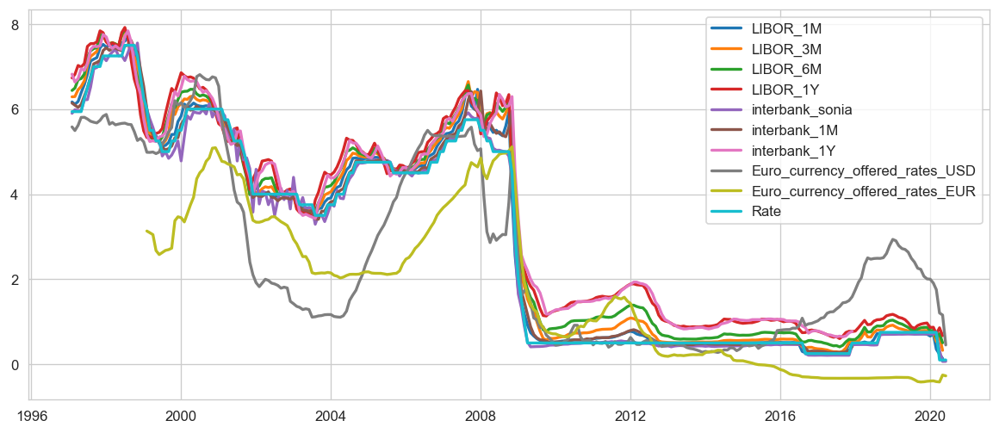

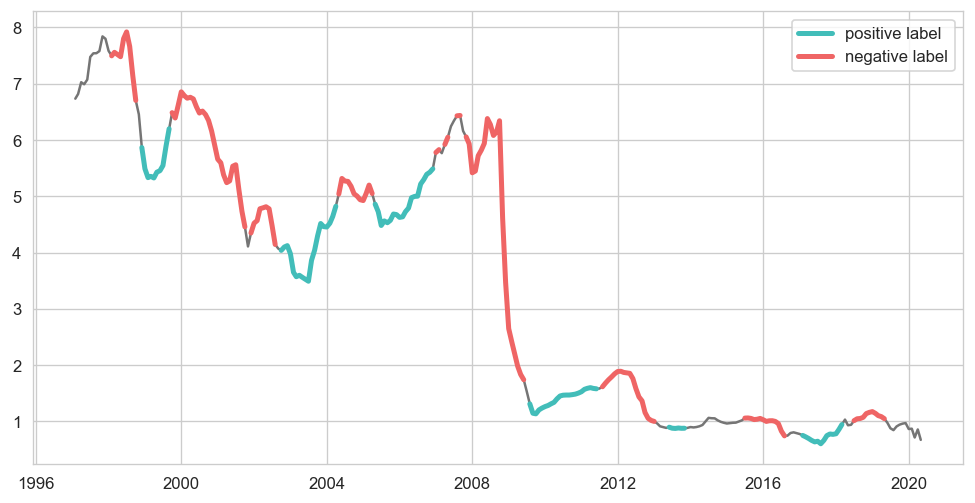

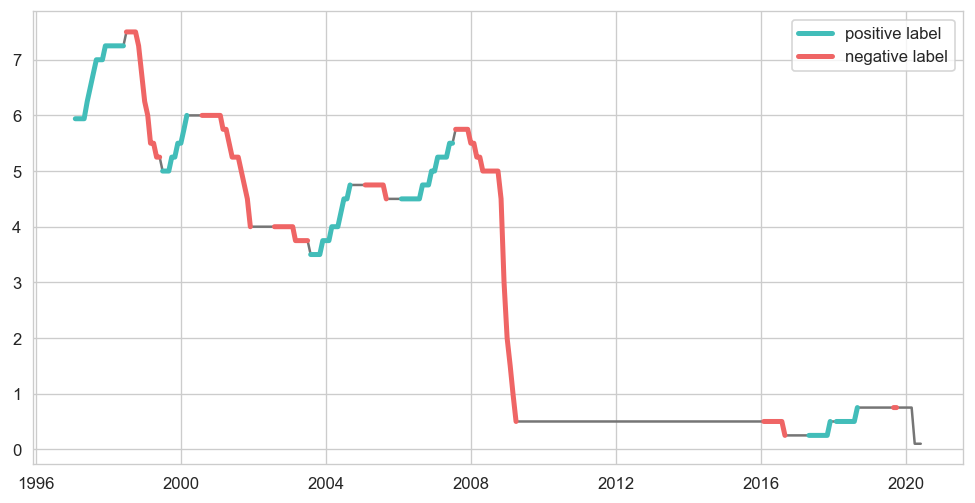

In [545]:
merged_dataset = load_interest_rate()

base_rate = pd.read_csv('./scripter/cleaned_dataset/Bank Rate  Bank of England Database.csv',index_col = 0)
base_rate.index = pd.DatetimeIndex(base_rate.index)
base_rate = base_rate.reindex(pd.date_range(start = base_rate.index[-1], end = merged_dataset.index[-1]))
for i in range(1,len(base_rate)):
    if base_rate.iloc[i,0]!=base_rate.iloc[i,0]:
        base_rate.iloc[i,0]=base_rate.iloc[i-1,0]
merged_dataset = merged_dataset.join(base_rate,how='inner')
items = list(merged_dataset)
plt.figure(figsize=(12,5),dpi=120)
for i in range(len(items)):
    plt.plot(merged_dataset.index,merged_dataset.iloc[:,i].values,label = items[i],lw=2)
plt.legend()
plt.show()

date_range = merged_dataset.index
list_of_value = merged_dataset.LIBOR_1Y.values
rate_change = create_label_for_dictionary(list_of_value,date_range)
date_range = merged_dataset.index
list_of_value_2 = merged_dataset.Rate.values
rate_change_2 = create_label_for_dictionary_2(list_of_value_2,date_range)

In [543]:
for i in ['LIBOR_1M.csv','LIBOR_3M.csv','LIBOR_6M.csv','LIBOR_1Y.csv']:
    i =i[:-4]
    y =[np.nan]+list((merged_dataset.loc[:,i].values[1:] - merged_dataset.loc[:,i].values[:-1])/merged_dataset.loc[:,i].values[:-1])
    merged_dataset.loc[:,'{}_change'.format(i)] = y
merged_dataset

,LIBOR_1M,LIBOR_3M,LIBOR_6M,LIBOR_1Y,interbank_sonia,interbank_1M,interbank_1Y,Euro_currency_offered_rates_USD,Euro_currency_offered_rates_EUR,Rate,LIBOR_1M_change,LIBOR_3M_change,LIBOR_6M_change,LIBOR_1Y_change
1997-02-01,6.1688,6.2885,6.4377,6.732813,5.9005,6.1416,6.8202,5.5809,NaN,5.94,NaN,NaN,NaN,NaN
1997-03-01,6.1123,6.2938,6.4938,6.816202,5.9850,6.0913,6.6358,5.4950,NaN,5.94,-0.009159,0.000843,0.008714,0.012385
1997-04-01,6.1772,6.4544,6.6903,7.025036,5.9651,6.0389,6.7147,5.6168,NaN,5.94,0.010618,0.025517,0.030260,0.030638
1997-05-01,6.3838,6.5316,6.7180,6.989064,5.9618,6.1086,6.9486,5.8041,NaN,5.94,0.033446,0.011961,0.004140,-0.005121
1997-06-01,6.5767,6.6646,6.8229,7.071599,6.2154,6.3043,6.9090,5.8075,NaN,6.25,0.030217,0.020363,0.015615,0.011809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-01,0.7068,0.7462,0.7958,0.869664,0.7113,NaN,NaN,1.9082,-0.3911,0.75,0.067029,0.012071,0.005052,0.006194
2020-03-01,0.3520,0.5322,0.6138,0.713304,0.7104,NaN,NaN,1.7535,-0.4089,0.75,-0.501981,-0.286786,-0.228701,-0.179794
2020-04-01,0.2335,0.6442,0.7189,0.856365,0.3192,NaN,NaN,1.2055,-0.4166,0.10,-0.336648,0.210447,0.171228,0.200562
2020-05-01,0.1366,0.3267,0.5041,0.671318,0.0659,NaN,NaN,1.1570,-0.2541,0.10,-0.414989,-0.492859,-0.298790,-0.216084


### Step 1.2: load speech data

In [3]:
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel
from gensim.models import TfidfModel
from gensim.models.ldamulticore import LdaMulticore
from gensim import corpora

def load_up_from_cleaned_speech():
    MPC_speech = pd.read_excel('./scripter/cleaned_dataset/MPC_speech.xlsx')
    file_list = os.listdir("./scripter/cleaned_dataset/Speech_MPC")
    for n,file in enumerate(file_list):
        text_file = open("./scripter/cleaned_dataset/Speech_MPC/{}".format(file), "r").read()
        MPC_speech.loc[MPC_speech['title']==file[:-4],'document_string'] = text_file
    return MPC_speech

def sentiment_calculator_speech(dictionary,doc_list):
    document = ''
    for para in doc_list:      
        document += para+' '
    tokens = tokenizer.tokenize(document.lower())
    stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in tokens if (i not in en_stop) and (i not in exclude)]
    Positive_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Positive',:].copy()
    Positive_df.loc[:,'Count'] = Positive_df.loc[:,'Entry'].apply(lambda x: stemmed_tokens.count(x))
    Negative_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Negative',:].copy()
    Negative_df.loc[:,'Count'] = Negative_df.loc[:,'Entry'].apply(lambda x: stemmed_tokens.count(x))
    try:
        return (sum(Positive_df.Count)-sum(Negative_df.Count))/(sum(Positive_df.Count)+sum(Negative_df.Count))
    except:
        return np.nan
def prepare_corpus(doc_clean):
    """
    Input  : clean document
    Purpose: create term dictionary of our courpus and Converting list of documents (corpus) into Document Term Matrix
    Output : term dictionary and Document Term Matrix
    """
    # Creating the term dictionary of our courpus, where every unique term is assigned an index. dictionary = corpora.Dictionary(doc_clean)
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LDA model
    return dictionary,doc_term_matrix

def filter_speech_language(string,topics,thre=0.65):
    result = {i:[] for i in topics}
    string1 = str(string).split(' ###newline### ')
    doc_list = []
    for string in string1:
        doc_list += [i for i in string.split('. ') if len(i.split())>=5 and 'thank' not in i.lower() and 'grate' not in i.lower()  and 'gratitude' not in i.lower() ]
    doc_list_cleaned = preprocess_data(doc_list)
    _, corpus =  prepare_corpus(doc_list_cleaned)
    corpus_tfidf = TfidfModel(corpus)[corpus]
    k=0
    for n,sentence in enumerate(corpus_tfidf):
        a = model_2.get_document_topics(sentence)
        a.sort(key=lambda x:-x[1])
        topic = topics[a[0][0]]
        if a[0][1]>= thre:
            result[topic].append(doc_list[n])
            k+=1
    result = [[topic]+result[topic] for topic in topics]  
    print('\r{} of all sentences in speech were kept'.format(np.round(k/(len(corpus_tfidf)+1),3)),end='')
    return result

model_2 =  LdaMulticore.load('.\Dictionary_based_method\lda_minutes.model')

In [4]:
topics =['Financial markets','The immediate policy decision','Growth and inflation projections',
         'Money, credit, demand and output','Supply, costs and prices','The international economy','All']
interested_topics =['The immediate policy decision','Money, credit, demand and output','Supply, costs and prices','The international economy']
MPC_speech = load_up_from_cleaned_speech()
# now apply the above method and covnert the language of speech
MPC_speech.loc[:,'N_topics'] = MPC_speech.loc[:,'document_string'].apply(lambda x: filter_speech_language(x,topics[:-1],thre=0.65))
speech_timeseries = MPC_speech.set_index('date')
speech_timeseries.index = pd.DatetimeIndex(speech_timeseries.index)+pd.offsets.MonthBegin(0)
speech_timeseries = speech_timeseries.loc[:,['title','N_topics']]
speech_timeseries.loc[:,'Type'] = 'Speech'
speech_timeseries.head()


0.397 of all sentences in speech were kept

,title,N_topics,Type
date,,,
2020-06-01,Covid-19 and monetary policy - speech by Micha...,"[[Financial markets, Moreover, with limited mo...",Speech
2020-05-01,Monetary policy and the Bank of England’s bala...,"[[Financial markets, It is far more complex th...",Speech
2020-05-01,Monetary policy during pandemics inflation bef...,"[[Financial markets, Second, the policy respon...",Speech
2020-04-01,The grand unifying theory (and practice) of ma...,"[[Financial markets, Macroprudential policy is...",Speech
2020-04-01,Inflation and beliefs about inflation - speech...,"[[Financial markets, Precisely for that reason...",Speech


### Step 1.3: load minutes data

In [5]:
MPC_minutes = pd.read_hdf('data.h5', 'minutes')
minutes_timeseries2 = MPC_minutes.loc[:,['date','title','N_topics']]
minutes_timeseries2 = minutes_timeseries2.set_index('date')
minutes_timeseries2.index = pd.DatetimeIndex(minutes_timeseries2.index)+pd.offsets.MonthBegin(0)
minutes_timeseries2.loc[:,'Type'] = 'Minutes'
minutes_timeseries2.head()

,title,N_topics,Type
date,,,
2020-06-01,Bank Rate maintained at 01% - May 2020_1st,"[[Growth and inflation projections, Authoritie...",Minutes
2020-04-01,Bank Rate maintained at 01% - March 2020_1st,"[[Growth and inflation projections, The Bank o...",Minutes
2020-04-01,Minutes of the special Monetary Policy Committ...,"[[Financial markets, Since the January MPC mee...",Minutes
2020-02-01,Bank Rate maintained at 075% - January 2020_1st,"[[Growth and inflation projections, The Bank o...",Minutes
2020-01-01,Bank Rate maintained at 075% - December 2019_1st,"[[Growth and inflation projections, The Bank o...",Minutes


### Step 1.4: created a merged dataset including both minutes and speech

In [6]:
merged_timeseries_labelled = pd.concat([speech_timeseries,minutes_timeseries2]).sort_index(ascending=False)
merged_timeseries_labelled.to_hdf('data.h5', key='merged_all', mode='r+')
label_df = pd.DataFrame(data={'label':rate_change},index = pd.DatetimeIndex(date_range))
label_list = [label_df.loc[i,'label'] for i in merged_timeseries_labelled.index]
merged_timeseries_labelled.loc[:,'label'] = label_list

label_df = pd.DataFrame(data={'label':rate_change_2},index = pd.DatetimeIndex(date_range))
label_list = [label_df.loc[i,'label'] for i in merged_timeseries_labelled.index]
merged_timeseries_labelled.loc[:,'label_2'] = label_list
merged_timeseries_labelled.head()

C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\generic.py:2505: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block0_values] [items->Index(['title', 'N_topics', 'Type'], dtype='object')]

  encoding=encoding,


,title,N_topics,Type,label,label_2
date,,,,,
2020-06-01,Covid-19 and monetary policy - speech by Micha...,"[[Financial markets, Moreover, with limited mo...",Speech,0,0
2020-06-01,Bank Rate maintained at 01% - May 2020_1st,"[[Growth and inflation projections, Authoritie...",Minutes,0,0
2020-05-01,Monetary policy during pandemics inflation bef...,"[[Financial markets, Second, the policy respon...",Speech,0,0
2020-05-01,Monetary policy and the Bank of England’s bala...,"[[Financial markets, It is far more complex th...",Speech,0,0
2020-04-01,Minutes of the special Monetary Policy Committ...,"[[Financial markets, Since the January MPC mee...",Minutes,0,0


In [7]:
speech_timeseries_labelled  = merged_timeseries_labelled.loc[merged_timeseries_labelled.loc[:,'Type']=='Speech',:]
minutes_timeseries_labelled = merged_timeseries_labelled.loc[merged_timeseries_labelled.loc[:,'Type']=='Minutes',:]

In [301]:
len(speech_timeseries_labelled)

783

## Step 2: construction of probability based sentiment
### Step 2.1: training the model using merged dataset

In [513]:
my_color = ['#ef6565','#42bdb9','#ffd000']

def create_word_frequency(positve_rate_change):

    all_corpus = {i:[] for i in topics}
    wordfreq = {i:{} for i in topics}

    for doc in positve_rate_change.N_topics:
        for para in doc:
            all_corpus[para[0]].append(preprocess_data(para[1:]))
            all_corpus['All'].append(preprocess_data(para[1:]))

    for i in topics:
        for corpus in all_corpus[i]:
            for sentence in corpus:
                for token in sentence:
                    if token not in wordfreq[i].keys():
                        wordfreq[i][token] = 1
                    else:
                        wordfreq[i][token] += 1
        wordfreq[i] = {k: v for k, v in sorted(wordfreq[i].items(), key=lambda item: -item[1])} # sorting
    return wordfreq

def create_doc_frequency(positve_rate_change):
    all_corpus = {i:[] for i in topics}
    wordfreq = {i:{} for i in topics}
    
    for doc in positve_rate_change.N_topics:
        document = []
        for para in doc:
            all_corpus[para[0]].append(preprocess_data(para[1:]))
            document += para[1:]
        all_corpus['All'].append(preprocess_data(document))

    for i in topics:
        for corpus in all_corpus[i]:
            seen_word = []
            for sentence in corpus:
                for token in sentence:
                    if token not in seen_word:
                        seen_word.append(token)
                        if token not in wordfreq[i].keys():
                            wordfreq[i][token] = 1
                        else:
                            wordfreq[i][token] += 1
    return wordfreq

def load_LM_dictionary():
    LM_dict = pd.read_excel('.\Dictionary_based_method\L&M dictioanry.xls').loc[:,['Entry','Positiv','Negativ','Econ@','ECON']]
    LM_dict = LM_dict.dropna(subset = ['Econ@','ECON'])
    LM_dict.loc[:,'sentiment'] = 'Neutral'
    LM_dict.loc[LM_dict.loc[:,'Positiv']=='Positiv','sentiment'] = 'Positive'
    LM_dict.loc[LM_dict.loc[:,'Negativ']=='Negativ','sentiment'] = 'Negative'
    LM_dict.loc[:,'Entry'] =  [lemma.lemmatize(p_stemmer.stem(re.sub('#[0-9]', '',i))) for i in LM_dict.loc[:,'Entry'].apply(lambda x: x.lower()) if (i not in en_stop) and (i not in exclude)]       
    LM_dict.drop_duplicates(subset ='Entry', keep = "first", inplace = True) 
    LM_dict = LM_dict.loc[:,['Entry','sentiment']]
    return LM_dict

def load_FS_dictionary():
    FS_dict = pd.read_excel('./Dictionary_based_method/Stability_dictionary.xlsx')
    FS_dict.loc[FS_dict.loc[:,'Positive']==1,'sentiment'] = 'Positive'
    FS_dict.loc[FS_dict.loc[:,'Negative']==1,'sentiment'] = 'Negative'
    FS_dict.loc[:,'Entry'] =  [lemma.lemmatize(p_stemmer.stem(re.sub('#[0-9]', '',i))) for i in FS_dict.loc[:,'Word'].apply(lambda x: x.lower()) if (i not in en_stop) and (i not in exclude)]    
    FS_dict = FS_dict.loc[:,['Entry','sentiment']]
    FS_dict.drop_duplicates(subset ='Entry', keep = "first", inplace = True)
    return FS_dict



def find_frequency(word,dictionary,topic):
    if word in dictionary[topic].keys():
        return dictionary[topic][word]
    else:
        return 0


# def create_custom_dictionary(word_list,topic,para=[20,0.55,0.6]):
#     sentiment = []
#     word_list_all = word_list[topic]
#     word_list_all = word_list_all.loc[(word_list_all['postive count']+word_list_all['negative count'])>para[0],:]
#     positive = word_list_all.loc[word_list_all['p percentage no neutral']>para[1],:].sort_values(by=['p percentage no neutral'],ascending=False).index
#     positive = list(positive)[:min(200,len(positive))]
#     sentiment += ['Positive' for i in enumerate(positive)]
#     negative = word_list_all.loc[word_list_all['n percentage no neutral']>para[2],:].sort_values(by=['n percentage no neutral'],ascending=False).index
#     negative = list(negative)[:min(200,len(negative))]
#     sentiment += ['Negative' for i in enumerate(negative)]
#     Entry = positive+negative
#     New_dictionary = pd.DataFrame(data={'Entry':Entry,'sentiment':sentiment})
#     return New_dictionary


def create_custom_dictionary(word_list,topic,para=[20,0.55,0.6]):
    sentiment = []
    FS_dict = load_FS_dictionary().set_index('Entry')
    word_list_all = word_list[topic]
    FS_dict = FS_dict.join(word_list_all,how='inner')

    word_list_all = word_list_all.loc[(word_list_all['postive count']+word_list_all['negative count'])>para[0],:]
    positive = word_list_all.loc[word_list_all['p percentage no neutral']>para[1],:].sort_values(by=['p percentage no neutral'],ascending=False)
    
    negative = word_list_all.loc[word_list_all['n percentage no neutral']>para[2],:].sort_values(by=['n percentage no neutral'],ascending=False)
    positive = positive.iloc[:min(100,len(positive)),:]
    negative = negative.iloc[:min(100,len(negative)),:]

    selected = pd.concat([positive,negative])

    Positive = FS_dict.loc[FS_dict.loc[:,'sentiment']=='Positive',:].loc[FS_dict.loc[:,'p percentage no neutral']>0.5,:]
    positive = list(positive.index)+list(Positive.index)
    sentiment += ['Positive' for i in enumerate(positive)]


    Negative = FS_dict.loc[FS_dict.loc[:,'sentiment']=='Negative',:].loc[FS_dict.loc[:,'n percentage no neutral']>0.5,:]
    negative = list(negative.index)+list(Negative.index)
    sentiment += ['Negative' for i in enumerate(negative)]

    Entry = positive+negative
    New_dictionary = pd.DataFrame(data={'Entry':Entry,'sentiment':sentiment})


    a = pd.concat([Positive.iloc[:,1:],Negative.iloc[:,1:],selected]).drop_duplicates()
    FS_dict = load_FS_dictionary().set_index('Entry')
    FS_dict.columns = ['FS_sentiment']
    FS_dict = FS_dict.join(a,how='outer')

    FS_dict.loc[:,'Model_sentiment']=np.nan
    for word in positive:
        FS_dict.loc[word,'Model_sentiment'] = 'Positive'
    for word in negative:
        FS_dict.loc[word,'Model_sentiment'] = 'Negative'
    
    return New_dictionary,FS_dict





def create_cooccurence_list(minutes_timeseries,label='label'):
    positve_rate_change = minutes_timeseries.loc[minutes_timeseries.loc[:,label]==1,:]
    negative_rate_change = minutes_timeseries.loc[minutes_timeseries.loc[:,label]==-1,:]
    neutral_rate_change = minutes_timeseries.loc[minutes_timeseries.loc[:,label]==0,:]
    print('Positive count:{}   Negative count:{}   Neutral count:{}'.format(len(positve_rate_change),len(negative_rate_change),len(neutral_rate_change)))
    print('calculate word frequency')
    postive_doc_freq = create_doc_frequency(positve_rate_change)
    negative_doc_freq = create_doc_frequency(negative_rate_change)
    neutral_doc_freq = create_doc_frequency(neutral_rate_change)

    multiplier = len(positve_rate_change)/len(negative_rate_change)
    multiplier_ne = len(neutral_rate_change)/len(negative_rate_change)
    result = {}
    for topic in topics:
        print('create dictionary for topic: '+topic)
        doc_count_df = pd.DataFrame(index = negative_doc_freq[topic].keys(),data={'negative count':list(negative_doc_freq[topic].values())
            }).join(
                pd.DataFrame(index=postive_doc_freq[topic].keys(),data={'postive count':[int(i/multiplier) for i in list(postive_doc_freq[topic].values())]}),
                how ='outer'
            ).join(
                pd.DataFrame(index=neutral_doc_freq[topic].keys(),data={'neutral count':[int(i/multiplier_ne) for i in list(neutral_doc_freq[topic].values())]}),
                how ='outer'
            ).fillna(0)
        doc_count_df.loc[:,'p percentage']    = doc_count_df.loc[:,'postive count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count']+doc_count_df.loc[:,'neutral count'])
        doc_count_df.loc[:,'n percentage']    = doc_count_df.loc[:,'negative count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count']+doc_count_df.loc[:,'neutral count'])
        doc_count_df.loc[:,'p percentage no neutral']    = doc_count_df.loc[:,'postive count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count'])
        doc_count_df.loc[:,'n percentage no neutral']    = doc_count_df.loc[:,'negative count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count'])

        doc_count_df = doc_count_df.loc[(doc_count_df['negative count']+doc_count_df['postive count']+doc_count_df['neutral count'])>10,:]
        result[topic] = doc_count_df
    return result

   
def training_dictionary_sentiment(minutes_timeseries,para_set=[[20,0.55,0.6],[10,0.55,0.6]],doc_name='untitled'):
    # approximate 3 mins
    writer = pd.ExcelWriter('./Dictionary_based_method/Dictionary_data/{}.xlsx'.format(doc_name), engine='xlsxwriter')

    # Close the Pandas Excel writer and output the Excel file.    
    word_list_libor    = create_cooccurence_list(minutes_timeseries,'label')
    word_list_baserate = create_cooccurence_list(minutes_timeseries,'label_2')
    
    custome_base_all,FS_dict  = create_custom_dictionary(word_list_baserate,'All',para=para_set[0])
    FS_dict.to_excel(writer, sheet_name='custome_base_all')
    custome_libor_all,FS_dict = create_custom_dictionary(word_list_libor,'All',para=para_set[0])
    FS_dict.to_excel(writer, sheet_name='custome_libor_all')
    
    custome_base_topic  = {}
    custome_libor_topic = {}
    for n,topic in enumerate(topics):
        if topic !='All':
            custome_base_topic[topic],FS_dict  = create_custom_dictionary(word_list_baserate,topic,para=para_set[1])
            FS_dict.to_excel(writer, sheet_name='base_topic_{}'.format(n+1), startrow = 1)
            worksheet = writer.sheets['base_topic_{}'.format(n+1)]
            worksheet.write_string(0, 0, topic)

            custome_libor_topic[topic],FS_dict = create_custom_dictionary(word_list_libor,topic,para=para_set[1])
            FS_dict.to_excel(writer, sheet_name='libor_topic_{}'.format(n+1), startrow = 1)
            worksheet = writer.sheets['libor_topic_{}'.format(n+1)]
            worksheet.write_string(0, 0, topic)
    writer.save()
    return (word_list_libor,word_list_baserate),(custome_base_all,custome_libor_all,custome_base_topic,custome_libor_topic)



def remove_duplicates(dictionary_model_97_11):
    a = dictionary_model_97_11[0].drop_duplicates()
    b = dictionary_model_97_11[1].drop_duplicates()
    c,d={},{}
    for topic in dictionary_model_97_11[2].keys():
        c[topic] = dictionary_model_97_11[2][topic].drop_duplicates()
        d[topic] = dictionary_model_97_11[3][topic].drop_duplicates()
    return (a,b,c,d)

def create_probability_model(word_document_frequency_97_11,dictionary_model_97_11):
    libor_word = word_document_frequency_97_11[0]
    base_word =  word_document_frequency_97_11[1]
    a = dictionary_model_97_11[0].set_index('Entry').join(base_word['All'].loc[:,'p percentage no neutral'])
    b = dictionary_model_97_11[1].set_index('Entry').join(libor_word['All'].loc[:,'p percentage no neutral'])
    c={}
    d={}
    for topic in dictionary_model_97_11[2].keys():
        c[topic] = dictionary_model_97_11[2][topic].set_index('Entry').join(base_word[topic].loc[:,'p percentage no neutral'])
        d[topic] = dictionary_model_97_11[3][topic].set_index('Entry').join(libor_word[topic].loc[:,'p percentage no neutral'])
    return (a,b,c,d)

def create_comparison_plot(df1,column,rate = 'Interest_rate',end_date=''):
    y = (df1.loc[:,column].values - np.nanmean(df1.loc[:,column].values))/np.nanstd(df1.loc[:,column].values)
    fig, ax1 = plt.subplots(figsize=(15,4))
    ax1.set_xlabel('Year')
    ax1.set_ylabel('Sentiment', color=my_color[0])
    ax1.plot(df1.index,y,color = my_color[0],label = column)
    #ax1.plot(df1.index,df1.label_2.values,color = my_color[1],label = 'Targeted sentiment index')
    if end_date!='':
        ax1.axvline(pd.to_datetime(end_date), -1, 1, color='#387a6f',alpha=0.5,lw=7, label='training data end')
    ax1.tick_params(axis='y', labelcolor=my_color[0])
    ax1.legend(loc='lower right')
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    ax2.grid(False)
    ax2.set_ylabel('interbank rate', color='#757575')  # we already handled the x-label with ax1
    ax2.plot(df1.index,df1.loc[:,rate].values,color='#757575')
    ax2.tick_params(axis='y', labelcolor='#757575')
    plt.title('plot against to '+rate)
    plt.show()
    return None 

def sentiment_calculator_topic_prob(dictionary,doc_list,topic):
    document = ''
    for para in doc_list: 
        if para[0] == topic:
            document += ' '.join(para[1:])
    if document!='':
        tokens = tokenizer.tokenize(document.lower())
        stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in tokens if (i not in en_stop) and (i not in exclude)]
        stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in tokens if (i not in en_stop) and (i not in exclude)]
        Positive_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Positive',:].copy()
        Positive_df.loc[:,'Count'] = [stemmed_tokens.count(x)*Positive_df.loc[x,'p percentage no neutral'] for x in Positive_df.index]
        Negative_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Negative',:].copy()
        Negative_df.loc[:,'Count'] = [stemmed_tokens.count(x)*Negative_df.loc[x,'p percentage no neutral'] for x in Negative_df.index]

        try:
            return (sum(Positive_df.Count)-sum(Negative_df.Count))/(sum(Positive_df.Count)+sum(Negative_df.Count))
        except:
            return np.nan
    else:
        return np.nan

    
def sentiment_calculator_prob(dictionary,doc_list):
    if type(doc_list)==list:
        document = ''
        for para in doc_list:      
            document += ' '.join(para[1:])
    elif type(doc_list)==str:
        document = doc_list
    tokens = tokenizer.tokenize(document.lower())
    stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in tokens if (i not in en_stop) and (i not in exclude)]
    Positive_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Positive',:].copy()
    Positive_df.loc[:,'Count'] = [stemmed_tokens.count(x)*Positive_df.loc[x,'p percentage no neutral'] for x in Positive_df.index]
    Negative_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Negative',:].copy()
    Negative_df.loc[:,'Count'] = [stemmed_tokens.count(x)*Negative_df.loc[x,'p percentage no neutral'] for x in Negative_df.index]

    try:
        return (sum(Positive_df.Count)-sum(Negative_df.Count))/(sum(Positive_df.Count)+sum(Negative_df.Count))
    except:
        return np.nan    

def result_dictionary_sentiment_prob(dictionary_model_2020,interested_topics,testing_data=pd.read_hdf('data.h5', 'minutes')):
    print('calculating all')
    dictionary_sentiment = testing_data.copy()
    dictionary_sentiment.loc[:,'base_all_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator_prob(dictionary_model_2020[0],x))
    #dictionary_sentiment.loc[:,'libor_all_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator_prob(dictionary_model_2020[1],x))
    for topic in interested_topics:
        print('calculating topic: {}'.format(topic))
        dictionary_sentiment.loc[:,'base_{}_sentiment'.format(topic)] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator_topic_prob(dictionary_model_2020[2][topic],x,topic))
        #dictionary_sentiment.loc[:,'libor_{}_sentiment'.format(topic)] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator_topic_prob(dictionary_model_2020[3][topic],x,topic))
    dictionary_sentiment.loc[:,'Topical_mean_base'] = dictionary_sentiment.loc[:,['base_{}_sentiment'.format(topic) for topic in interested_topics]].mean(axis=1)
    #dictionary_sentiment.loc[:,'Topical_mean_libor'] = dictionary_sentiment.loc[:,['libor_{}_sentiment'.format(topic) for topic in interested_topics]].mean(axis=1)
    FS_dict = load_FS_dictionary()
    LM_dict = load_LM_dictionary()
    print('calculating dictionary sentiment')
    dictionary_sentiment.loc[:,'FS_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator(FS_dict,x))
    dictionary_sentiment.loc[:,'LM_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator(LM_dict,x))
    return dictionary_sentiment



def rolling_averaging_ewm(df,start = '1997-02-25', end ='2020-01-28',addition=[],N=2):
    df1 = df.groupby(df.index).mean()
    df1 = df1.join(merged_dataset.loc[:,'LIBOR_1Y_change'],how='inner')
    df2 = df1.loc[:,['LIBOR_1Y_change','base_all_sentiment']+addition]
    df2 = (df2-df2.mean())/df2.std()
    df1 = df.groupby(df.index).mean()
    df1 = df1.join(merged_dataset.loc[:,'LIBOR_1Y_change'],how='inner').rename(columns={'LIBOR_1Y_change':'LIBOR_1Y_averaged'})
    if N <= 1:
        pass
    else:
        df1 = df1.ewm(halflife=N-1).mean()
    df1 =  df1.join(pd.DataFrame(data={'baserate':list_of_value_2},index = date_range),how = 'inner')
    y = list_of_value_2[1:] - list_of_value_2[:-1]
    df1 =  df1.join(pd.DataFrame(data={'change_of_baserate':y},index = date_range[:-1]),how = 'inner')
    df1 = df1.join(merged_dataset.loc[:,'LIBOR_1Y_change'],how='inner')
    df1 = df1.join(merged_dataset.loc[:,'LIBOR_6M_change'],how='inner')
    df1 = df1.join(merged_dataset.loc[:,'LIBOR_3M_change'],how='inner')
    df1 = df1.join(merged_dataset.loc[:,'LIBOR_1M_change'],how='inner')
    df1 = df1.loc[start:end,:]
    return df1,df2   

    
def visualise_prob_model(sentiment_97_15_merged_prob):
    sentiment_97_15_merged_prob.loc[:,'base_all_sentiment_2'] = (sentiment_97_15_merged_prob.loc[:,'base_all_sentiment']-sentiment_97_15_merged_prob.loc[:,'base_all_sentiment'].mean())/np.std(sentiment_97_15_merged_prob.loc[:,'base_all_sentiment'])
    create_comparison_plot(sentiment_97_15_merged_prob,'base_all_sentiment_2',rate = 'change_of_baserate', end_date=end_date)
    create_comparison_plot(sentiment_97_15_merged_prob,'base_all_sentiment_2',rate = 'LIBOR_1Y_averaged', end_date=end_date)
    return None
def sentiment_calculator_topic(dictionary,doc_list,topic):
    document = ''
    for para in doc_list: 
        if para[0] == topic:
            document += ' '.join(para[1:])
    if document!='':
        tokens = tokenizer.tokenize(document.lower())
        stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in tokens if (i not in en_stop) and (i not in exclude)]
        Positive_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Positive',:].copy()
        Positive_df.loc[:,'Count'] = Positive_df.loc[:,'Entry'].apply(lambda x: stemmed_tokens.count(x))
        Negative_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Negative',:].copy()
        Negative_df.loc[:,'Count'] = Negative_df.loc[:,'Entry'].apply(lambda x: stemmed_tokens.count(x))
        try:
            return (sum(Positive_df.Count)-sum(Negative_df.Count))/(sum(Positive_df.Count)+sum(Negative_df.Count))
        except:
            return np.nan
    else:
        return np.nan

    
def sentiment_calculator(dictionary,doc_list):
    if type(doc_list)==list:
        document = ''
        for para in doc_list:      
            document += ' '.join(para[1:])
    elif type(doc_list)==str:
        document = doc_list
    tokens = tokenizer.tokenize(document.lower())
    stemmed_tokens = [lemma.lemmatize(p_stemmer.stem(i)) for i in tokens if (i not in en_stop) and (i not in exclude)]
    Positive_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Positive',:].copy()
    Positive_df.loc[:,'Count'] = Positive_df.loc[:,'Entry'].apply(lambda x: stemmed_tokens.count(x))
    Negative_df = dictionary.loc[dictionary.loc[:,'sentiment']=='Negative',:].copy()
    Negative_df.loc[:,'Count'] = Negative_df.loc[:,'Entry'].apply(lambda x: stemmed_tokens.count(x))
    try:
        return (sum(Positive_df.Count)-sum(Negative_df.Count))/(sum(Positive_df.Count)+sum(Negative_df.Count))
    except:
        return np.nan

def create_dictionary_visualisation(word_document_frequency_97_05,para):
    for topic in ['All']+interested_topics:
        word_list_all = word_document_frequency_97_05[1][topic]
        word_list_all = word_list_all.loc[(word_list_all['postive count']+word_list_all['negative count'])>para[0],:]
        positive = word_list_all.loc[word_list_all['p percentage no neutral']>para[1],:].sort_values(by=['p percentage no neutral'])
        negative = word_list_all.loc[word_list_all['n percentage no neutral']>para[2],:].sort_values(by=['n percentage no neutral'])
        d = {}
        for word in positive.index:
            d[word] = positive.loc[word,'p percentage no neutral']
        wordcloud = WordCloud(font_path='OpenSans-ExtraBold.ttf',background_color='white',max_font_size=50,min_font_size=5,width=500, height=350)
        wordcloud.generate_from_frequencies(frequencies=d)
        plt.figure(figsize=(15,5))
        plt.subplot(1,2,1)
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.title('Positive',fontsize=14)
        plt.axis("off")

        d = {}
        for word in negative.index:
            d[word] = negative.loc[word,'n percentage no neutral']
        wordcloud = WordCloud(font_path='OpenSans-ExtraBold.ttf',background_color='white',max_font_size=50,min_font_size=5,width=500, height=350)
        wordcloud.generate_from_frequencies(frequencies=d)
        plt.subplot(1,2,2)
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.title('Negative',fontsize=14)
        plt.axis("off")
        plt.suptitle('word cloud for topic: '+topic,fontsize=20)
        plt.show()
    return None

### Step 2.2: implement training model with raw data

In [261]:
dataset = pd.read_hdf('cleaned_all.h5', key='cleaned_all')
dataset = dataset.loc[dataset.loc[:,'all_string']!='',:]
dataset.head()

,title,all_string,N_topics,Type,label,label_2,cleaned_filtered,cleaned_filtered_wordlsit,cleaned_all,cleaned_all_wordlsit,LIBOR_1Y_change
1997-03-01,Speech by Edward George for the 3rd Euromoney ...,honour invit open rd euromoney intern bond con...,"[[Financial markets, One concern at the time w...",Speech,0,1,"[one, concern, time, face, global, capit, shor...",shortag strengthen remark someth worsen macro ...,"[honour, invit, open, rd, euromoney, intern, b...",event financ better weak enjoy shortag strengt...,0.012387
1997-07-01,Lord Mayors Banquet - speech by Edward George,let begin congratul chancellor overwhelm elect...,"[[Financial markets, It operates with long and...",Speech,0,1,"[oper, long, unpredict, time, lag, necessarili...",lag strain upon principl technic implement pre...,"[let, begin, congratul, chancellor, overwhelm,...",banker challeng technic implement lag strain u...,0.056904
1997-07-01,The Sixteenth Mais Lecture - speech by Edward ...,delight invit deliv sixteenth mai lectur two t...,"[[Financial markets, Sweeping generalisations ...",Speech,0,1,"[sweep, generalis, cours, alway, danger, parti...",danger away macro macro respond damag good lif...,"[delight, invit, deliv, sixteenth, mai, lectur...",someth introduct danger away macro macro respo...,0.056904
1997-08-01,Minutes of the MPC Meeting held on 5 and 6 Jun...,Short-term interest rates expected over the ne...,"[[Financial markets, Short-term interest rates...",Minutes,0,1,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,0.008657
1997-09-01,Minutes of the MPC Meeting held on 9 and 10 Ju...,The estimated change in notes and coin in May ...,"[[Financial markets, The estimated change in n...",Minutes,0,1,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,0.000265


In [505]:
def training_dictionary_sentiment_raw(minutes_timeseries,para_set=[[20,0.55,0.6],[10,0.55,0.6]],doc_name='untitled'):
    # approximate 3 mins
    writer = pd.ExcelWriter('./Dictionary_based_method/Dictionary_data/{}.xlsx'.format(doc_name), engine='xlsxwriter')
    word_list_baserate = create_cooccurence_list(minutes_timeseries,'label_2')
    custome_base_all,FS_dict  = create_custom_dictionary(word_list_baserate,'All',para=para_set[0]) 
    FS_dict.to_excel(writer, sheet_name='custome_base_all')
    writer.save()
    return word_list_baserate,custome_base_all

def create_cooccurence_list(minutes_timeseries,label='label'):
    positve_rate_change = minutes_timeseries.loc[minutes_timeseries.loc[:,label]==1,:]
    negative_rate_change = minutes_timeseries.loc[minutes_timeseries.loc[:,label]==-1,:]
    neutral_rate_change = minutes_timeseries.loc[minutes_timeseries.loc[:,label]==0,:]
    print('Positive count:{}   Negative count:{}   Neutral count:{}'.format(len(positve_rate_change),len(negative_rate_change),len(neutral_rate_change)))
    print('calculate word frequency')
    postive_doc_freq = create_doc_frequency_raw(positve_rate_change)
    negative_doc_freq = create_doc_frequency_raw(negative_rate_change)
    neutral_doc_freq = create_doc_frequency_raw(neutral_rate_change)

    multiplier = len(positve_rate_change)/len(negative_rate_change)
    multiplier_ne = len(neutral_rate_change)/len(negative_rate_change)
    result = {}
    topic = 'All'
    print('create dictionary for topic: '+topic)
    doc_count_df = pd.DataFrame(index = negative_doc_freq[topic].keys(),data={'negative count':list(negative_doc_freq[topic].values())
        }).join(
            pd.DataFrame(index=postive_doc_freq[topic].keys(),data={'postive count':[int(i/multiplier) for i in list(postive_doc_freq[topic].values())]}),
            how ='outer'
        ).join(
            pd.DataFrame(index=neutral_doc_freq[topic].keys(),data={'neutral count':[int(i/multiplier_ne) for i in list(neutral_doc_freq[topic].values())]}),
            how ='outer'
        ).fillna(0)
    doc_count_df.loc[:,'p percentage']    = doc_count_df.loc[:,'postive count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count']+doc_count_df.loc[:,'neutral count'])
    doc_count_df.loc[:,'n percentage']    = doc_count_df.loc[:,'negative count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count']+doc_count_df.loc[:,'neutral count'])
    doc_count_df.loc[:,'p percentage no neutral']    = doc_count_df.loc[:,'postive count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count'])
    doc_count_df.loc[:,'n percentage no neutral']    = doc_count_df.loc[:,'negative count'] / ( doc_count_df.loc[:,'postive count']+doc_count_df.loc[:,'negative count'])

    doc_count_df = doc_count_df.loc[(doc_count_df['negative count']+doc_count_df['postive count']+doc_count_df['neutral count'])>10,:]
    result[topic] = doc_count_df
    return result


def create_word_frequency_raw(positve_rate_change):

    all_corpus = {}
    wordfreq = {'All':{}}
    i ='All'
    all_corpus['All'] = preprocess_data(positve_rate_change.all_string)
    for corpus in all_corpus[i]:

        for token in corpus:
            if token not in wordfreq[i].keys():
                wordfreq[i][token] = 1
            else:
                wordfreq[i][token] += 1
        wordfreq[i] = {k: v for k, v in sorted(wordfreq[i].items(), key=lambda item: -item[1])} # sorting
    return wordfreq

def create_doc_frequency_raw(positve_rate_change):
    all_corpus = {}
    wordfreq = {'All':{}}
                                 
    all_corpus['All'] = preprocess_data(positve_rate_change.all_string)

    i ='All'
    for corpus in all_corpus[i]:
        seen_word = []
        for token in corpus:
            if token not in seen_word:
                seen_word.append(token)
                if token not in wordfreq[i].keys():
                    wordfreq[i][token] = 1
                else:
                    wordfreq[i][token] += 1
    return wordfreq

def result_dictionary_sentiment_prob_raw(dictionary_model_2020,interested_topics,testing_data=pd.read_hdf('data.h5', 'minutes')):
    print('calculating all')
    dictionary_sentiment = testing_data.copy()
    dictionary_sentiment.loc[:,'base_all_sentiment'] = dictionary_sentiment.loc[:,'all_string'].apply(lambda x: sentiment_calculator_prob(dictionary_model_2020,x))
    FS_dict = load_FS_dictionary()
    LM_dict = load_LM_dictionary()
    print('calculating dictionary sentiment')
    dictionary_sentiment.loc[:,'FS_sentiment'] = dictionary_sentiment.loc[:,'all_string'].apply(lambda x: sentiment_calculator(FS_dict,x))
    dictionary_sentiment.loc[:,'LM_sentiment'] = dictionary_sentiment.loc[:,'all_string'].apply(lambda x: sentiment_calculator(LM_dict,x))
    return dictionary_sentiment

def remove_duplicates_raw(dictionary_model_97_11):
    a = dictionary_model_97_11.drop_duplicates()
    return a

def create_probability_model_raw(word_document_frequency_97_11,dictionary_model_97_11):
    base_word =  word_document_frequency_97_11
    a = dictionary_model_97_11.set_index('Entry').join(base_word['All'].loc[:,'p percentage no neutral'])
    return a
    
def visualise_prob_model_raw(sentiment_97_15_merged_prob):
    for i in ['base_all_sentiment','FS_sentiment','LM_sentiment']:
        sentiment_97_15_merged_prob.loc[:,i] = (sentiment_97_15_merged_prob.loc[:,i]-sentiment_97_15_merged_prob.loc[:,i].mean())/np.std(sentiment_97_15_merged_prob.loc[:,i])
    create_comparison_plot(sentiment_97_15_merged_prob,'FS_sentiment',rate = 'LIBOR_1Y_averaged', end_date=end_date)
    create_comparison_plot(sentiment_97_15_merged_prob,'LM_sentiment',rate = 'LIBOR_1Y_averaged', end_date=end_date)
    create_comparison_plot(sentiment_97_15_merged_prob,'base_all_sentiment',rate = 'LIBOR_1Y_averaged', end_date=end_date)
    
    create_comparison_plot(sentiment_97_15_merged_prob,'FS_sentiment',rate = 'change_of_baserate', end_date=end_date)
    create_comparison_plot(sentiment_97_15_merged_prob,'LM_sentiment',rate = 'change_of_baserate', end_date=end_date)
    create_comparison_plot(sentiment_97_15_merged_prob,'base_all_sentiment',rate = 'change_of_baserate', end_date=end_date)
    return None


def create_dictionary_visualisation_raw(word_document_frequency_97_05,para):
    topic='All'
    word_list_all = word_document_frequency_97_05[topic]
    word_list_all = word_list_all.loc[(word_list_all['postive count']+word_list_all['negative count'])>para[0],:]
    positive = word_list_all.loc[word_list_all['p percentage no neutral']>para[1],:].sort_values(by=['p percentage no neutral'])
    negative = word_list_all.loc[word_list_all['n percentage no neutral']>para[2],:].sort_values(by=['n percentage no neutral'])
    d = {}
    for word in positive.index:
        d[word] = positive.loc[word,'p percentage no neutral']
    wordcloud = WordCloud(font_path='OpenSans-ExtraBold.ttf',background_color='white',max_font_size=50,min_font_size=5,width=500, height=350)
    wordcloud.generate_from_frequencies(frequencies=d)
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.title('Positive',fontsize=14)
    plt.axis("off")

    d = {}
    for word in negative.index:
        d[word] = negative.loc[word,'n percentage no neutral']
    wordcloud = WordCloud(font_path='OpenSans-ExtraBold.ttf',background_color='white',max_font_size=50,min_font_size=5,width=500, height=350)
    wordcloud.generate_from_frequencies(frequencies=d)
    plt.subplot(1,2,2)
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.title('Negative',fontsize=14)
    plt.axis("off")
    plt.suptitle('word cloud for topic: '+topic,fontsize=20)
    plt.show()
    return None

In [284]:
end_date2, start_date2='2009-12-31','1997-08-01'
training_data2 = dataset.loc[start_date2:end_date2,['title','all_string','label_2','Type']]
word_document_frequency_97_10_merged_raw,dictionary_model_97_10_merged_raw = training_dictionary_sentiment_raw(training_data2,para_set=[[50,0.55,0.55],[30,0.55,0.55]],doc_name='9710_speech_minutes_raw')
dictionary_model_97_10_merged_raw = remove_duplicates_raw(dictionary_model_97_10_merged_raw)
model2 = create_probability_model_raw(word_document_frequency_97_10_merged_raw,dictionary_model_97_10_merged_raw)

Positive count:155   Negative count:243   Neutral count:99
calculate word frequency
create dictionary for topic: All


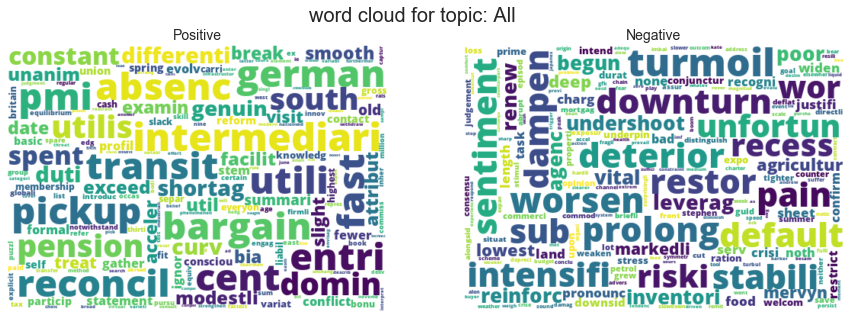

In [296]:
create_dictionary_visualisation_raw(word_document_frequency_97_10_merged_raw,[50,0.55,0.55])

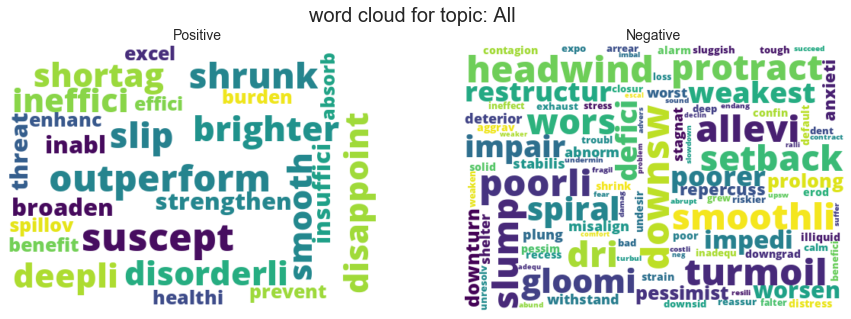

In [309]:
create_dictionary_visualisation_raw({'All':load_FS_dictionary().set_index('Entry').join(word_document_frequency_97_10_merged_raw['All'],how='inner')},[0,0.55,0.55])

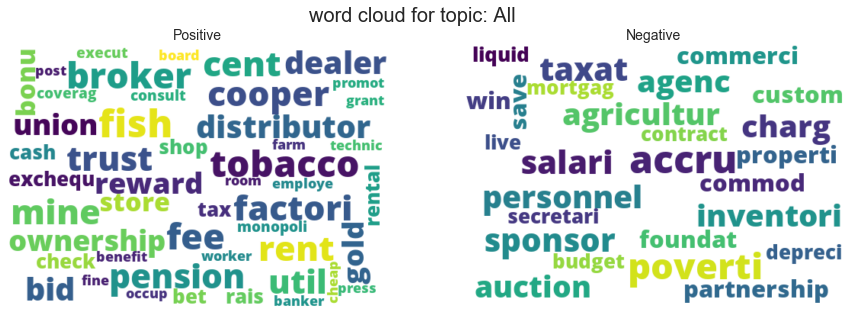

In [310]:
create_dictionary_visualisation_raw({'All':load_LM_dictionary().set_index('Entry').join(word_document_frequency_97_10_merged_raw['All'],how='inner')},[0,0.55,0.55])

In [313]:
load_LM_dictionary()

,Entry,sentiment
88,account,Neutral
96,accru,Positive
277,agenc,Neutral
302,agricultur,Neutral
409,aluminum,Neutral
...,...,...
11673,worker,Neutral
11679,workshop,Neutral
11700,worth,Positive
11757,yield,Neutral


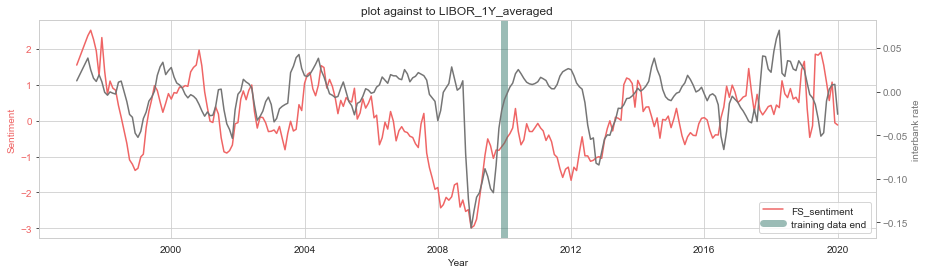

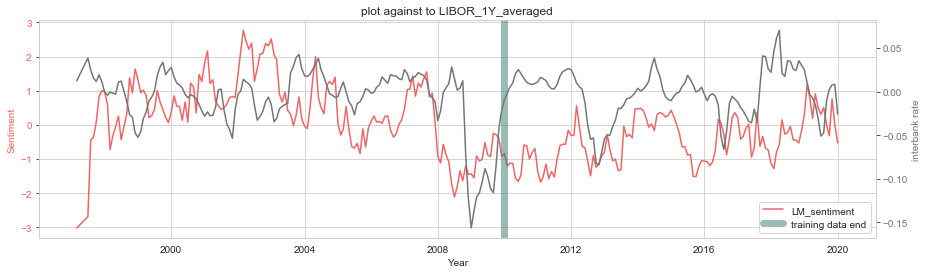

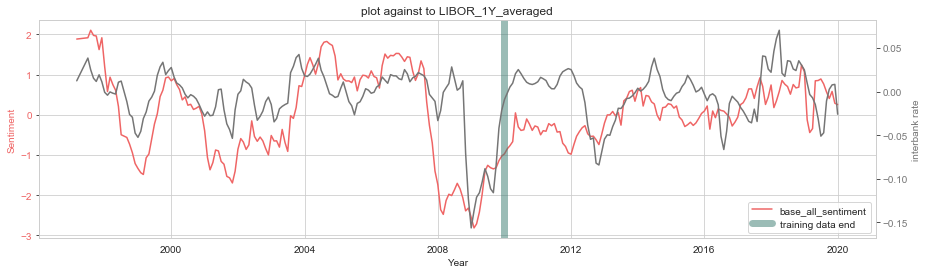

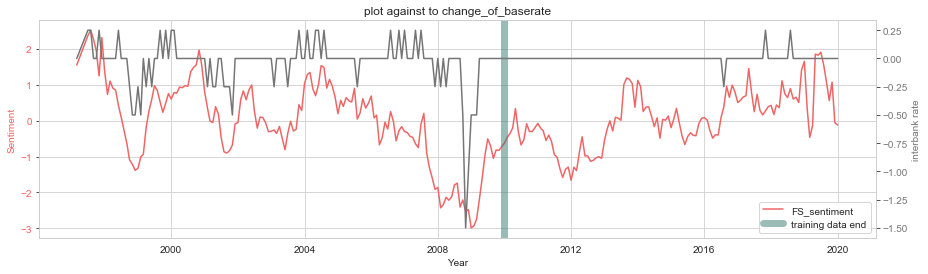

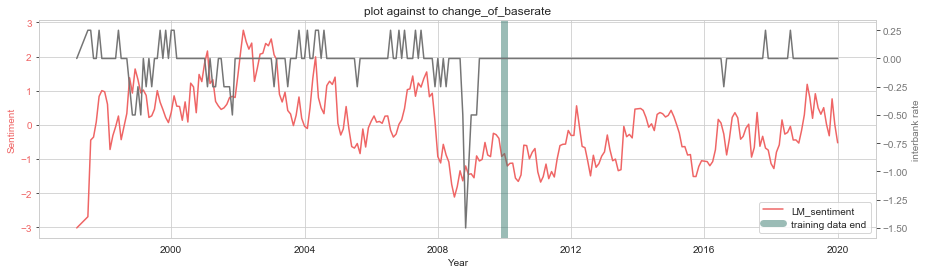

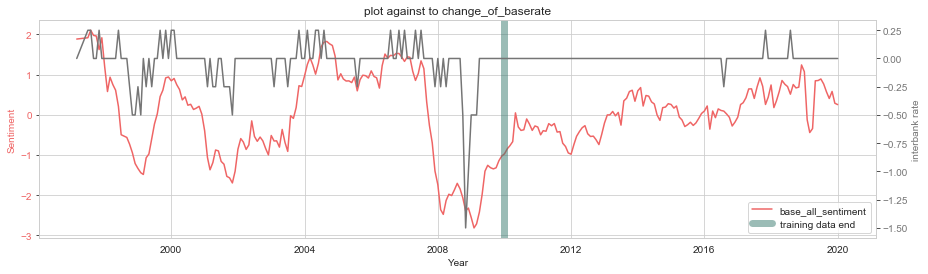

Correlation with Averaging
                   base_all_sentiment  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged            0.533206      0.081373      0.373889
LIBOR_1Y_change              0.350557      0.027612      0.278991
LIBOR_6M_change              0.403495      0.044452      0.318067
LIBOR_3M_change              0.402048      0.052402      0.307502
LIBOR_1M_change              0.392228      0.080364      0.324159
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.275588
base_all_sentiment         0.275588            1.000000


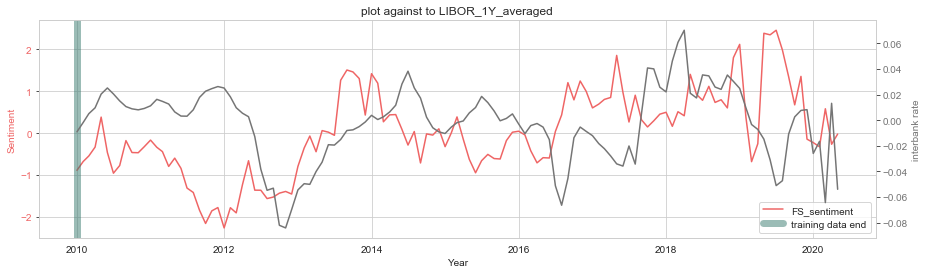

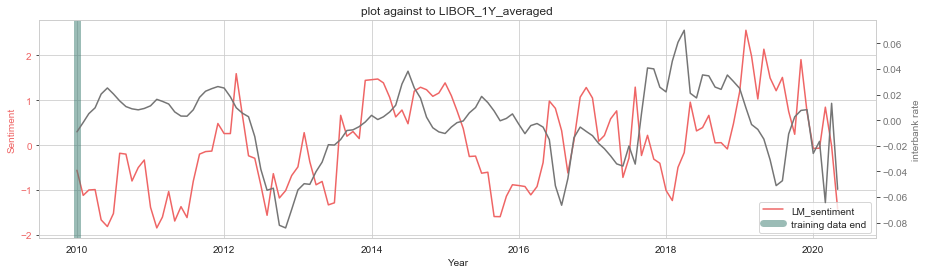

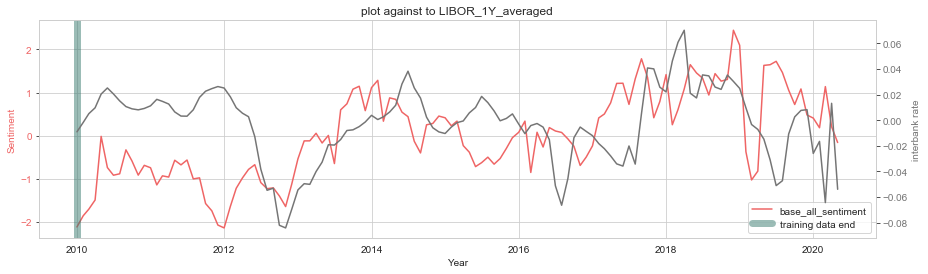

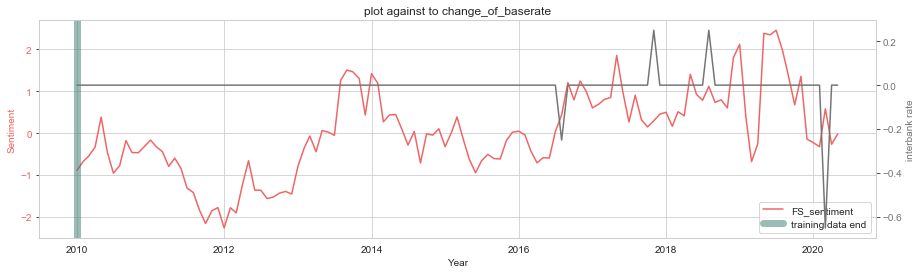

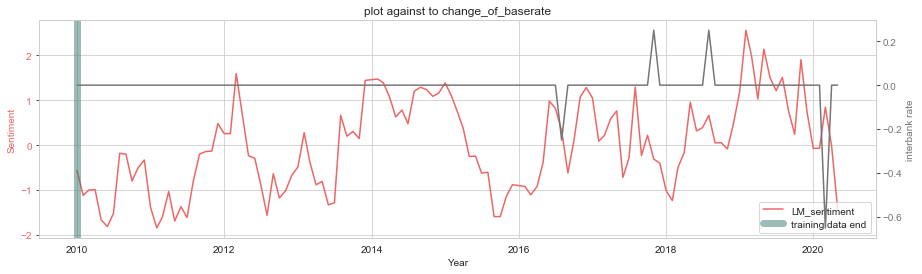

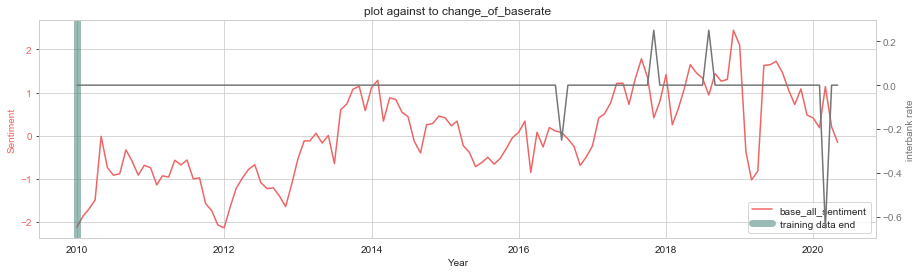

Correlation with Averaging
                   base_all_sentiment  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged            0.085749      0.007271     -0.020338
LIBOR_1Y_change              0.050434     -0.069333     -0.010188
LIBOR_6M_change              0.089219     -0.059231      0.018004
LIBOR_3M_change              0.087933     -0.027328      0.009427
LIBOR_1M_change              0.020941     -0.009074      0.007210
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.275588
base_all_sentiment         0.275588            1.000000


,label_2,base_all_sentiment,FS_sentiment,LM_sentiment,LIBOR_1Y_averaged,baserate,change_of_baserate,LIBOR_1Y_change,LIBOR_6M_change,LIBOR_3M_change,LIBOR_1M_change
label_2,1.000000,0.371570,0.174413,-0.007024,0.446716,0.002390,0.234132,0.266721,0.324358,0.354624,0.379004
base_all_sentiment,0.371570,1.000000,0.841575,0.435767,0.085749,0.140880,-0.047974,0.050434,0.089219,0.087933,0.020941
FS_sentiment,0.174413,0.841575,1.000000,0.449420,-0.020338,0.092285,-0.015378,-0.010188,0.018004,0.009427,0.007210
LM_sentiment,-0.007024,0.435767,0.449420,1.000000,0.007271,0.225608,-0.062182,-0.069333,-0.059231,-0.027328,-0.009074
LIBOR_1Y_averaged,0.446716,0.085749,-0.020338,0.007271,1.000000,0.078700,0.307597,0.734546,0.741082,0.633578,0.448249
baserate,0.002390,0.140880,0.092285,0.225608,0.078700,1.000000,-0.183919,-0.099160,-0.060689,-0.039948,0.007577
change_of_baserate,0.234132,-0.047974,-0.015378,-0.062182,0.307597,-0.183919,1.000000,0.332817,0.395768,0.471348,0.723020
LIBOR_1Y_change,0.266721,0.050434,-0.010188,-0.069333,0.734546,-0.099160,0.332817,1.000000,0.959507,0.832567,0.430542
LIBOR_6M_change,0.324358,0.089219,0.018004,-0.059231,0.741082,-0.060689,0.395768,0.959507,1.000000,0.928363,0.570795
LIBOR_3M_change,0.354624,0.087933,0.009427,-0.027328,0.633578,-0.039948,0.471348,0.832567,0.928363,1.000000,0.728806


In [517]:
#sentiment_97_15_merged_prob_raw = result_dictionary_sentiment_prob_raw(model2,interested_topics,dataset.loc[:,['title','all_string','label_2','Type']])
end_date, start_date='2009-12-31','1997-08-01'
result,result2 = rolling_averaging_ewm(sentiment_97_15_merged_prob_raw,N=3)
visualise_prob_model_raw(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
result,result2 = rolling_averaging_ewm(sentiment_97_15_merged_prob_raw,start=end_date,end ='2020-06-28',N=3)
visualise_prob_model_raw(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

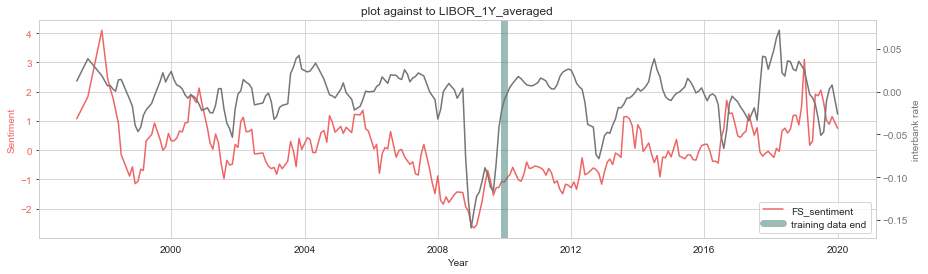

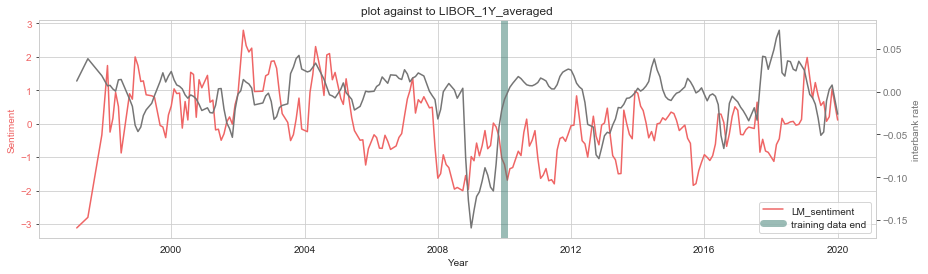

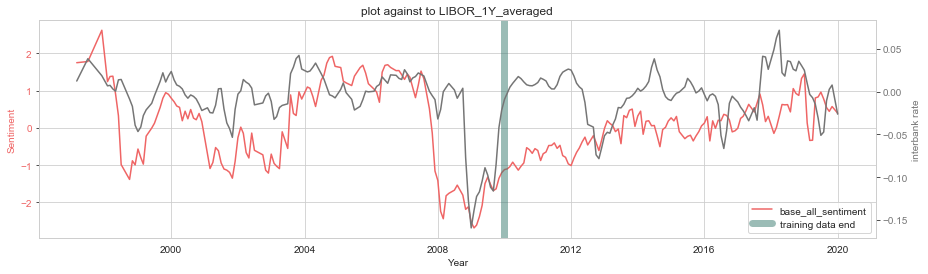

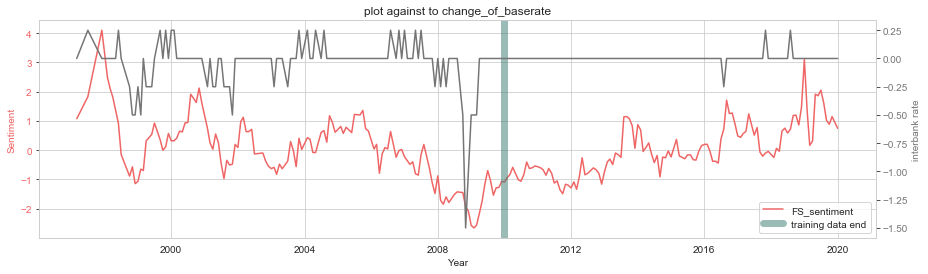

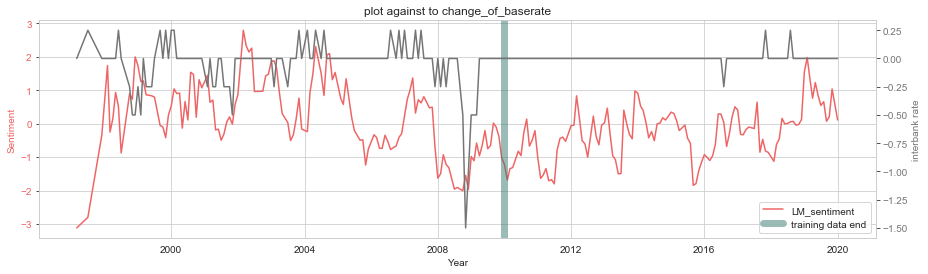

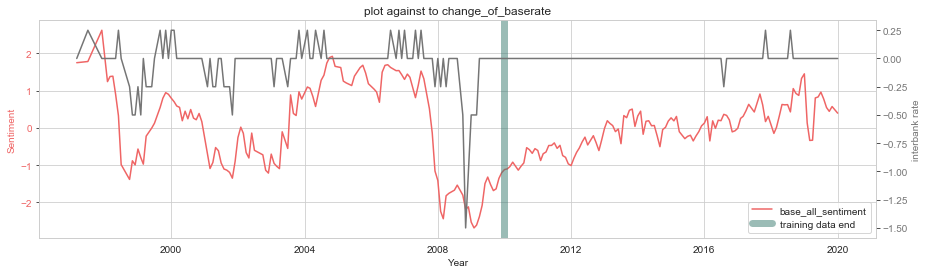

Correlation with Averaging
                   base_all_sentiment  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged            0.504327      0.069856      0.326728
LIBOR_1Y_change              0.345318     -0.000908      0.221014
LIBOR_6M_change              0.380661      0.009559      0.249193
LIBOR_3M_change              0.372922      0.011327      0.229618
LIBOR_1M_change              0.360755      0.057875      0.243643
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.251272
base_all_sentiment         0.251272            1.000000


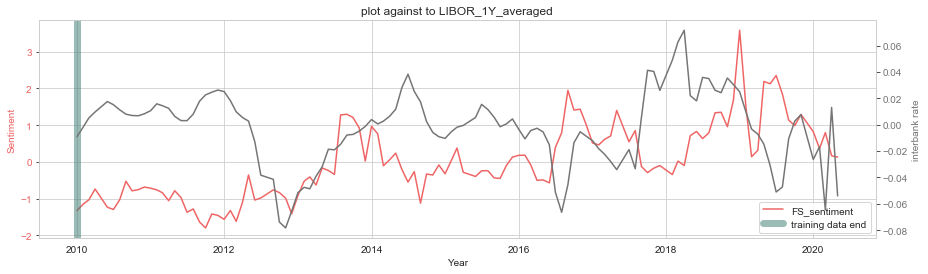

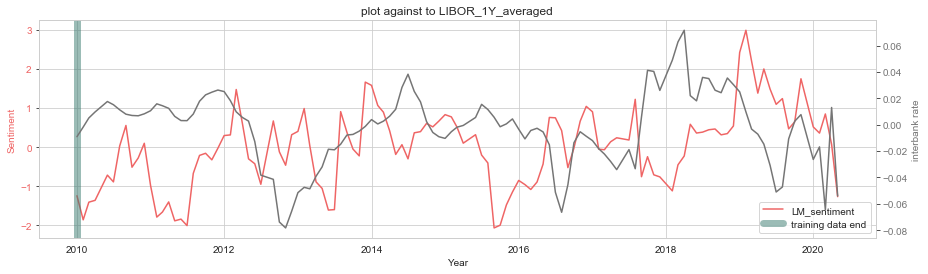

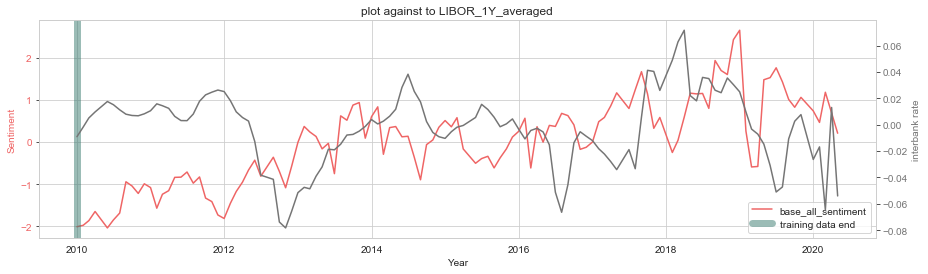

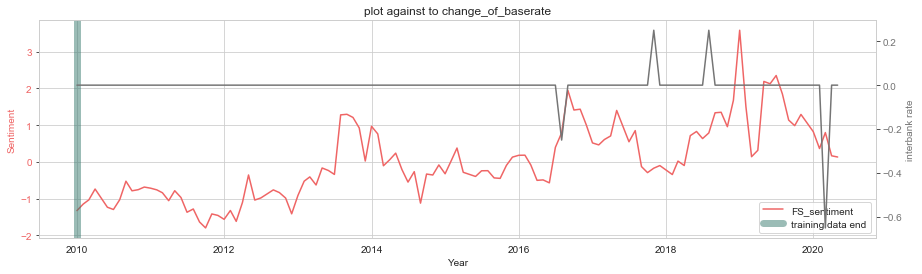

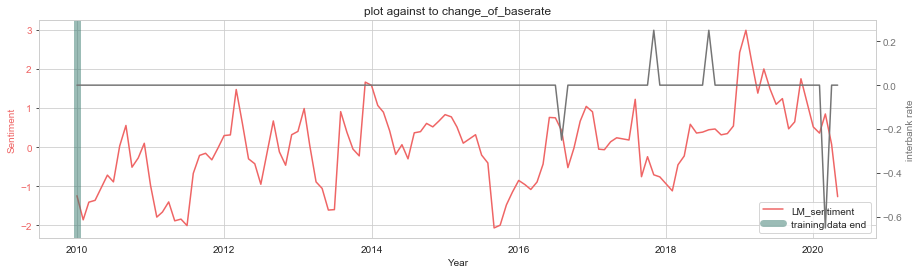

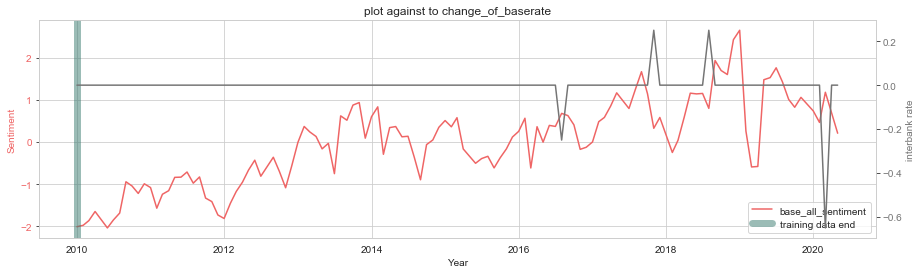

Correlation with Averaging
                   base_all_sentiment  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged           -0.097156     -0.109474     -0.133265
LIBOR_1Y_change             -0.060090     -0.151592     -0.109960
LIBOR_6M_change             -0.029369     -0.139157     -0.098603
LIBOR_3M_change             -0.012100     -0.103898     -0.107055
LIBOR_1M_change             -0.065082     -0.068668     -0.102182
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.251272
base_all_sentiment         0.251272            1.000000


,label_2,base_all_sentiment,FS_sentiment,LM_sentiment,LIBOR_1Y_averaged,baserate,change_of_baserate,LIBOR_1Y_change,LIBOR_6M_change,LIBOR_3M_change,LIBOR_1M_change
label_2,1.000000,0.238679,0.054135,0.007214,0.509831,0.046096,0.240500,0.290986,0.355278,0.372613,0.383230
base_all_sentiment,0.238679,1.000000,0.837278,0.471433,-0.097156,0.157158,-0.077083,-0.060090,-0.029369,-0.012100,-0.065082
FS_sentiment,0.054135,0.837278,1.000000,0.527111,-0.133265,0.210643,-0.066243,-0.109960,-0.098603,-0.107055,-0.102182
LM_sentiment,0.007214,0.471433,0.527111,1.000000,-0.109474,0.315848,-0.085064,-0.151592,-0.139157,-0.103898,-0.068668
LIBOR_1Y_averaged,0.509831,-0.097156,-0.133265,-0.109474,1.000000,0.059282,0.325762,0.730391,0.738931,0.632566,0.459393
baserate,0.046096,0.157158,0.210643,0.315848,0.059282,1.000000,-0.188792,-0.117226,-0.075780,-0.049939,0.007863
change_of_baserate,0.240500,-0.077083,-0.066243,-0.085064,0.325762,-0.188792,1.000000,0.338993,0.405169,0.478780,0.724638
LIBOR_1Y_change,0.290986,-0.060090,-0.109960,-0.151592,0.730391,-0.117226,0.338993,1.000000,0.958575,0.828715,0.427717
LIBOR_6M_change,0.355278,-0.029369,-0.098603,-0.139157,0.738931,-0.075780,0.405169,0.958575,1.000000,0.927369,0.571843
LIBOR_3M_change,0.372613,-0.012100,-0.107055,-0.103898,0.632566,-0.049939,0.478780,0.828715,0.927369,1.000000,0.730452


In [518]:
#sentiment_97_15_speech_prob_raw = result_dictionary_sentiment_prob_raw(model2,interested_topics,dataset.loc[dataset.loc[:,'Type']=='Speech',['title','all_string','label_2','Type']])
result,result2 = rolling_averaging_ewm(sentiment_97_15_speech_prob_raw,N=3)
visualise_prob_model_raw(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
result,result2 = rolling_averaging_ewm(sentiment_97_15_speech_prob_raw,start=end_date,end ='2020-06-28',N=3)
visualise_prob_model_raw(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

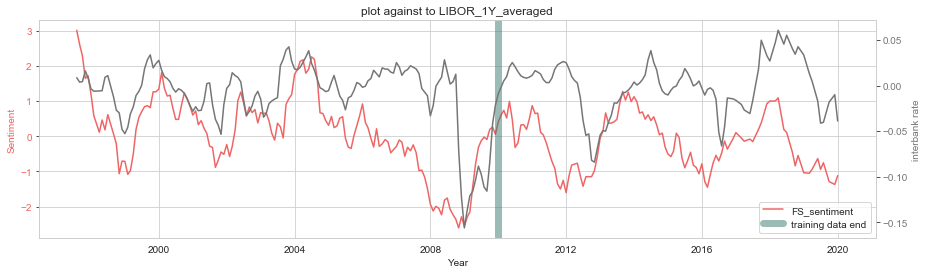

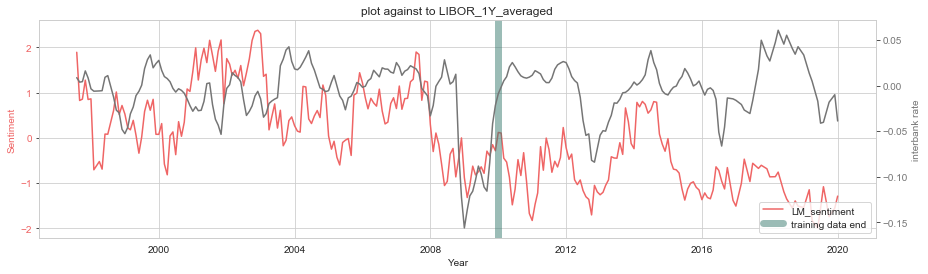

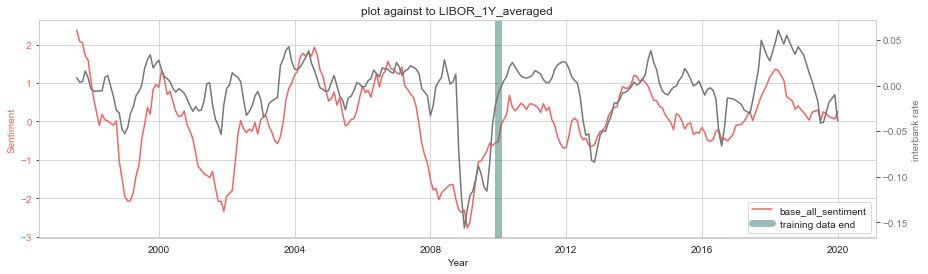

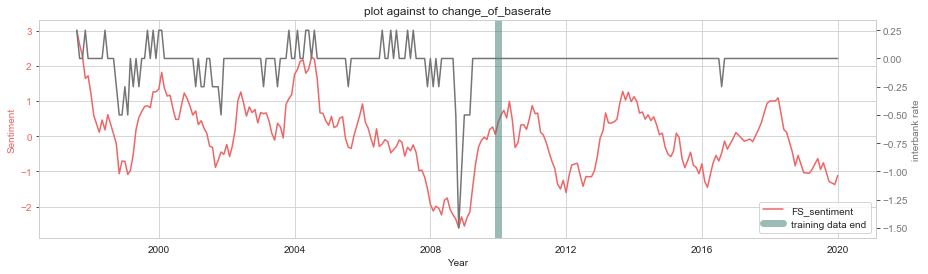

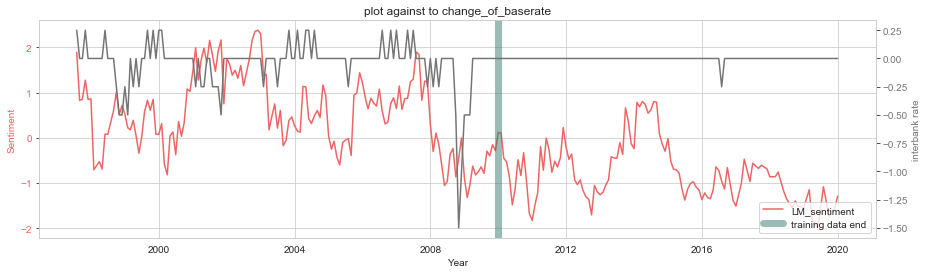

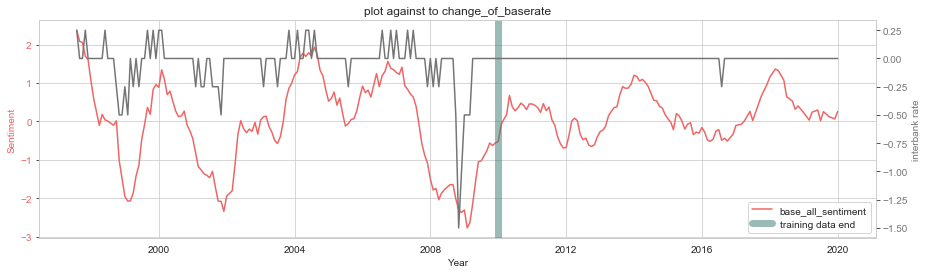

Correlation with Averaging
                   base_all_sentiment  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged            0.571985      0.109747      0.354955
LIBOR_1Y_change              0.386668      0.083997      0.327213
LIBOR_6M_change              0.455814      0.083988      0.355848
LIBOR_3M_change              0.472550      0.084253      0.356657
LIBOR_1M_change              0.494955      0.100003      0.383381
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.354376
base_all_sentiment         0.354376            1.000000


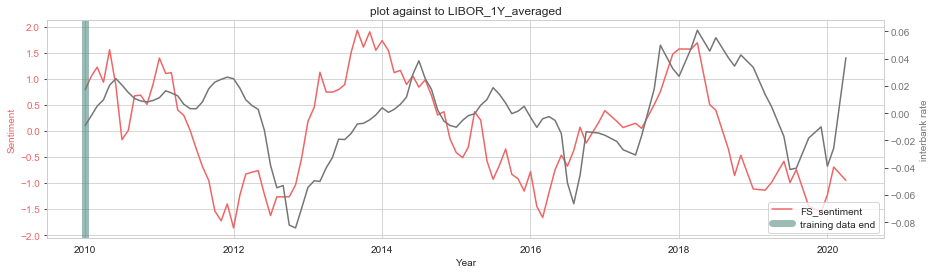

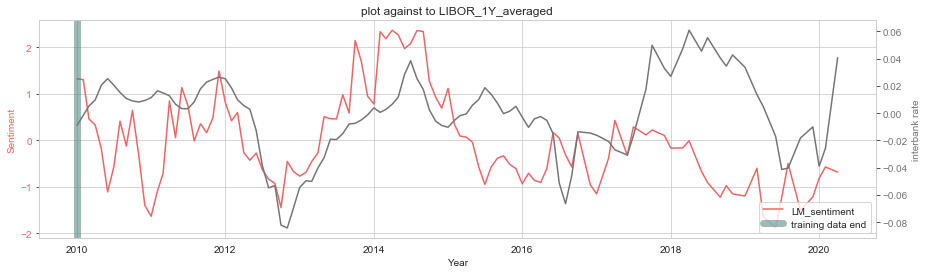

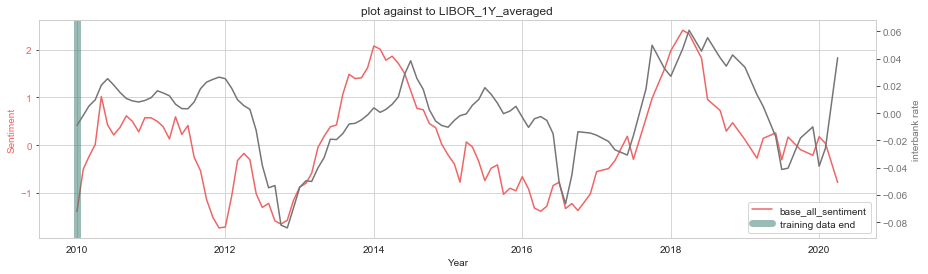

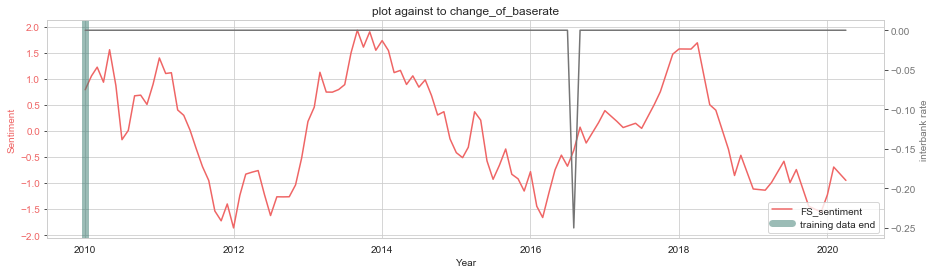

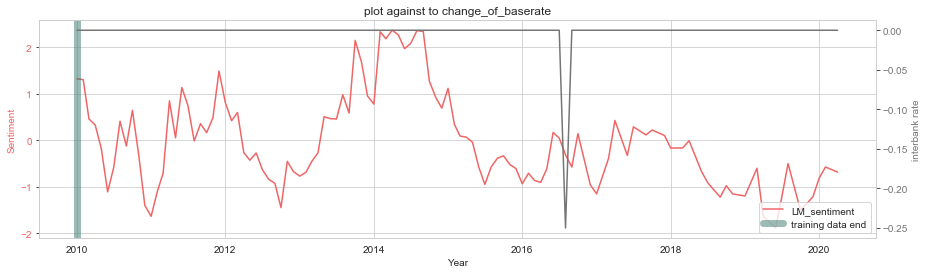

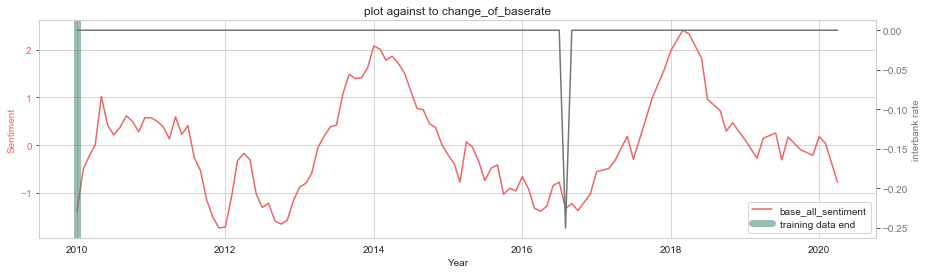

Correlation with Averaging
                   base_all_sentiment  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged            0.483668      0.184029      0.216476
LIBOR_1Y_change              0.343873      0.173923      0.275266
LIBOR_6M_change              0.402586      0.150946      0.302134
LIBOR_3M_change              0.375734      0.117473      0.276573
LIBOR_1M_change              0.273741      0.106245      0.209938
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.354376
base_all_sentiment         0.354376            1.000000


,label_2,base_all_sentiment,FS_sentiment,LM_sentiment,LIBOR_1Y_averaged,baserate,change_of_baserate,LIBOR_1Y_change,LIBOR_6M_change,LIBOR_3M_change,LIBOR_1M_change
label_2,1.000000,0.519540,0.238087,-0.024521,0.526944,0.194384,0.270090,0.353448,0.420364,0.476350,0.427060
base_all_sentiment,0.519540,1.000000,0.758925,0.376409,0.483668,0.118985,0.127286,0.343873,0.402586,0.375734,0.273741
FS_sentiment,0.238087,0.758925,1.000000,0.444342,0.216476,-0.240304,0.035594,0.275266,0.302134,0.276573,0.209938
LM_sentiment,-0.024521,0.376409,0.444342,1.000000,0.184029,-0.211777,0.029987,0.173923,0.150946,0.117473,0.106245
LIBOR_1Y_averaged,0.526944,0.483668,0.216476,0.184029,1.000000,0.021290,0.216728,0.760498,0.765988,0.702746,0.358052
baserate,0.194384,0.118985,-0.240304,-0.211777,0.021290,1.000000,0.002530,-0.273199,-0.194337,-0.156174,0.146215
change_of_baserate,0.270090,0.127286,0.035594,0.029987,0.216728,0.002530,1.000000,0.203607,0.238832,0.339518,0.574362
LIBOR_1Y_change,0.353448,0.343873,0.275266,0.173923,0.760498,-0.273199,0.203607,1.000000,0.956939,0.871651,0.243757
LIBOR_6M_change,0.420364,0.402586,0.302134,0.150946,0.765988,-0.194337,0.238832,0.956939,1.000000,0.951232,0.372901
LIBOR_3M_change,0.476350,0.375734,0.276573,0.117473,0.702746,-0.156174,0.339518,0.871651,0.951232,1.000000,0.450409


In [519]:
#sentiment_97_15_minutes_prob_raw = result_dictionary_sentiment_prob_raw(model2,interested_topics,dataset.loc[dataset.loc[:,'Type']=='Minutes',['title','all_string','label_2','Type']])
result,result2 = rolling_averaging_ewm(sentiment_97_15_minutes_prob_raw,N=3)
visualise_prob_model_raw(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
result,result2 = rolling_averaging_ewm(sentiment_97_15_minutes_prob_raw,start=end_date,end ='2020-06-28',N=3)
visualise_prob_model_raw(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

### Step 2.3: implement training model with LDA

In [103]:
end_date, start_date='2015-12-31','1997-08-01'
interested_topics = [
    'Financial markets',
    'The immediate policy decision',
    'Growth and inflation projections',
    'Money, credit, demand and output',
    'Supply, costs and prices',
    'The international economy',
]
topics =['Financial markets','The immediate policy decision','Growth and inflation projections',
         'Money, credit, demand and output','Supply, costs and prices','The international economy','All']


training_data = merged_timeseries_labelled.loc[end_date:start_date,:]
word_document_frequency_97_15_merged,dictionary_model_97_15_merged = training_dictionary_sentiment(training_data,para_set=[[50,0.55,0.55],[30,0.55,0.55]],doc_name='9715_speech_minutes_second')
dictionary_model_97_15_merged = remove_duplicates(dictionary_model_97_15_merged)
model = create_probability_model(word_document_frequency_97_15_merged,dictionary_model_97_15_merged)

Positive count:287   Negative count:396   Neutral count:145
calculate word frequency
create dictionary for topic: Financial markets
create dictionary for topic: The immediate policy decision
create dictionary for topic: Growth and inflation projections
create dictionary for topic: Money, credit, demand and output
create dictionary for topic: Supply, costs and prices
create dictionary for topic: The international economy
create dictionary for topic: All
Positive count:154   Negative count:244   Neutral count:430
calculate word frequency
create dictionary for topic: Financial markets
create dictionary for topic: The immediate policy decision
create dictionary for topic: Growth and inflation projections
create dictionary for topic: Money, credit, demand and output
create dictionary for topic: Supply, costs and prices
create dictionary for topic: The international economy
create dictionary for topic: All


In [322]:
end_date2, start_date2='2009-12-31','1997-08-01'
interested_topics = [
    'Financial markets',
    'The immediate policy decision',
    'Growth and inflation projections',
    'Money, credit, demand and output',
    'Supply, costs and prices',
    'The international economy',
]
topics =['Financial markets','The immediate policy decision','Growth and inflation projections',
         'Money, credit, demand and output','Supply, costs and prices','The international economy','All']


#training_data2 = merged_timeseries_labelled.loc[end_date2:start_date2,:]
#word_document_frequency_97_10_merged,dictionary_model_97_10_merged = training_dictionary_sentiment(training_data2,para_set=[[50,0.55,0.55],[30,0.55,0.55]],doc_name='9710_speech_minutes_second')
#dictionary_model_97_10_merged = remove_duplicates(dictionary_model_97_10_merged)
model2 = create_probability_model(word_document_frequency_97_10_merged,dictionary_model_97_10_merged)

In [431]:
load_LM_dictionary()

,Entry,sentiment
88,account,Neutral
96,accru,Positive
277,agenc,Neutral
302,agricultur,Neutral
409,aluminum,Neutral
...,...,...
11673,worker,Neutral
11679,workshop,Neutral
11700,worth,Positive
11757,yield,Neutral


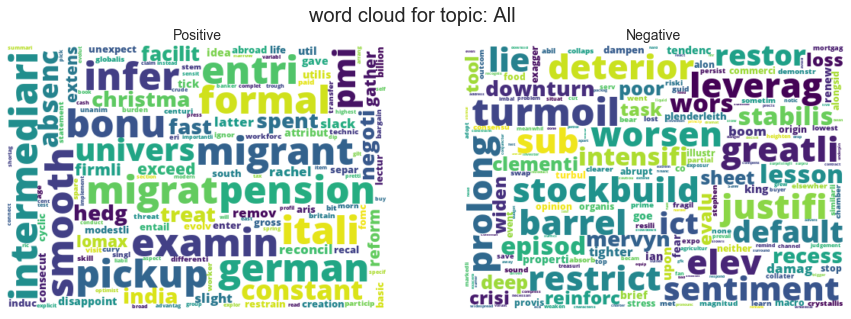

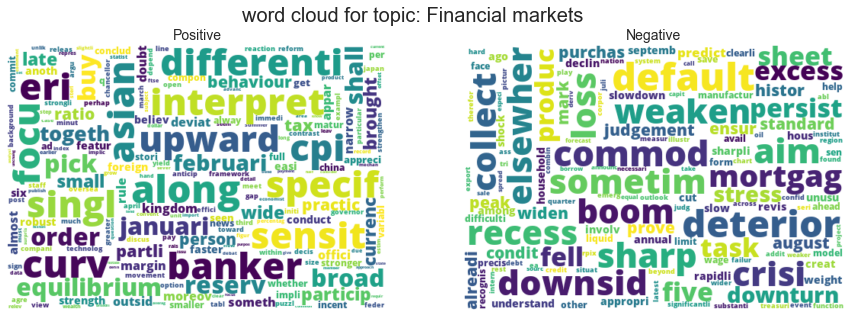

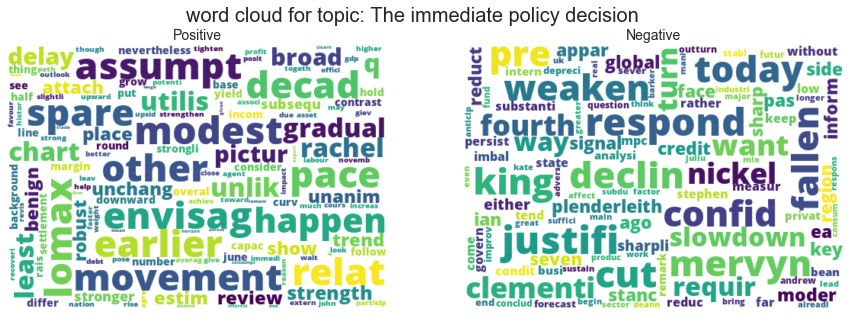

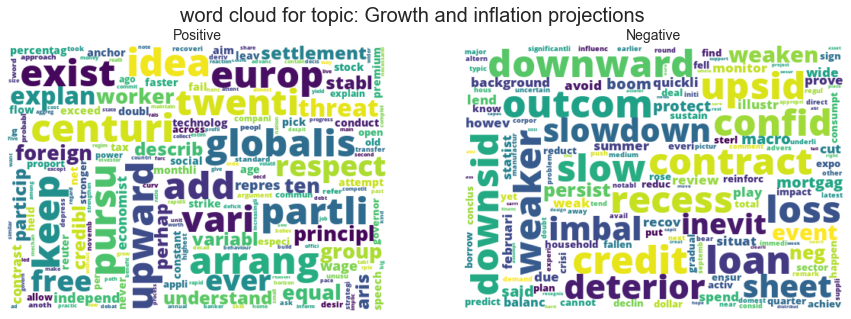

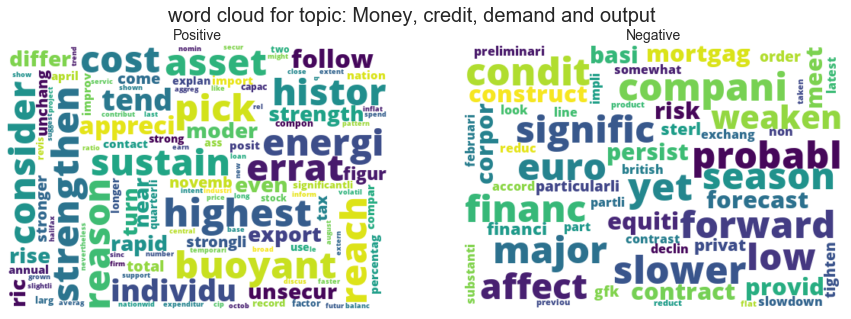

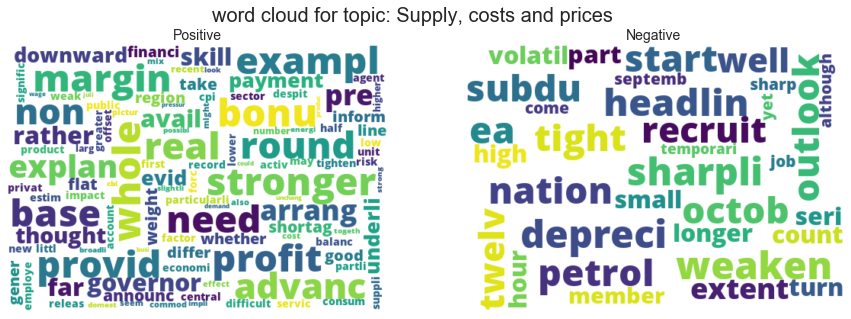

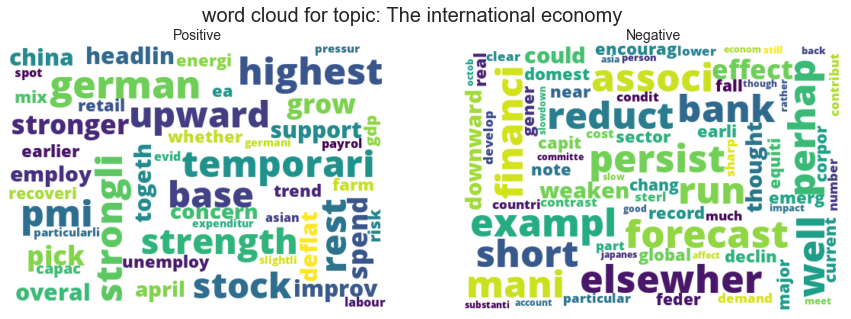

In [421]:
create_dictionary_visualisation(word_document_frequency_97_10_merged,[30,0.55,0.55])

#### 2.2.1:  trained on 1997-2015

1997-03-01    0.012387
1997-07-01    0.056904
1997-08-01    0.008657
1997-09-01    0.000265
1997-10-01    0.005013
                ...   
2020-02-01    0.006248
2020-03-01   -0.179832
2020-04-01    0.200617
2020-05-01   -0.216137
2020-06-01         NaN
Name: LIBOR_1Y_change, Length: 276, dtype: float64
1997-03-01    0.012387
1997-07-01    0.042065
1997-08-01    0.022974
1997-09-01    0.010863
1997-10-01    0.007843
                ...   
2020-02-01   -0.020113
2020-03-01   -0.099972
2020-04-01    0.050322
2020-05-01   -0.082908
2020-06-01   -0.082908
Name: LIBOR_1Y_change, Length: 276, dtype: float64


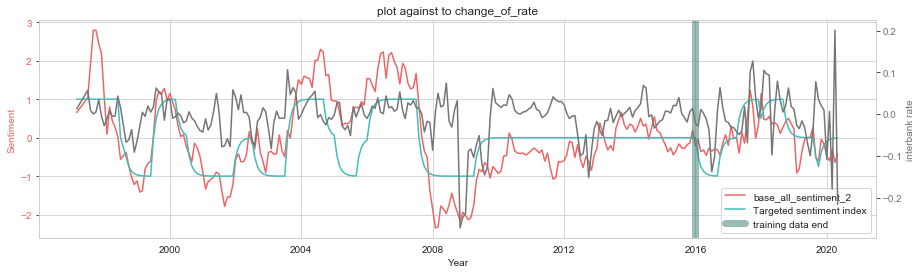

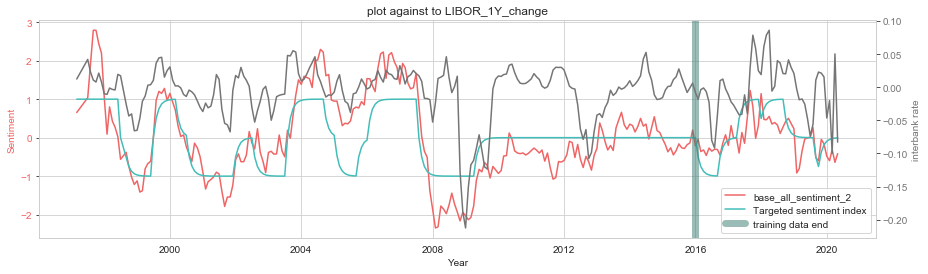

KeyError: 'Topical_mean_base'

In [491]:
end_date, start_date='2015-12-31','1997-08-01'
#sentiment_97_15_merged_prob = result_dictionary_sentiment_prob(model,interested_topics,merged_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_15_merged_prob,N=2)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment_2','Topical_mean_base_2','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

calculating all
calculating topic: Financial markets
calculating topic: The immediate policy decision
calculating topic: Growth and inflation projections
calculating topic: Money, credit, demand and output
calculating topic: Supply, costs and prices
calculating topic: The international economy
calculating dictionary sentiment


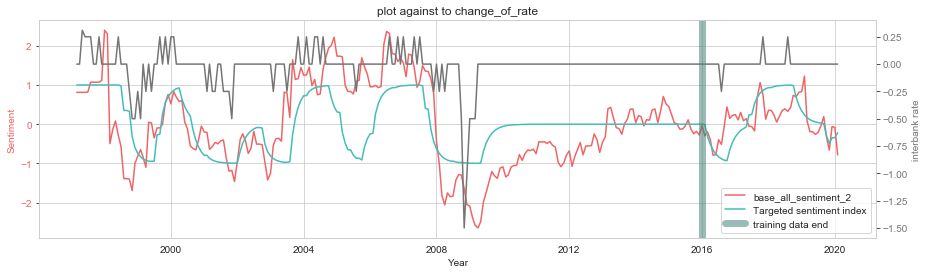

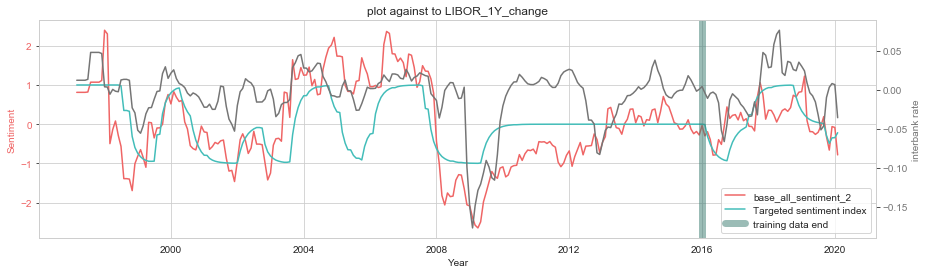

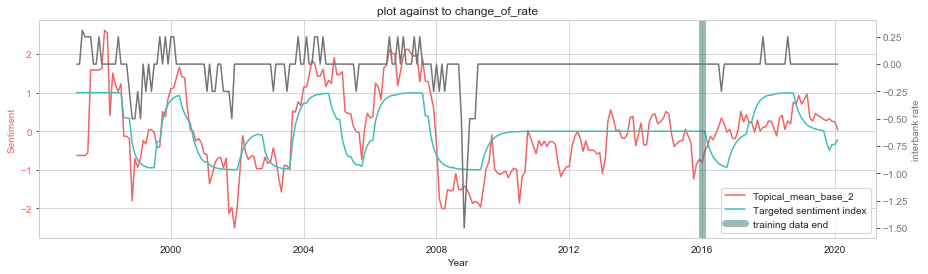

Correlation with Averaging
                 base_all_sentiment_2  Topical_mean_base_2  FS_sentiment
label_2                      0.603019             0.709848      0.270305
LIBOR_1Y_change              0.513539             0.470417      0.289794
Interest_rate                0.253288             0.264407      0.259313
change_of_rate               0.399895             0.384217      0.229047
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.261025
base_all_sentiment         0.261025            1.000000


,label,label_2,base_all_sentiment,base_Financial markets_sentiment,base_The immediate policy decision_sentiment,base_Growth and inflation projections_sentiment,"base_Money, credit, demand and output_sentiment","base_Supply, costs and prices_sentiment",base_The international economy_sentiment,Topical_mean_base,FS_sentiment,LM_sentiment,LIBOR_1Y_change,Interest_rate,change_of_rate,base_all_sentiment_2,Topical_mean_base_2
label,1.000000,0.269373,0.328190,0.217856,0.141293,0.267763,0.046364,0.036588,0.106817,0.206193,0.048927,-0.037282,0.316833,-0.149971,0.229871,0.328190,0.206193
label_2,0.269373,1.000000,0.603019,0.693837,0.629590,0.635609,0.164519,0.111026,0.090915,0.709848,0.270305,-0.008170,0.559239,0.098248,0.474128,0.603019,0.709848
base_all_sentiment,0.328190,0.603019,1.000000,0.759815,0.588615,0.767035,0.179465,0.341159,0.286458,0.824561,0.549166,0.123715,0.513539,0.253288,0.399895,1.000000,0.824561
base_Financial markets_sentiment,0.217856,0.693837,0.759815,1.000000,0.437571,0.639961,0.146095,0.310513,0.179370,0.798251,0.542725,0.129179,0.469622,0.283137,0.432913,0.759815,0.798251
base_The immediate policy decision_sentiment,0.141293,0.629590,0.588615,0.437571,1.000000,0.627889,0.116619,0.183635,0.172428,0.781311,0.255256,0.163257,0.442239,0.189391,0.319591,0.588615,0.781311
base_Growth and inflation projections_sentiment,0.267763,0.635609,0.767035,0.639961,0.627889,1.000000,-0.019124,0.174454,0.271063,0.834918,0.431179,0.220618,0.409030,-0.029678,0.383854,0.767035,0.834918
"base_Money, credit, demand and output_sentiment",0.046364,0.164519,0.179465,0.146095,0.116619,-0.019124,1.000000,0.107152,0.105062,0.181397,0.304445,0.399509,0.198382,0.332068,-0.005738,0.179465,0.181397
"base_Supply, costs and prices_sentiment",0.036588,0.111026,0.341159,0.310513,0.183635,0.174454,0.107152,1.000000,0.182217,0.430616,0.259110,0.111563,0.157309,0.447339,0.022762,0.341159,0.430616
base_The international economy_sentiment,0.106817,0.090915,0.286458,0.179370,0.172428,0.271063,0.105062,0.182217,1.000000,0.271134,0.292885,0.234445,0.020077,0.080096,0.084746,0.286458,0.271134
Topical_mean_base,0.206193,0.709848,0.824561,0.798251,0.781311,0.834918,0.181397,0.430616,0.271134,1.000000,0.510200,0.262403,0.470417,0.264407,0.384217,0.824561,1.000000


In [14]:
end_date, start_date='2015-12-31','1997-08-01'
sentiment_97_15_speech_prob = result_dictionary_sentiment_prob(model,interested_topics,speech_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_15_speech_prob)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment_2','Topical_mean_base_2','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

calculating all
calculating topic: Financial markets
calculating topic: The immediate policy decision
calculating topic: Growth and inflation projections
calculating topic: Money, credit, demand and output
calculating topic: Supply, costs and prices
calculating topic: The international economy
calculating dictionary sentiment


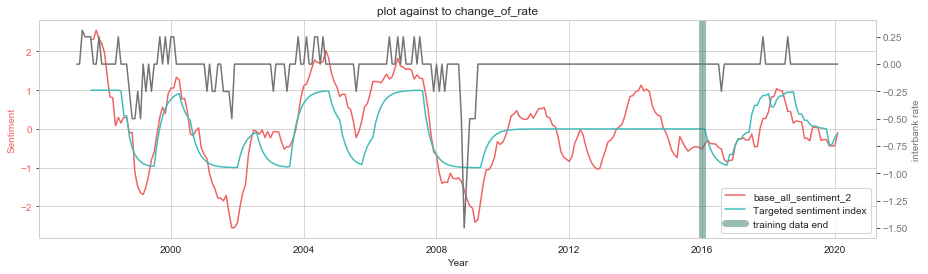

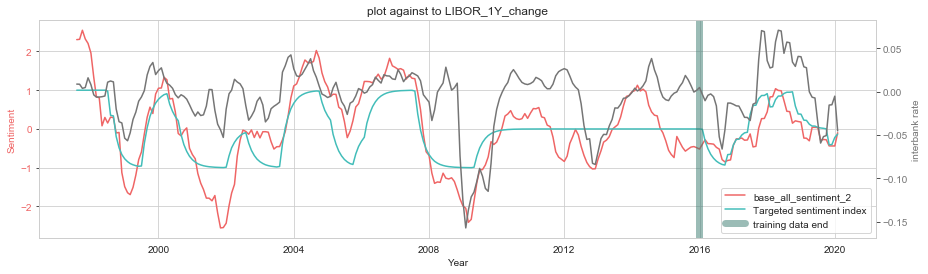

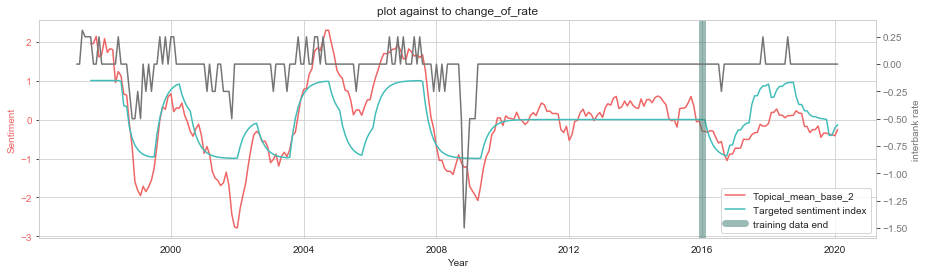

Correlation with Averaging
                 base_all_sentiment_2  Topical_mean_base_2  FS_sentiment
label_2                      0.792457             0.818380      0.469539
LIBOR_1Y_change              0.561908             0.444900      0.353912
Interest_rate                0.194781             0.155573      0.245016
change_of_rate               0.465796             0.435961      0.408340
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.385039
base_all_sentiment         0.385039            1.000000


,label,label_2,base_all_sentiment,base_Financial markets_sentiment,base_The immediate policy decision_sentiment,base_Growth and inflation projections_sentiment,"base_Money, credit, demand and output_sentiment","base_Supply, costs and prices_sentiment",base_The international economy_sentiment,Topical_mean_base,FS_sentiment,LM_sentiment,LIBOR_1Y_change,Interest_rate,change_of_rate,base_all_sentiment_2,Topical_mean_base_2
label,1.000000,0.280419,0.447433,0.390348,0.201417,0.227231,0.230170,0.213551,0.343669,0.293289,0.399016,0.066243,0.329342,-0.137836,0.242726,0.447433,0.293289
label_2,0.280419,1.000000,0.792457,0.737424,0.781809,0.612613,0.688563,0.755445,0.734959,0.818380,0.469539,-0.074664,0.534604,0.053522,0.473355,0.792457,0.818380
base_all_sentiment,0.447433,0.792457,1.000000,0.743781,0.867968,0.688720,0.754040,0.736964,0.775597,0.904163,0.678725,0.136291,0.561908,0.194781,0.465796,1.000000,0.904163
base_Financial markets_sentiment,0.390348,0.737424,0.743781,1.000000,0.732843,0.501089,0.591031,0.812176,0.736255,0.815235,0.362175,-0.252088,0.407411,-0.097794,0.399978,0.743781,0.815235
base_The immediate policy decision_sentiment,0.201417,0.781809,0.867968,0.732843,1.000000,0.656085,0.738165,0.810068,0.722278,0.935721,0.501552,0.060662,0.448187,0.169517,0.426500,0.867968,0.935721
base_Growth and inflation projections_sentiment,0.227231,0.612613,0.688720,0.501089,0.656085,1.000000,0.657973,0.559212,0.462351,0.723378,0.529837,0.174355,0.305521,0.154492,0.330165,0.688720,0.723378
"base_Money, credit, demand and output_sentiment",0.230170,0.688563,0.754040,0.591031,0.738165,0.657973,1.000000,0.596351,0.510724,0.770803,0.507080,0.253885,0.360386,0.414179,0.402095,0.754040,0.770803
"base_Supply, costs and prices_sentiment",0.213551,0.755445,0.736964,0.812176,0.810068,0.559212,0.596351,1.000000,0.666447,0.867504,0.370963,-0.114411,0.388882,0.039295,0.414039,0.736964,0.867504
base_The international economy_sentiment,0.343669,0.734959,0.775597,0.736255,0.722278,0.462351,0.510724,0.666447,1.000000,0.812749,0.269789,-0.179633,0.520167,-0.104216,0.384766,0.775597,0.812749
Topical_mean_base,0.293289,0.818380,0.904163,0.815235,0.935721,0.723378,0.770803,0.867504,0.812749,1.000000,0.503586,0.045356,0.444900,0.155573,0.435961,0.904163,1.000000


In [15]:
end_date, start_date='2015-12-31','1997-08-01'
sentiment_97_15_minutes_prob = result_dictionary_sentiment_prob(model,interested_topics,minutes_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_15_minutes_prob)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment_2','Topical_mean_base_2','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()


####  2.2.2: trained on 1997-2010

In [535]:
halflife = 3
end_date, start_date='2009-12-31','1997-08-01'

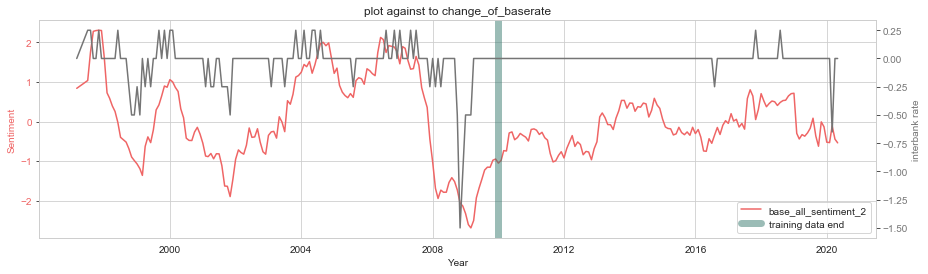

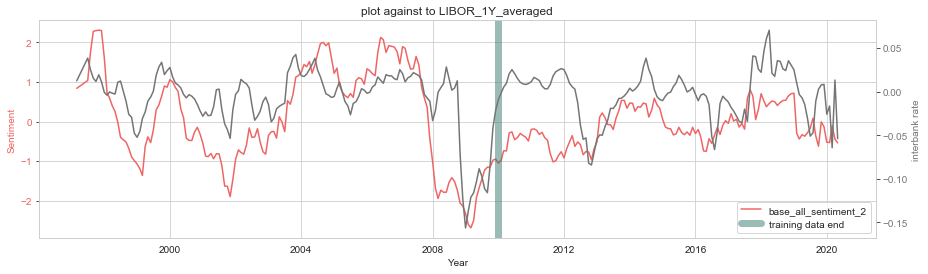

Correlation with Averaging
                   base_all_sentiment_2  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged              0.559535      0.139781      0.330336
LIBOR_1Y_change                0.350808      0.080084      0.225894
LIBOR_6M_change                0.389103      0.102331      0.251351
LIBOR_3M_change                0.360673      0.107679      0.222440
LIBOR_1M_change                0.343223      0.126441      0.204831
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.313221
base_all_sentiment         0.313221            1.000000


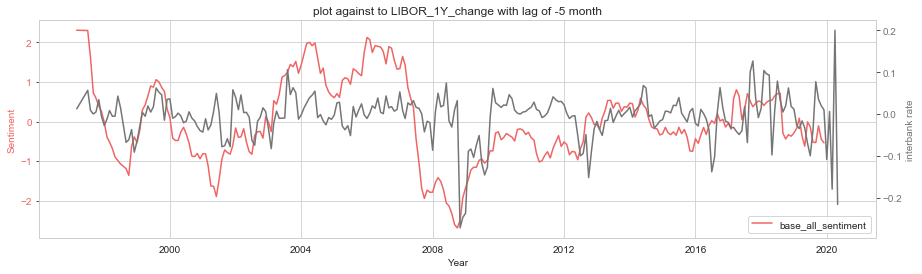

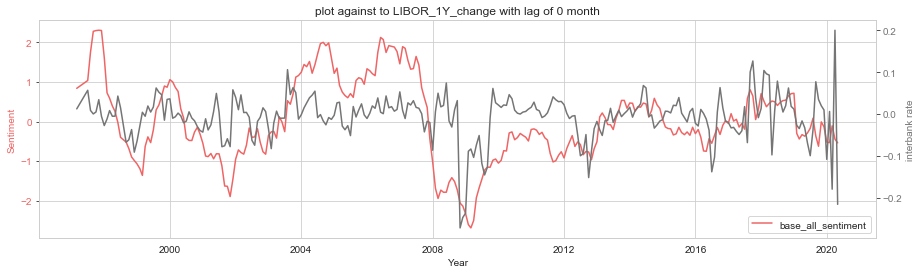

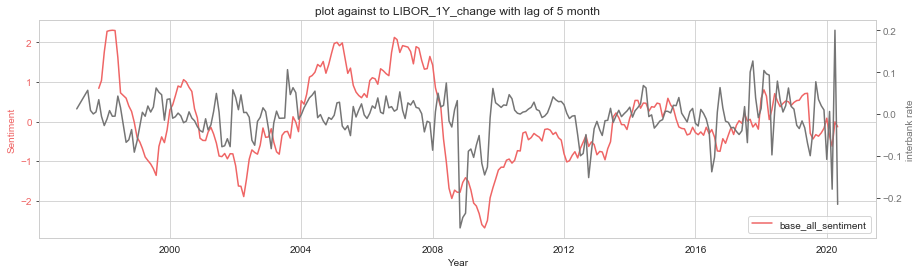

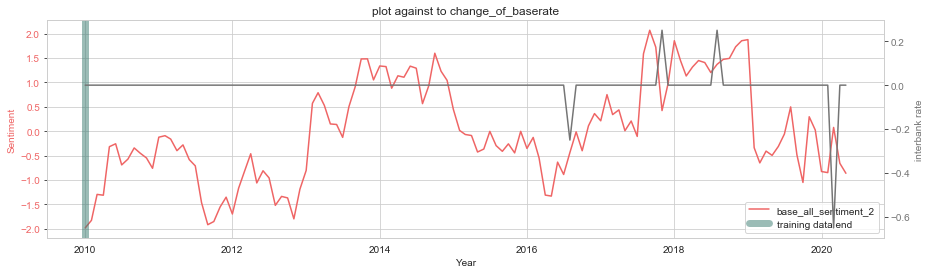

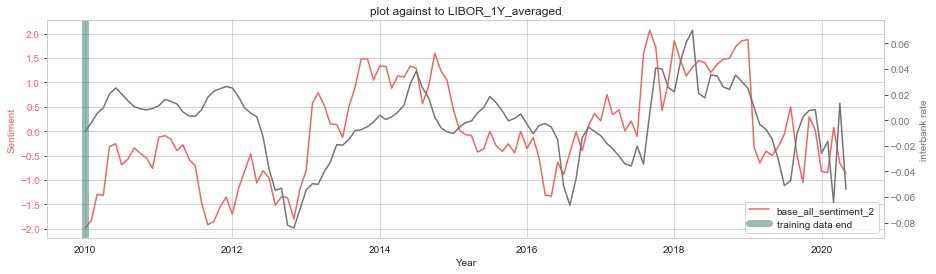

Correlation with Averaging
                   base_all_sentiment_2  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged              0.316291      0.265533     -0.056960
LIBOR_1Y_change                0.223091      0.103627     -0.034680
LIBOR_6M_change                0.259239      0.112077     -0.014836
LIBOR_3M_change                0.217769      0.102326     -0.031337
LIBOR_1M_change                0.157158      0.092183     -0.103169
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.313221
base_all_sentiment         0.313221            1.000000


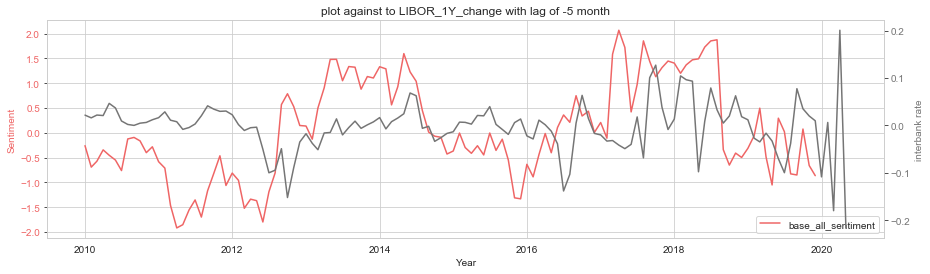

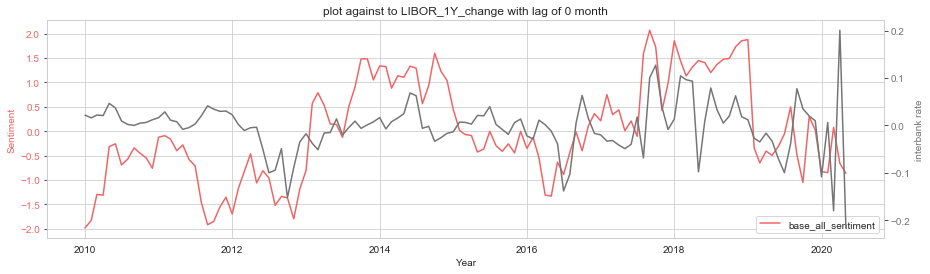

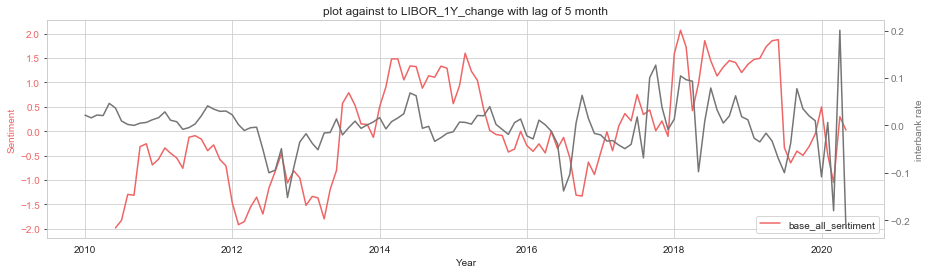

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
LIBOR_1Y_change,0.060716,0.137913,0.232779,0.235386,0.189184,0.223091,0.295933,0.212203,0.193276,0.164511,0.199895


In [536]:
#sentiment_97_10_merged_prob = result_dictionary_sentiment_prob(model2,interested_topics,merged_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob,end ='2020-06-28',N=halflife)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment_2','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
describe_lagged_information(result)

result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob,start=end_date,end ='2020-06-28',N=halflife)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment_2','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
describe_lagged_information(result)

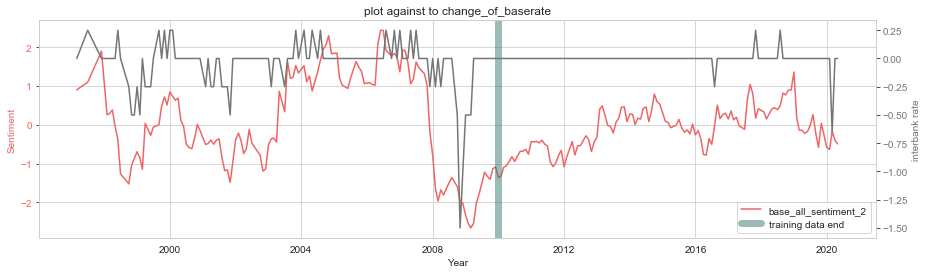

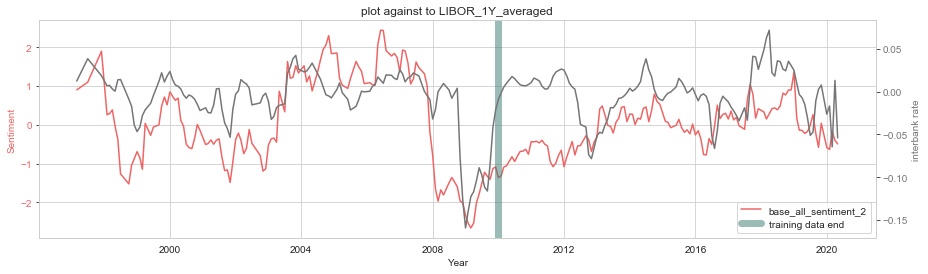

Correlation with Averaging
                   base_all_sentiment_2  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged              0.526894      0.124627      0.264528
LIBOR_1Y_change                0.345923      0.074814      0.166197
LIBOR_6M_change                0.369159      0.081687      0.176770
LIBOR_3M_change                0.335529      0.071542      0.141549
LIBOR_1M_change                0.325576      0.083134      0.117176
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.261222
base_all_sentiment         0.261222            1.000000


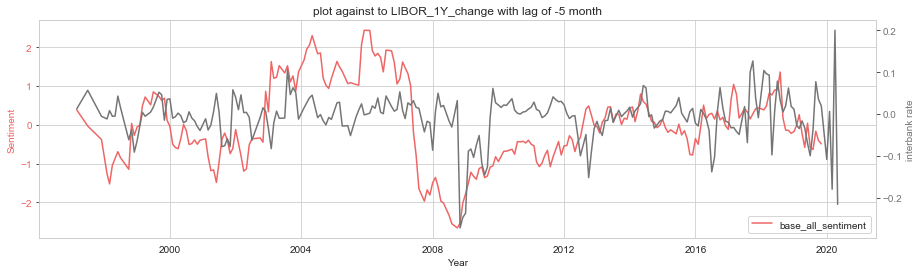

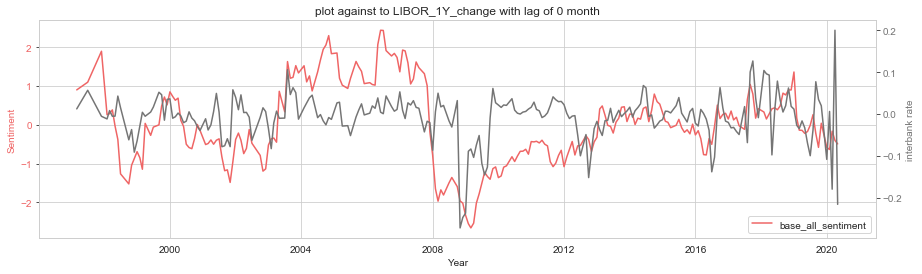

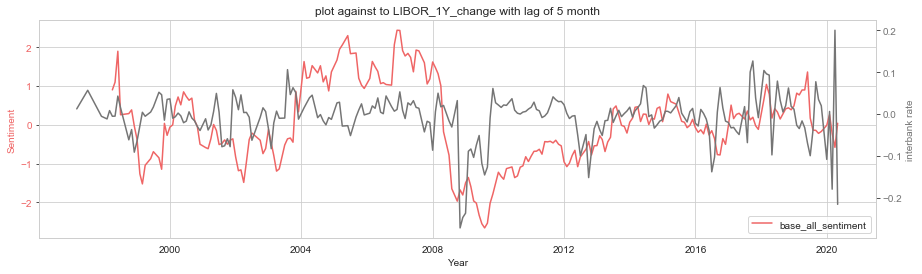

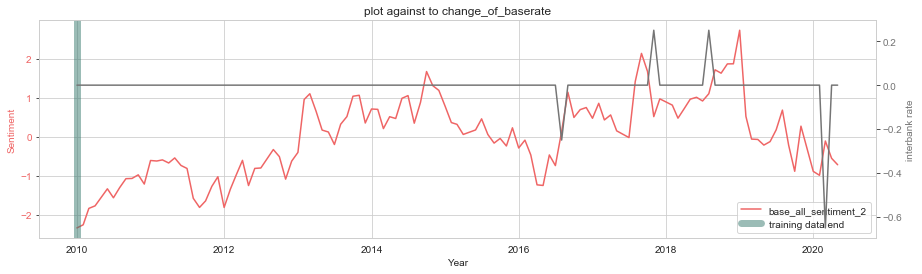

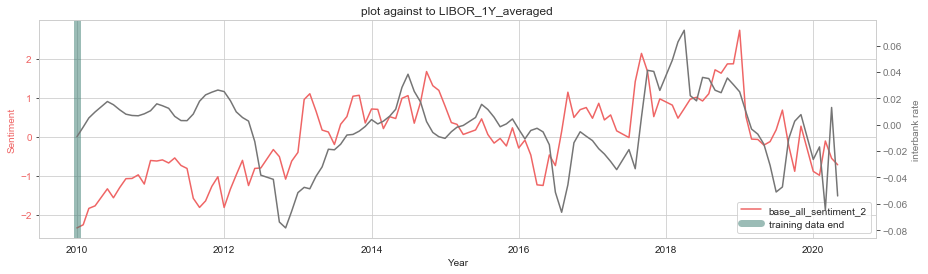

Correlation with Averaging
                   base_all_sentiment_2  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged              0.116239      0.237362     -0.140064
LIBOR_1Y_change                0.105769      0.091358     -0.105417
LIBOR_6M_change                0.142243      0.092090     -0.101234
LIBOR_3M_change                0.121978      0.063522     -0.119026
LIBOR_1M_change                0.104164      0.030099     -0.180355
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.261222
base_all_sentiment         0.261222            1.000000


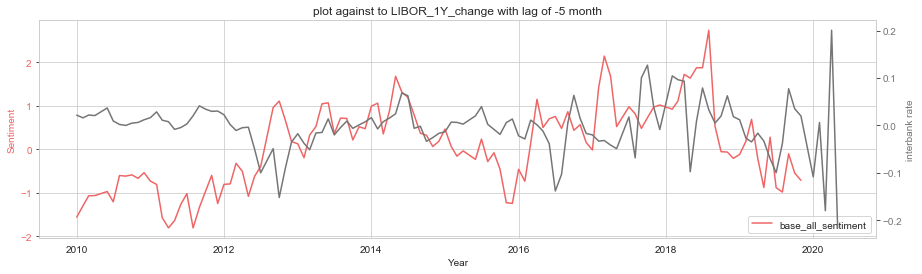

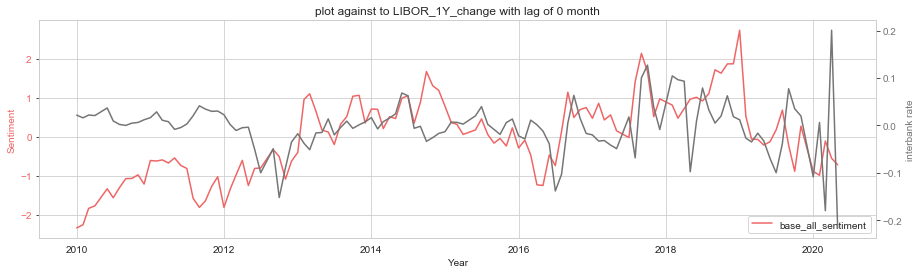

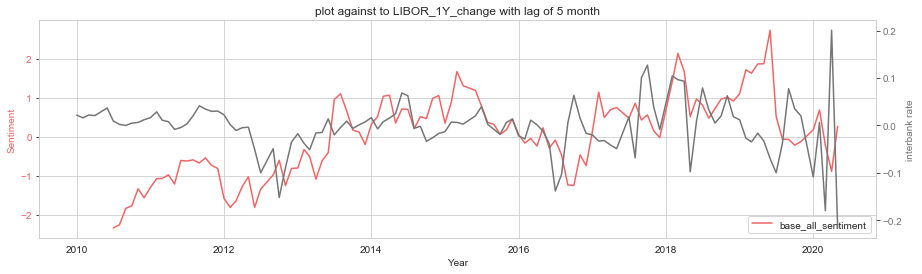

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
LIBOR_1Y_change,-0.023143,-0.036048,0.047832,0.067675,0.035194,0.105769,0.168199,0.130725,0.085065,0.147417,0.06386


In [537]:
#sentiment_97_10_speech_prob = result_dictionary_sentiment_prob(model2,interested_topics,speech_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_speech_prob,end ='2020-06-28',N=halflife)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment_2','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
describe_lagged_information(result)

end_date, start_date='2009-12-31','1997-08-01'
#sentiment_97_10_speech_prob = result_dictionary_sentiment_prob(model2,interested_topics,speech_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_speech_prob,start=end_date,end ='2020-06-28',N=halflife)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment_2','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
describe_lagged_information(result)

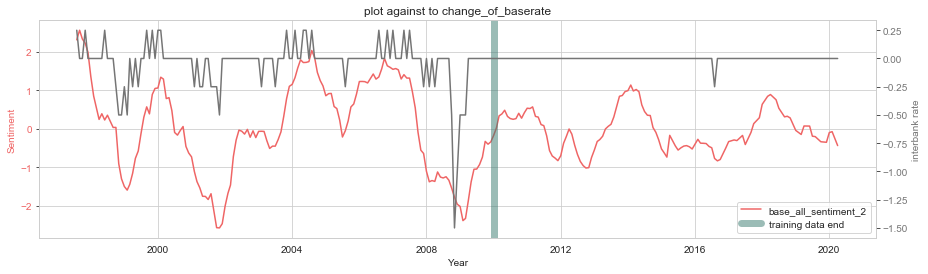

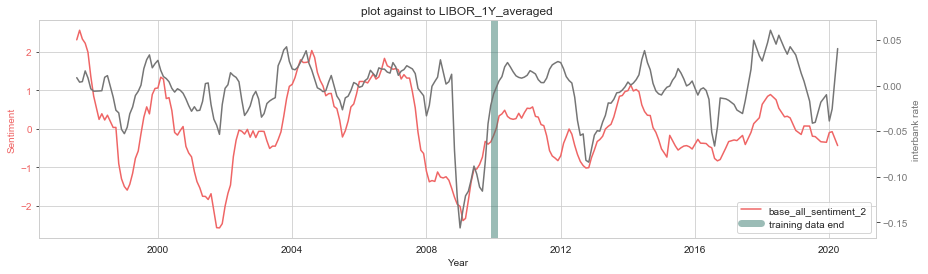

Correlation with Averaging
                   base_all_sentiment_2  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged              0.563150      0.104670      0.349099
LIBOR_1Y_change                0.367126      0.061350      0.301426
LIBOR_6M_change                0.425623      0.066116      0.335994
LIBOR_3M_change                0.431141      0.063718      0.333303
LIBOR_1M_change                0.449622      0.112687      0.375346
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.385308
base_all_sentiment         0.385308            1.000000


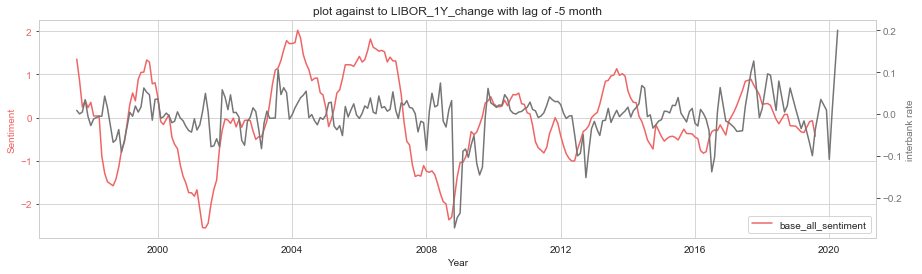

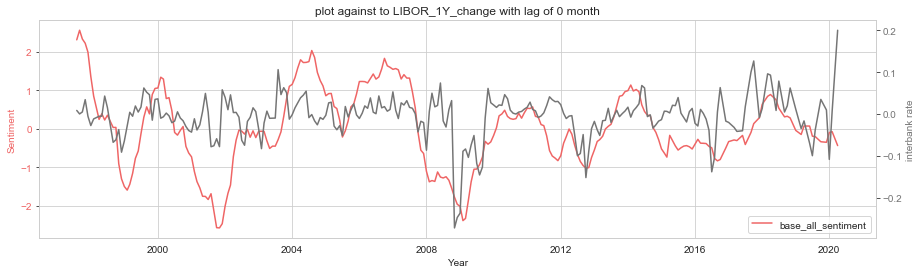

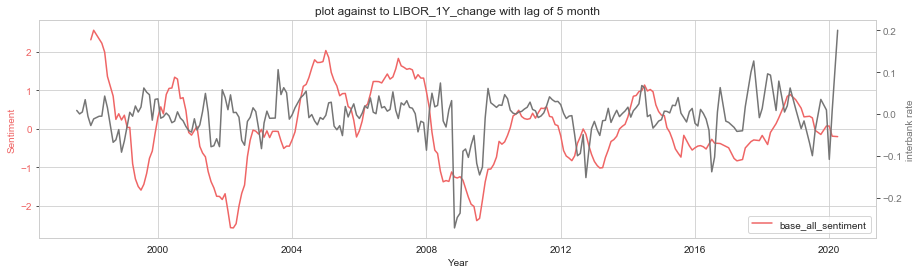

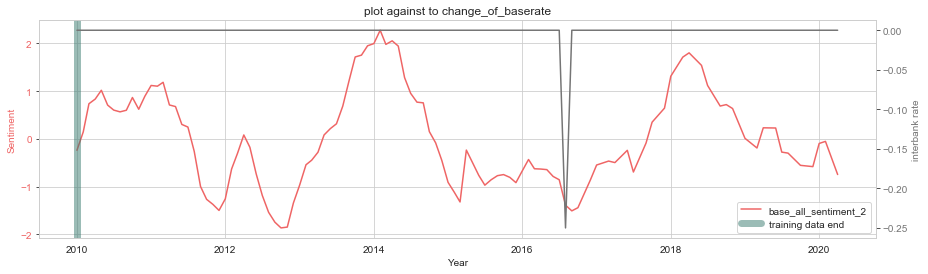

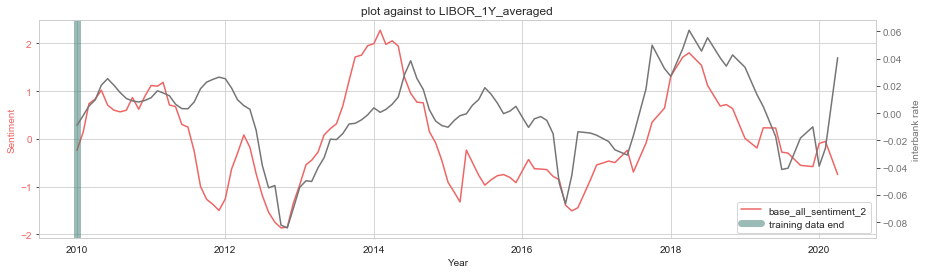

Correlation with Averaging
                   base_all_sentiment_2  LM_sentiment  FS_sentiment
LIBOR_1Y_averaged              0.511047      0.184029      0.216476
LIBOR_1Y_change                0.340754      0.173923      0.275266
LIBOR_6M_change                0.382113      0.150946      0.302134
LIBOR_3M_change                0.354021      0.117473      0.276573
LIBOR_1M_change                0.274944      0.106245      0.209938
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.385308
base_all_sentiment         0.385308            1.000000


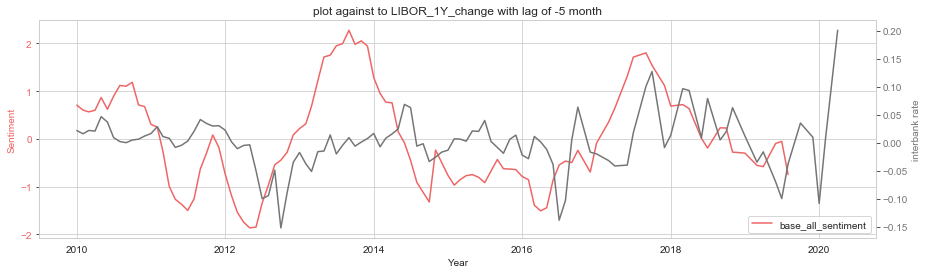

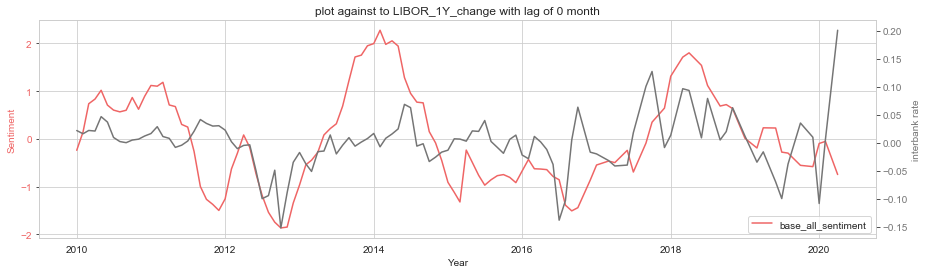

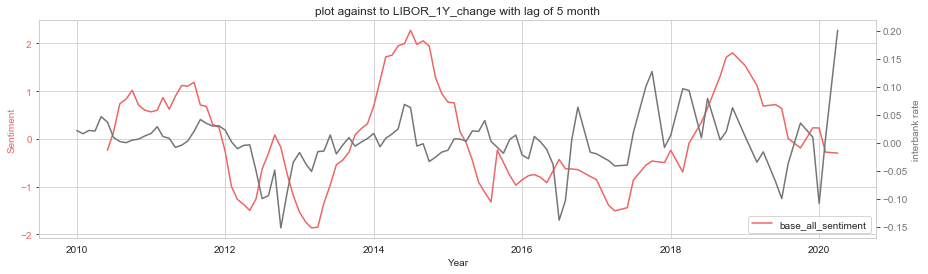

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
LIBOR_1Y_change,0.238188,0.325917,0.417364,0.454481,0.427848,0.340754,0.344705,0.308097,0.272385,0.229326,0.179326


In [540]:
end_date, start_date='2009-12-31','1997-08-01'
#sentiment_97_10_minutes_prob = result_dictionary_sentiment_prob(model2,interested_topics,minutes_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_minutes_prob,start=start_date,end ='2020-06-28',N=halflife)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment_2','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
describe_lagged_information(result)

end_date, start_date='2009-12-31','1997-08-01'
#sentiment_97_10_minutes_prob = result_dictionary_sentiment_prob(model2,interested_topics,minutes_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_minutes_prob,start=end_date,end ='2020-06-28',N=halflife)
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['LIBOR_1Y_averaged','LIBOR_1Y_change','LIBOR_6M_change','LIBOR_3M_change','LIBOR_1M_change'],['base_all_sentiment_2','LM_sentiment','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()
describe_lagged_information(result)

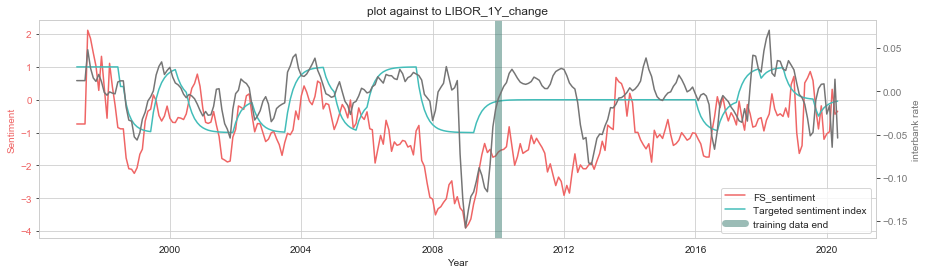

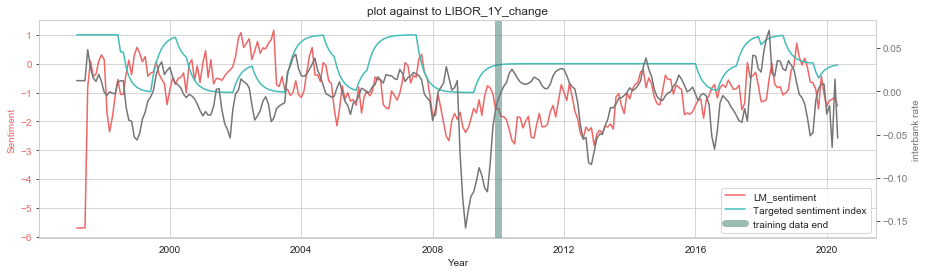

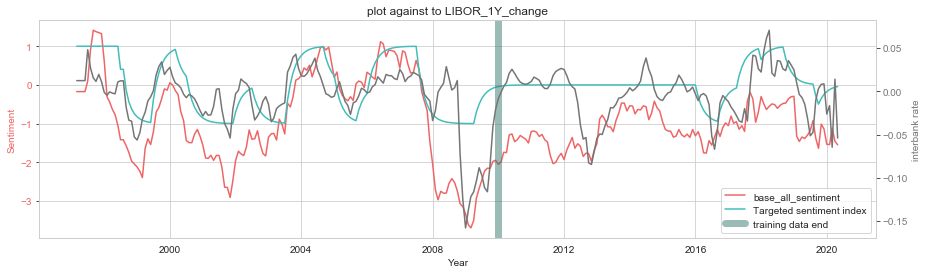

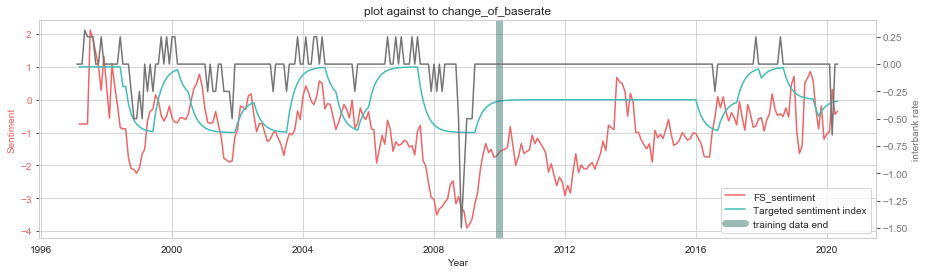

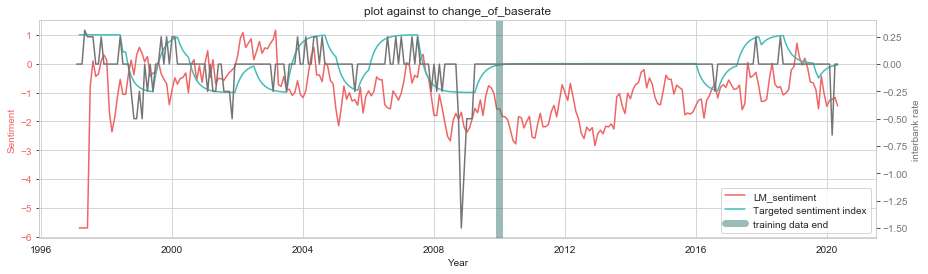

...

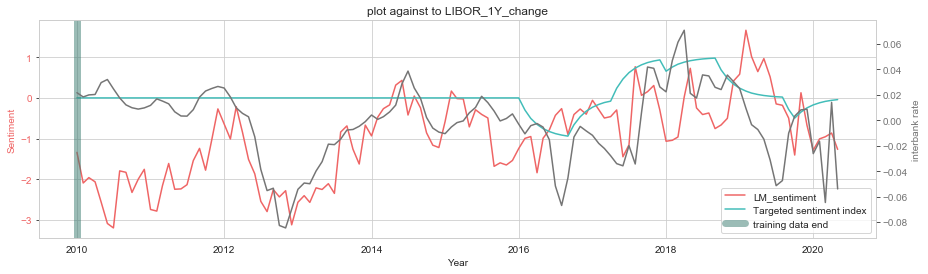

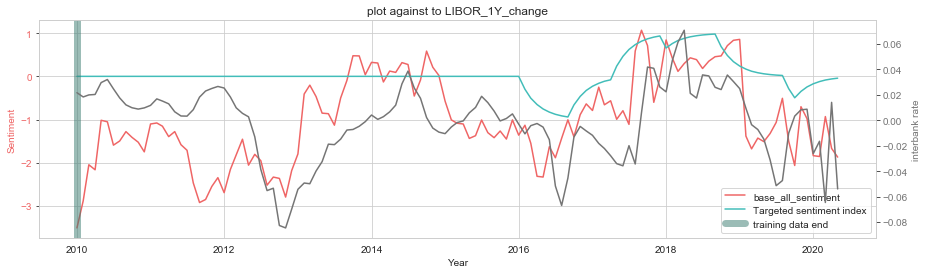

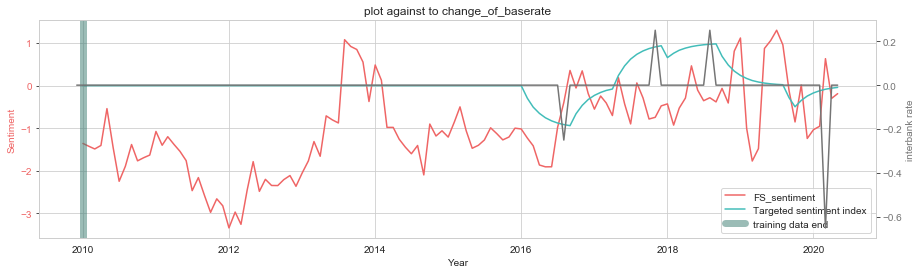

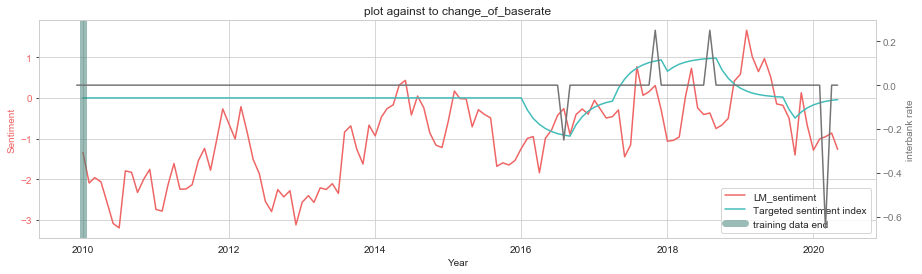

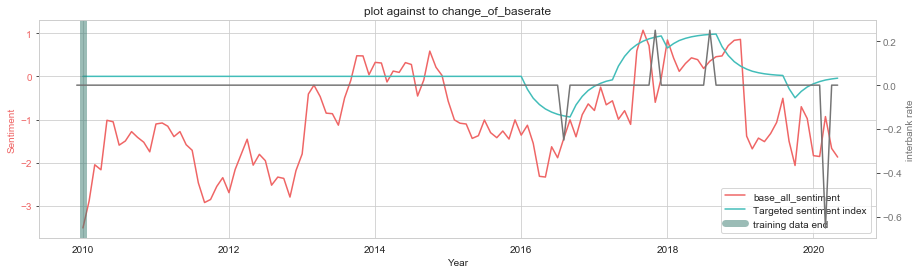

In [420]:
end_date, start_date='2009-12-31','1997-08-01'
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob,end ='2020-06-28')
visualise_prob_model_raw(result)
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob,start=end_date,end ='2020-06-28')
visualise_prob_model_raw(result)

#### 2.2.3: look at lagged correlation 

In [438]:
def create_comparison_plot_for_lagged(sentiment_97_15_merged_prob,column,rate = 'Interest_rate',end_date='',lag=0):
    df1 = sentiment_97_15_merged_prob.copy()
    df1.loc[:,column] = (df1.loc[:,column]-df1.loc[:,column].mean())/np.std(df1.loc[:,column])
    fig, ax1 = plt.subplots(figsize=(15,4))
    ax1.set_xlabel('Year')
    ax1.set_ylabel('Sentiment', color=my_color[0])
    ax1.plot(df1.index,df1.loc[:,column].shift(lag).values,color = my_color[0],label = column)
    #ax1.plot(df1.index,df1.label_2.values,color = my_color[1],label = 'Targeted sentiment index')
    if end_date!='':
        ax1.axvline(pd.to_datetime(end_date), -1, 1, color='#387a6f',alpha=0.5,lw=7, label='training data end')
    ax1.tick_params(axis='y', labelcolor=my_color[0])
    ax1.legend(loc='lower right')
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    ax2.grid(False)
    ax2.set_ylabel('interbank rate', color='#757575')  # we already handled the x-label with ax1
    ax2.plot(df1.index,df1.loc[:,rate].values,color='#757575')
    ax2.tick_params(axis='y', labelcolor='#757575')
    plt.title('plot against to '+rate+' with lag of {} month'.format(lag))
    plt.show()
def describe_lagged_information(df1,rate='LIBOR_1Y_change',sentiment ='base_all_sentiment'):   
    create_comparison_plot_for_lagged(df1,sentiment,rate = rate,end_date='',lag=-5)    
    create_comparison_plot_for_lagged(df1,sentiment,rate = rate,end_date='',lag=0)    
    create_comparison_plot_for_lagged(df1,sentiment,rate = rate,end_date='',lag=5)    
    y = df1.loc[:,rate]
    return pd.DataFrame({'lag {}'.format(i):df1.loc[:,sentiment].shift(i).corr(y) for i in range(-5,6)},index=[rate])

1997-03-01    0.012387
1997-07-01    0.056904
1997-08-01    0.008657
1997-09-01    0.000265
1997-10-01    0.005013
                ...   
2020-02-01    0.006248
2020-03-01   -0.179832
2020-04-01    0.200617
2020-05-01   -0.216137
2020-06-01         NaN
Name: LIBOR_1Y_change, Length: 276, dtype: float64
1997-03-01    0.012387
1997-07-01    0.038464
1997-08-01    0.024959
1997-09-01    0.015316
1997-10-01    0.011650
                ...   
2020-02-01   -0.016493
2020-03-01   -0.064334
2020-04-01    0.013269
2020-05-01   -0.053923
2020-06-01   -0.053923
Name: LIBOR_1Y_change, Length: 276, dtype: float64


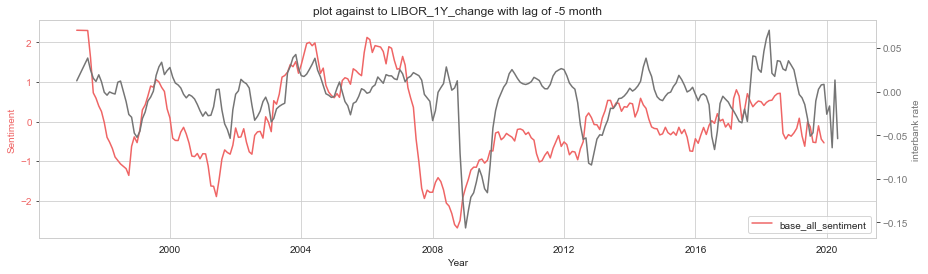

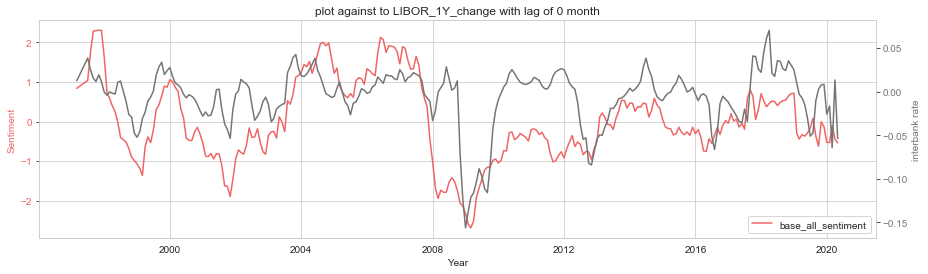

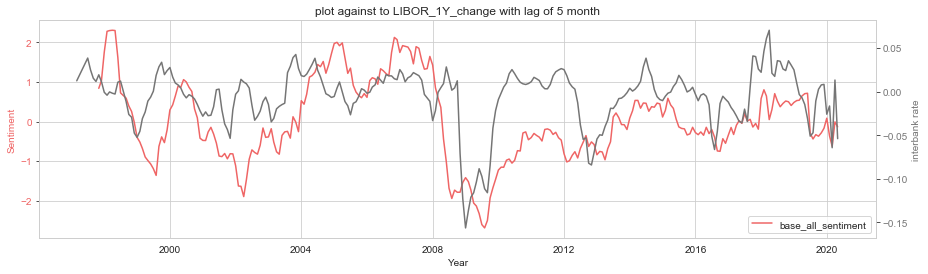

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
LIBOR_1Y_change,0.352467,0.417697,0.482442,0.53028,0.553907,0.559536,0.55425,0.531831,0.503736,0.471381,0.449774


In [455]:
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob,start='2008-12-28',end ='2020-06-28')
describe_lagged_information(result)

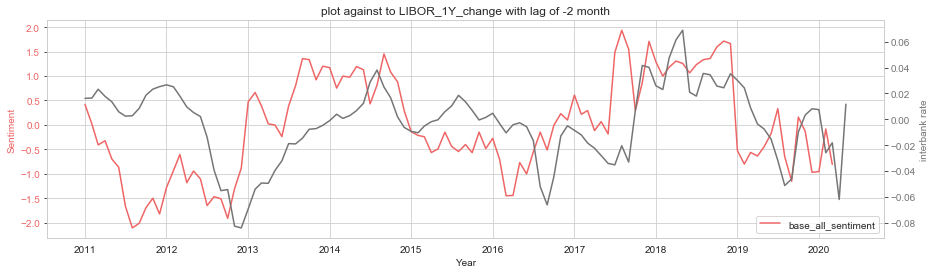

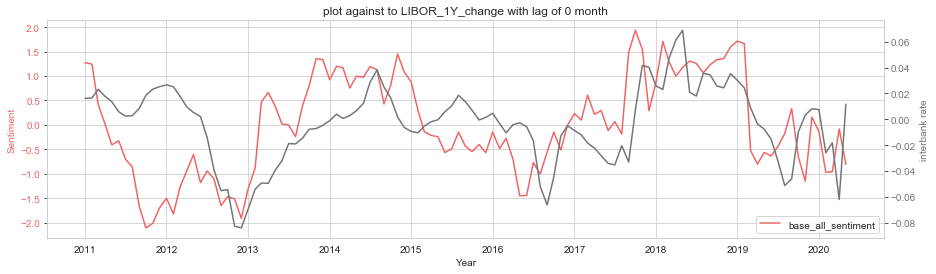

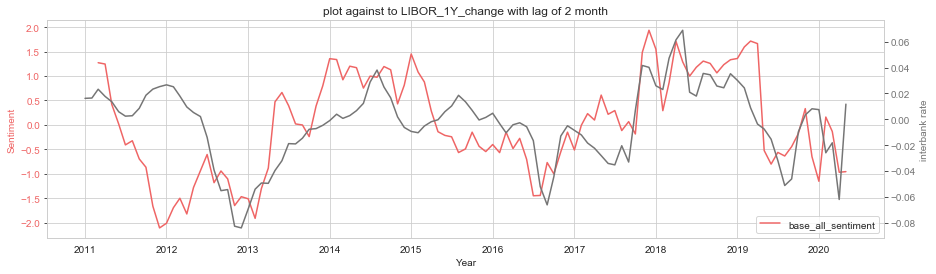

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
LIBOR_1Y_change,-0.024947,0.052105,0.16753,0.248852,0.322627,0.37869,0.467186,0.493667,0.484308,0.459055,0.463131


In [248]:
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob,start=end_date,end ='2020-06-28')
describe_lagged_information(result)

1997-03-01    0.012387
1997-07-01    0.056904
1997-12-01   -0.005409
1998-02-01   -0.011671
1998-03-01    0.008313
                ...   
2020-02-01    0.006248
2020-03-01   -0.179832
2020-04-01    0.200617
2020-05-01   -0.216137
2020-06-01         NaN
Name: LIBOR_1Y_change, Length: 248, dtype: float64
1997-03-01    0.012387
1997-07-01    0.038464
1997-12-01    0.018586
1998-02-01    0.006770
1998-03-01    0.007319
                ...   
2020-02-01   -0.016800
2020-03-01   -0.064551
2020-04-01    0.013115
2020-05-01   -0.054032
2020-06-01   -0.054032
Name: LIBOR_1Y_change, Length: 248, dtype: float64


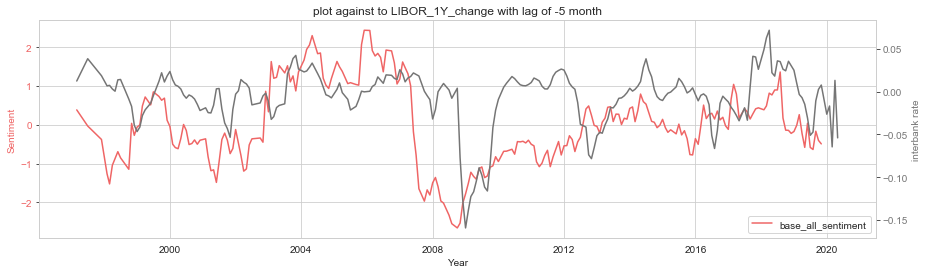

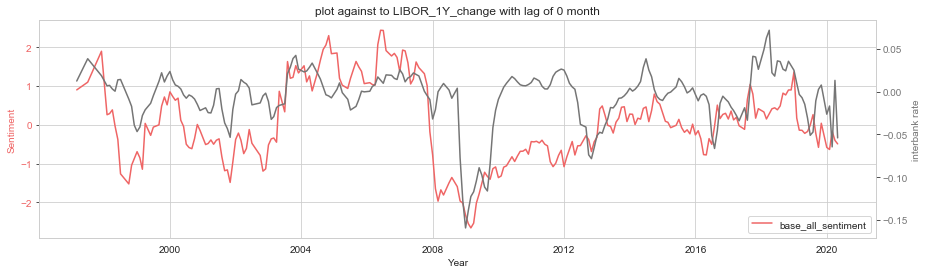

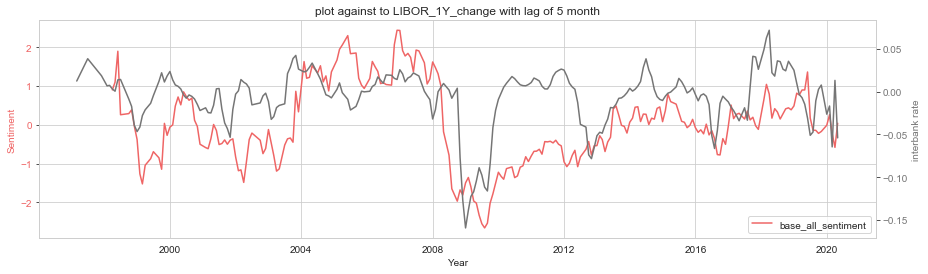

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
LIBOR_1Y_change,0.334312,0.378174,0.431684,0.477319,0.508147,0.526884,0.533592,0.531848,0.513299,0.49534,0.468631


In [453]:
result,result2 = rolling_averaging_ewm(sentiment_97_10_speech_prob,start=end_date,end ='2020-06-28')
describe_lagged_information(result)

#### 2.2.4: look at inflation/employment rate

In [160]:
df1 = pd.read_excel('./scripter/cleaned_dataset/monthly_cpi.xlsx',index_col=0)
dates = []
values = []
for year in df1.index[::-1]:
    for month in df1.columns[:-1]:
        dates.append(month+' '+str(year))
        values.append(df1.loc[year,month])
cpi_data = pd.DataFrame({'cpi':values},index=pd.DatetimeIndex(dates))

In [172]:
inflation_sentiment_trainedonrates = sentiment_97_10_merged_prob.copy()
inflation_sentiment_trainedonrates = inflation_sentiment_trainedonrates.join(cpi_data,how='inner')
result,result2 = rolling_averaging_ewm(inflation_sentiment_trainedonrates,end ='2020-06-28')

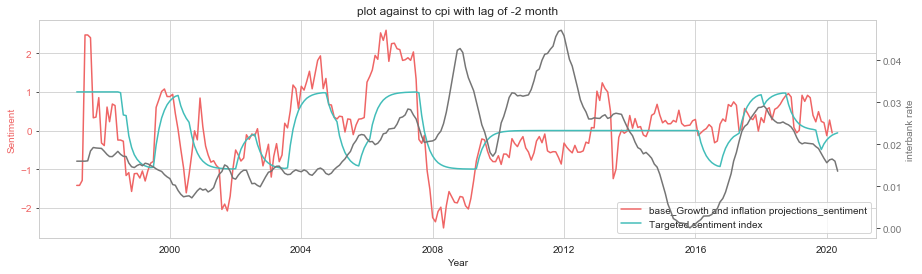

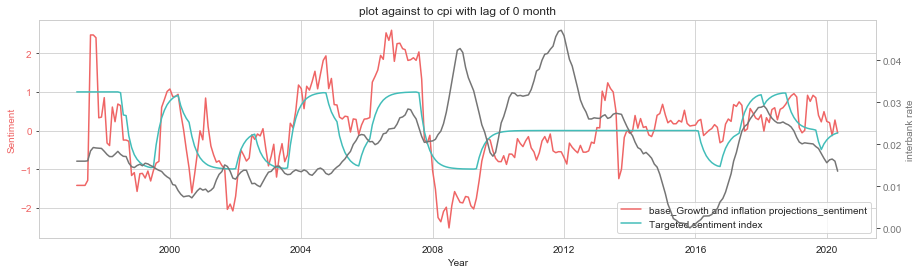

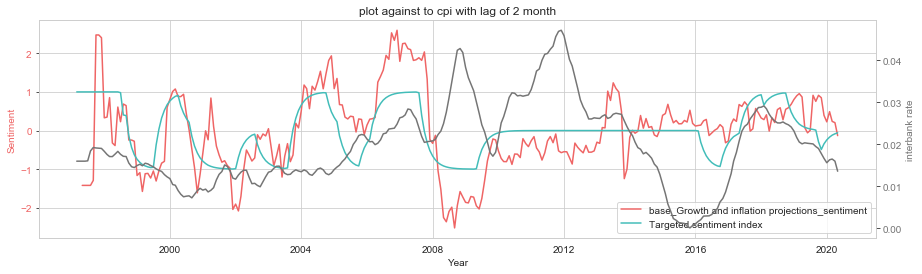

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
cpi,-0.135038,-0.137674,-0.139812,-0.141333,-0.141808,-0.143091,-0.150815,-0.156265,-0.162003,-0.163506,-0.160859


In [182]:
result,result2 = rolling_averaging_ewm(inflation_sentiment_trainedonrates,end ='2020-06-28')
describe_lagged_information(result,rate='cpi',sentiment ='base_Growth and inflation projections_sentiment')

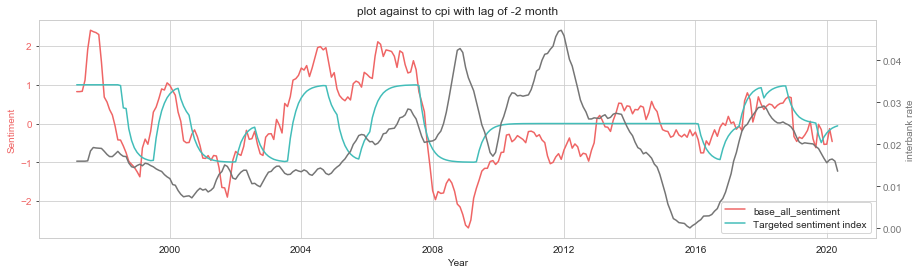

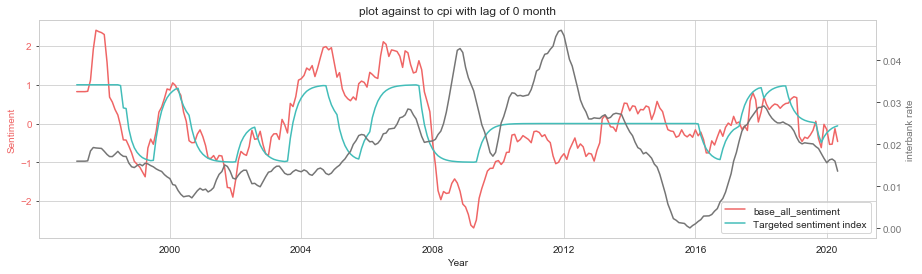

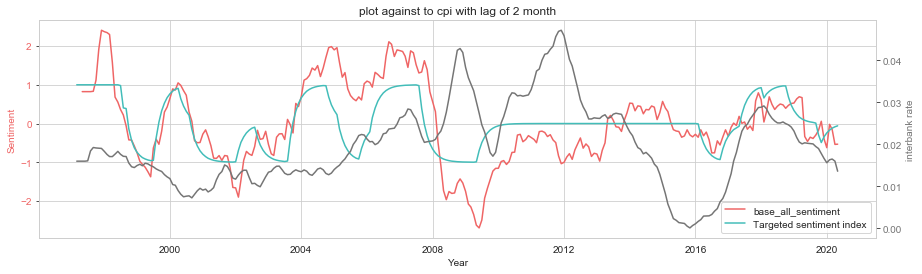

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
cpi,-0.181983,-0.176924,-0.173076,-0.169286,-0.167092,-0.16673,-0.168423,-0.170101,-0.171269,-0.170207,-0.164414


In [183]:
result,result2 = rolling_averaging_ewm(inflation_sentiment_trainedonrates,end ='2020-06-28')
describe_lagged_information(result,rate='cpi',sentiment ='base_all_sentiment')

----
----
----








In [171]:
result

,label,label_2,base_all_sentiment,base_Financial markets_sentiment,base_The immediate policy decision_sentiment,base_Growth and inflation projections_sentiment,"base_Money, credit, demand and output_sentiment","base_Supply, costs and prices_sentiment",base_The international economy_sentiment,Topical_mean_base,FS_sentiment,LM_sentiment,LIBOR_1Y_change,Interest_rate,change_of_rate
1997-03-01,0.000000,1.000000,0.241972,0.386777,-0.160937,-0.257388,NaN,NaN,NaN,-0.010516,-0.071429,-1.000000,0.012387,5.94,0.00
1997-04-01,0.000000,1.000000,0.241972,0.386777,-0.160937,-0.257388,NaN,NaN,NaN,-0.010516,-0.071429,-1.000000,0.012387,5.94,0.00
1997-05-01,0.000000,1.000000,0.241972,0.386777,-0.160937,-0.257388,NaN,NaN,NaN,-0.010516,-0.071429,-1.000000,0.012387,5.94,0.31
1997-06-01,0.000000,1.000000,0.241972,0.386777,-0.160937,-0.257388,NaN,NaN,NaN,-0.010516,-0.071429,-1.000000,0.012387,6.25,0.25
1997-07-01,0.000000,1.000000,0.243468,0.375757,-0.139750,-0.233734,NaN,NaN,NaN,0.000758,-0.060179,-0.964281,0.013580,6.50,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-01-01,-0.081464,-0.242741,0.079612,0.247437,-0.057517,0.044489,0.444729,0.516632,0.085876,0.157905,-0.125928,0.021291,0.007505,0.75,0.00
2020-02-01,-0.057203,-0.170448,0.016214,0.232173,-0.036559,0.038530,0.177017,0.597035,0.105377,0.140148,-0.106605,-0.073077,-0.025940,0.75,0.00
2020-03-01,-0.040092,-0.119463,0.017217,0.225707,-0.062670,-0.022725,0.240976,0.645047,0.121303,0.128652,-0.093783,-0.029201,-0.018202,0.75,-0.65
2020-04-01,-0.028297,-0.084318,0.083544,0.103080,-0.108417,0.050940,0.247997,0.645047,0.118481,0.074042,0.050485,-0.020334,-0.062113,0.10,0.00


## Step 3: ML based sentiments

In [104]:
result = []
for doc_list in merged_timeseries_labelled.loc[:,'N_topics']:
    document = ''
    for para in doc_list:      
        document += ' '.join(para[1:])
    result.append(document)
merged_timeseries_labelled.loc[:,'cleaned'] = result
merged_timeseries_labelled.loc[:,'cleaned'] = preprocess_data(list(merged_timeseries_labelled.loc[:,'cleaned']))
#merged_timeseries_labelled = pd.read_hdf('regression_data.h5', 'minutes')
word_list = list(dictionary_model_97_15_merged[0].loc[:,'Entry'])
merged_timeseries_labelled.loc[:,'cleaned string'] = merged_timeseries_labelled.loc[:,'cleaned'].apply(lambda x: ' '.join([i for i in x if i in word_list]))
merged_timeseries_labelled_backup = merged_timeseries_labelled.copy()

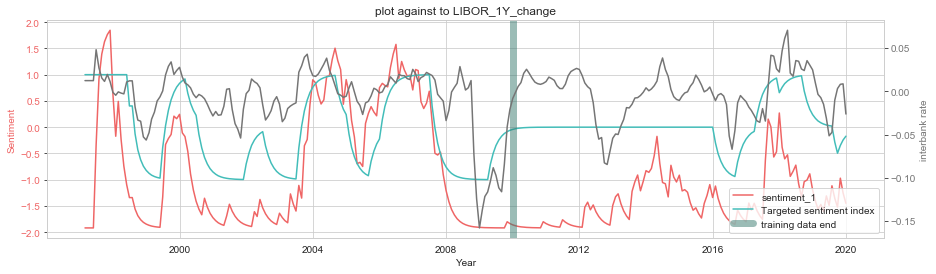

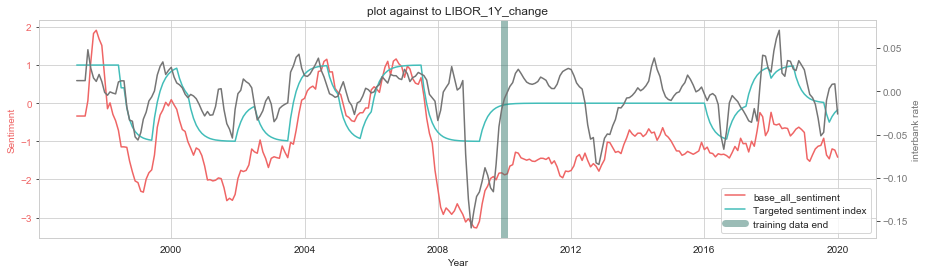

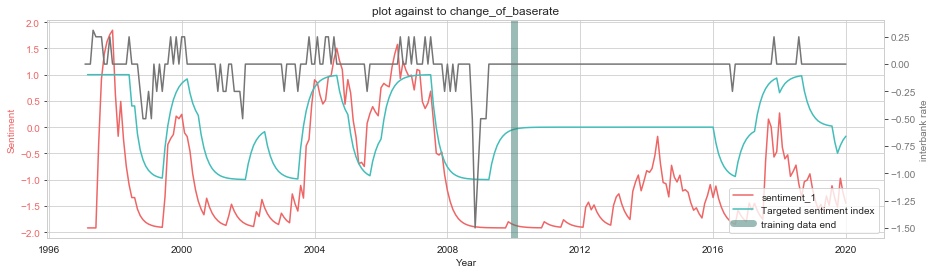

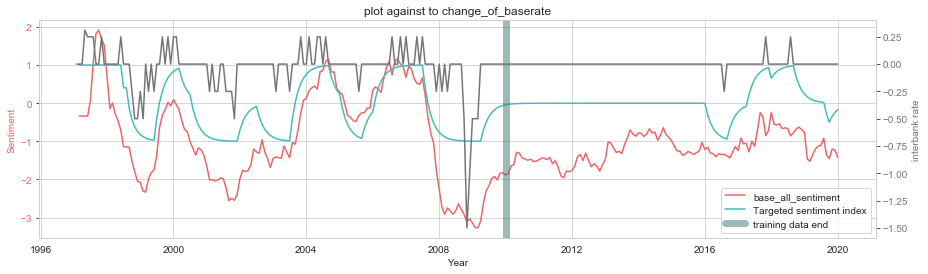

Correlation with Averaging
                 sentiment_1  base_all_sentiment
label_2             0.634217            0.766259
LIBOR_1Y_change     0.414363            0.518250
Interest_rate       0.405141            0.310930
change_of_rate      0.276745            0.344682
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.305264
base_all_sentiment         0.305264            1.000000


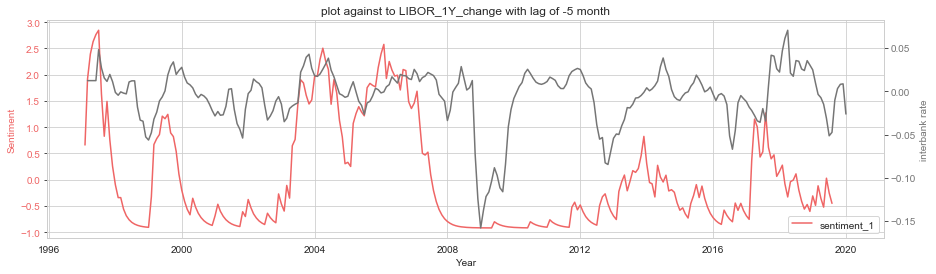

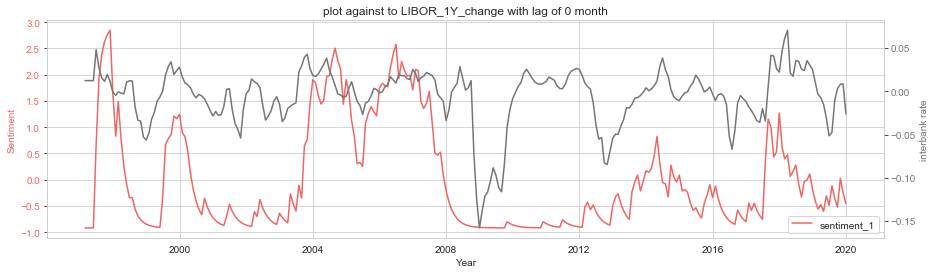

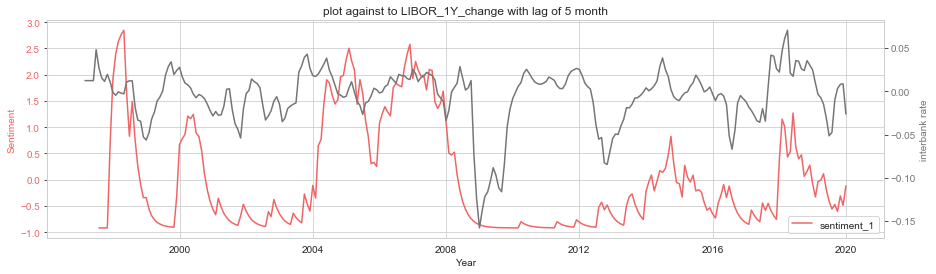

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.337615  0.376952  0.399732  0.413177  0.416278  0.414363   

                    lag 1     lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.400426  0.375493  0.350246  0.318618  0.297208  


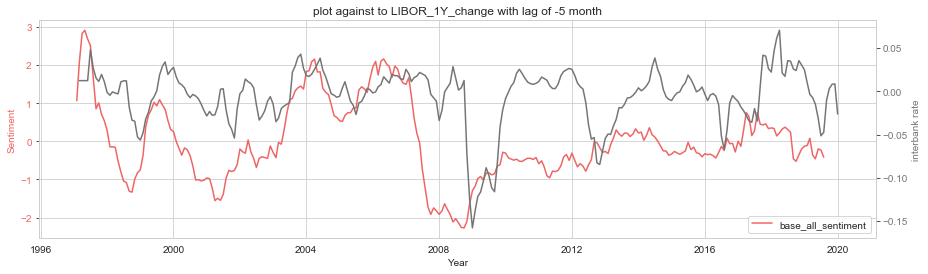

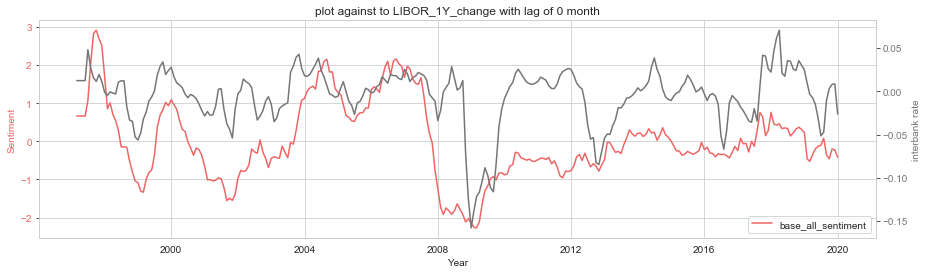

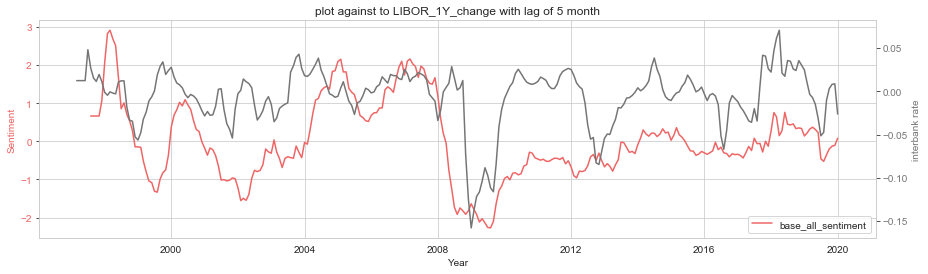

                   lag -5    lag -4    lag -3    lag -2    lag -1    lag 0  \
LIBOR_1Y_change  0.351205  0.409573  0.463006  0.500219  0.516048  0.51825   

                    lag 1     lag 2    lag 3    lag 4     lag 5  
LIBOR_1Y_change  0.507179  0.488639  0.46389  0.43588  0.414515  







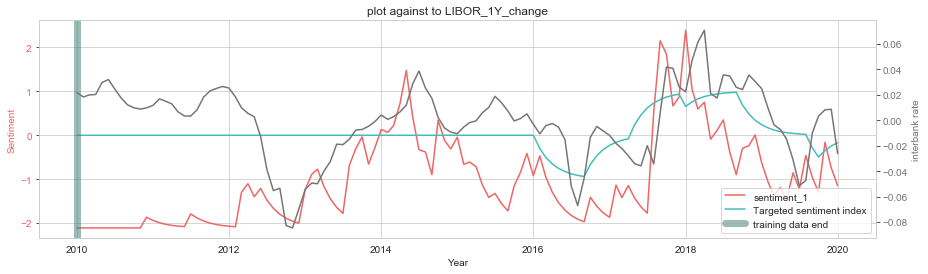

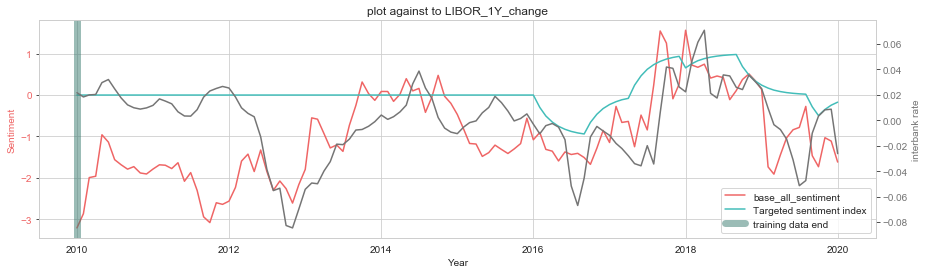

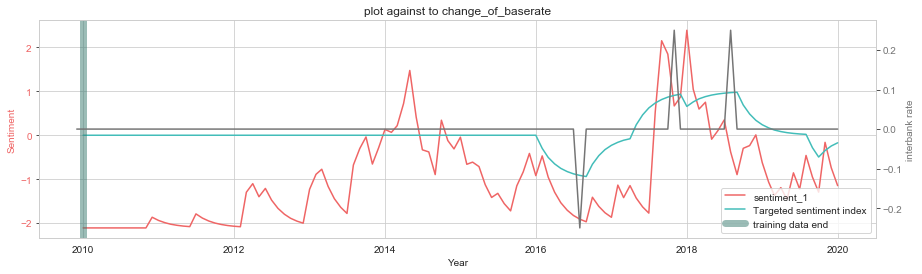

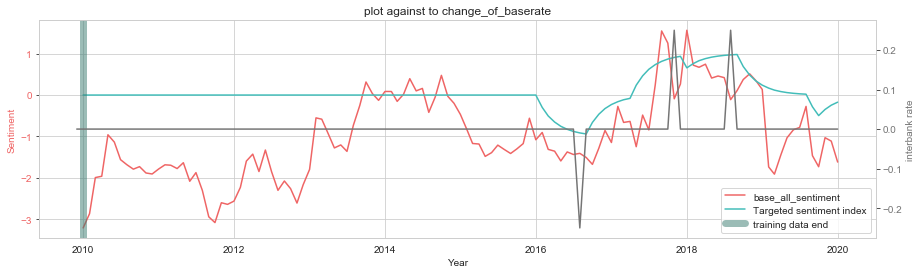

Correlation with Averaging
                 sentiment_1  base_all_sentiment
label_2             0.530203            0.530617
LIBOR_1Y_change     0.295456            0.274118
Interest_rate      -0.504196           -0.595234
change_of_rate      0.320114            0.263680
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.305264
base_all_sentiment         0.305264            1.000000


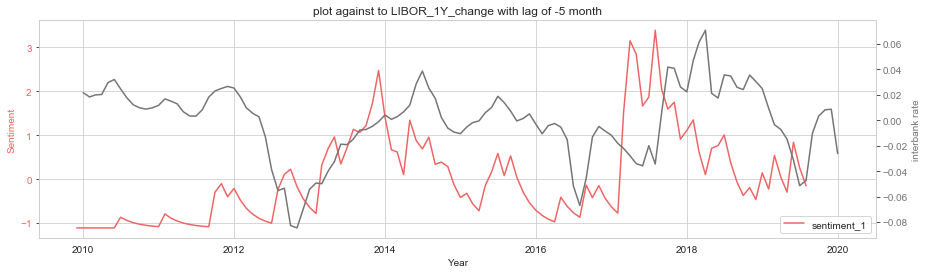

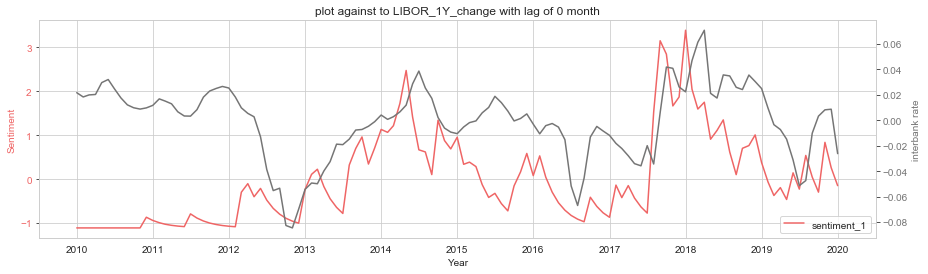

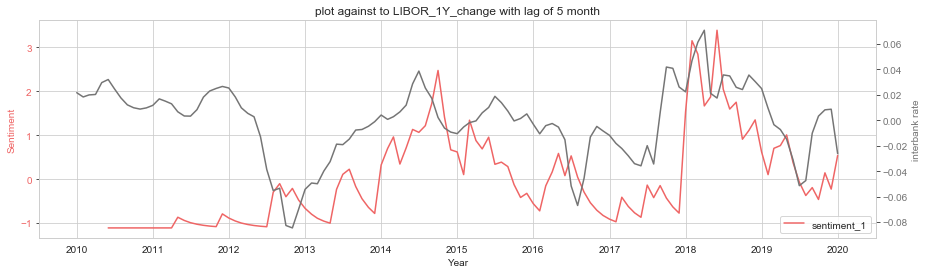

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change -0.051732  0.029459  0.100877  0.152285  0.209114  0.295456   

                   lag 1     lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.38094  0.388317  0.372159  0.322185  0.315093  


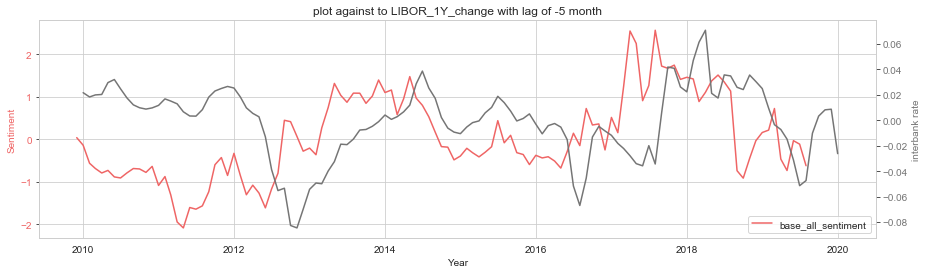

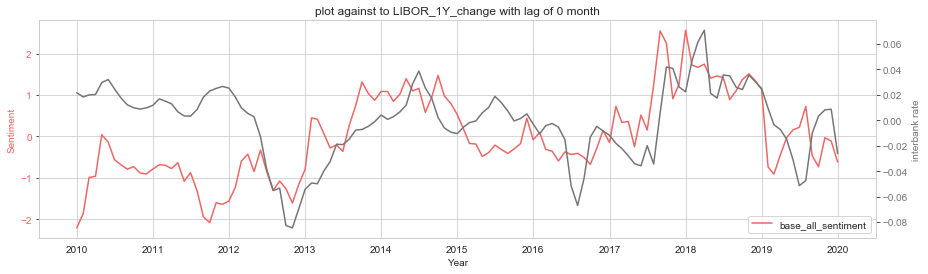

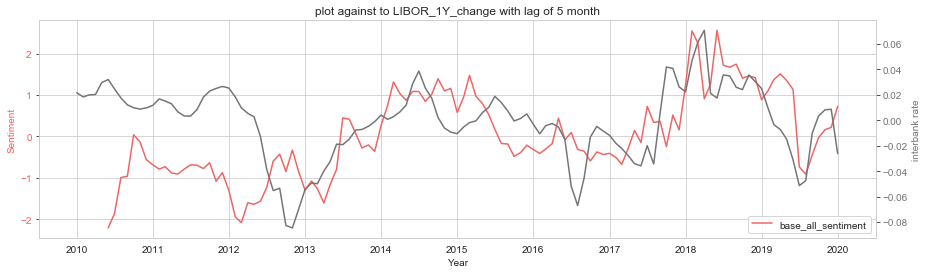

                  lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change -0.03472  0.050862  0.142797  0.198973  0.227118  0.274118   

                    lag 1     lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.326814  0.337676  0.345795  0.329669  0.333647  


In [443]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer


end_date='2009-12-31'
def train_multiNB(merged_timeseries_labelled,end_date):
    X_train = merged_timeseries_labelled.loc[end_date:,'cleaned string']
    X_test = merged_timeseries_labelled.loc[:end_date,'cleaned string']
    y_train = merged_timeseries_labelled.loc[end_date:,'label_2']
    y_test = merged_timeseries_labelled.loc[:end_date,'label_2']


    text_clf = Pipeline([('vect', CountVectorizer()),
                         ('tfidf', TfidfTransformer()),
                         ('clf', MultinomialNB()),
                         ])



    text_clf.fit(X_train, y_train)
    predicted_train = text_clf.predict(X_train)
    predicted_test = text_clf.predict(X_test)
    merged_timeseries_labelled.loc[:,'sentiment_1'] = list(predicted_test)+list(predicted_train)
    
    
    predicted_train_prob = text_clf.predict_proba(X_train)
    predicted_train_prob = [i[2]-i[0] for i in predicted_train_prob]
    predicted_test_prob = text_clf.predict_proba(X_test)
    predicted_test_prob = [i[2]-i[0] for i in predicted_test_prob]
    merged_timeseries_labelled.loc[:,'base_all_sentiment'] = predicted_test_prob + predicted_train_prob



    result_NB,result_NB2 = rolling_averaging_ewm(merged_timeseries_labelled.loc[:,['label_2','sentiment_1','base_all_sentiment']])
    result_NB.loc[:,'base_all_sentiment'] = (result_NB.loc[:,'base_all_sentiment']-result_NB.loc[:,'base_all_sentiment'].mean())/np.std(result_NB.loc[:,'base_all_sentiment'])
    result_NB.loc[:,'sentiment_1'] = (result_NB.loc[:,'sentiment_1']-result_NB.loc[:,'sentiment_1'].mean())/np.std(result_NB.loc[:,'sentiment_1'])
    create_comparison_plot(result_NB,'sentiment_1',rate = 'LIBOR_1Y_change', end_date=end_date)
    create_comparison_plot(result_NB,'base_all_sentiment',rate = 'LIBOR_1Y_change', end_date=end_date)
    create_comparison_plot(result_NB,'sentiment_1',rate = 'change_of_baserate', end_date=end_date)
    create_comparison_plot(result_NB,'base_all_sentiment',rate = 'change_of_baserate', end_date=end_date)
    print('Correlation with Averaging')
    print(result_NB.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['sentiment_1','base_all_sentiment']])
    print('Correlation No Averaging')
    print(result_NB2.corr())
    print(describe_lagged_information(result_NB,rate='LIBOR_1Y_change',sentiment ='sentiment_1'))
    print(describe_lagged_information(result_NB,rate='LIBOR_1Y_change'))
    
    for i in range(5):
        print()

    result_NB,result_NB2 = rolling_averaging_ewm(merged_timeseries_labelled.loc[:,['label_2','sentiment_1','base_all_sentiment']],start=end_date)
    result_NB.loc[:,'base_all_sentiment'] = (result_NB.loc[:,'base_all_sentiment']-result_NB.loc[:,'base_all_sentiment'].mean())/np.std(result_NB.loc[:,'base_all_sentiment'])
    result_NB.loc[:,'sentiment_1'] = (result_NB.loc[:,'sentiment_1']-result_NB.loc[:,'sentiment_1'].mean())/np.std(result_NB.loc[:,'sentiment_1'])
    create_comparison_plot(result_NB,'sentiment_1',rate = 'LIBOR_1Y_change', end_date=end_date)
    create_comparison_plot(result_NB,'base_all_sentiment',rate = 'LIBOR_1Y_change', end_date=end_date)
    create_comparison_plot(result_NB,'sentiment_1',rate = 'change_of_baserate', end_date=end_date)
    create_comparison_plot(result_NB,'base_all_sentiment',rate = 'change_of_baserate', end_date=end_date)
    print('Correlation with Averaging')
    print(result_NB.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['sentiment_1','base_all_sentiment']])
    print('Correlation No Averaging')
    print(result_NB2.corr())
    print(describe_lagged_information(result_NB,rate='LIBOR_1Y_change',sentiment ='sentiment_1'))
    print(describe_lagged_information(result_NB,rate='LIBOR_1Y_change'))
    return None
train_multiNB(merged_timeseries_labelled,end_date='2009-12-31')

C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


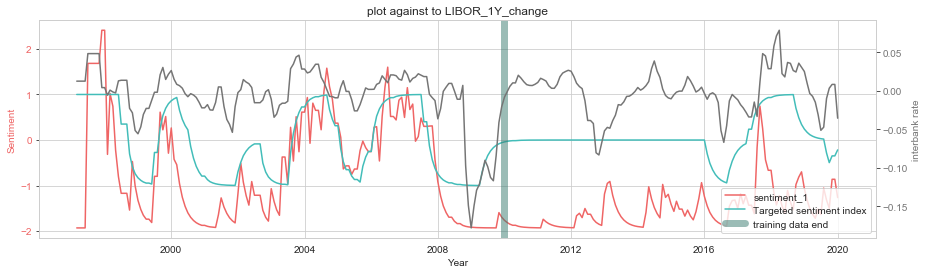

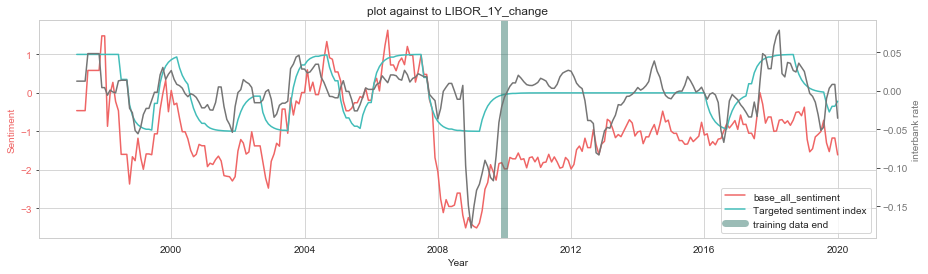

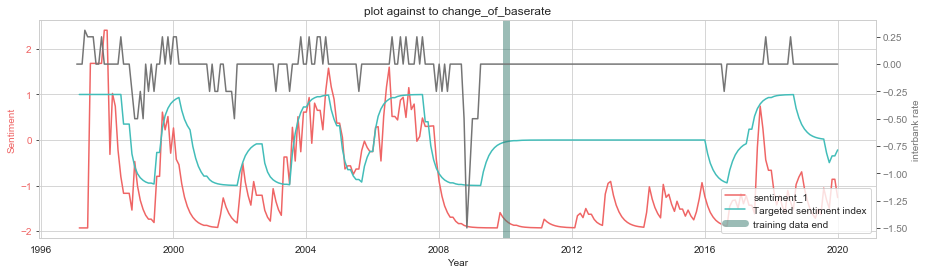

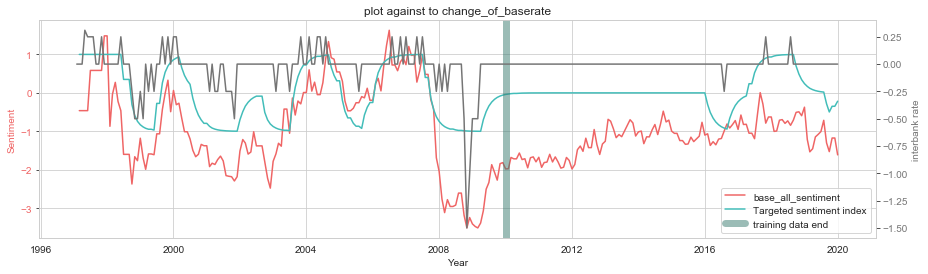

Correlation with Averaging
                 sentiment_1  base_all_sentiment
label_2             0.578434            0.701685
LIBOR_1Y_change     0.391789            0.507871
Interest_rate       0.507805            0.280777
change_of_rate      0.248580            0.333105
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.240712
base_all_sentiment         0.240712            1.000000


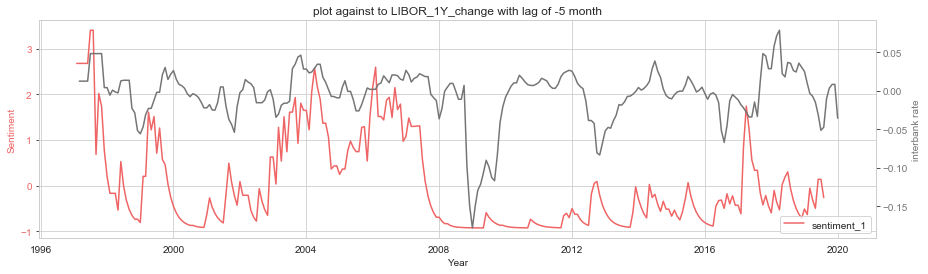

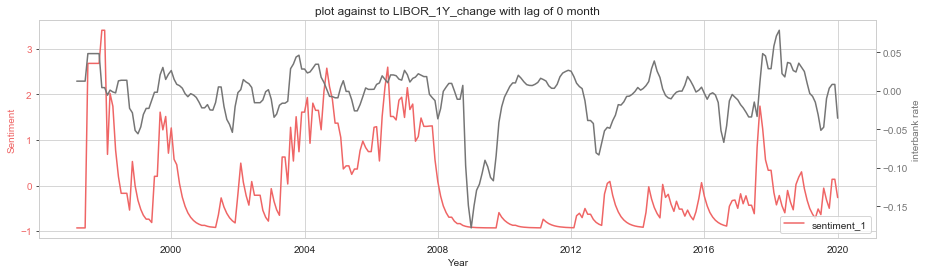

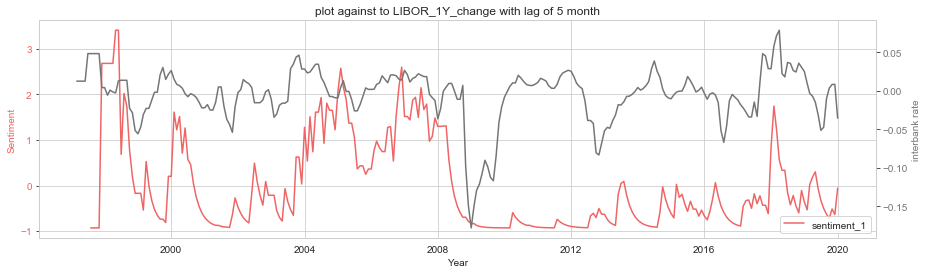

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.300871  0.323381  0.343965  0.373235  0.382303  0.391789   

                    lag 1     lag 2     lag 3     lag 4    lag 5  
LIBOR_1Y_change  0.373704  0.350953  0.326793  0.287611  0.26176  


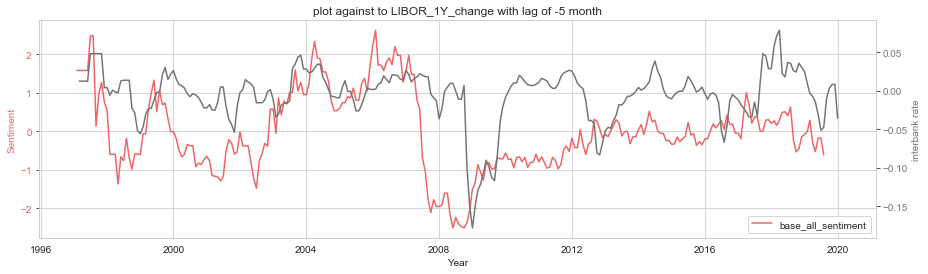

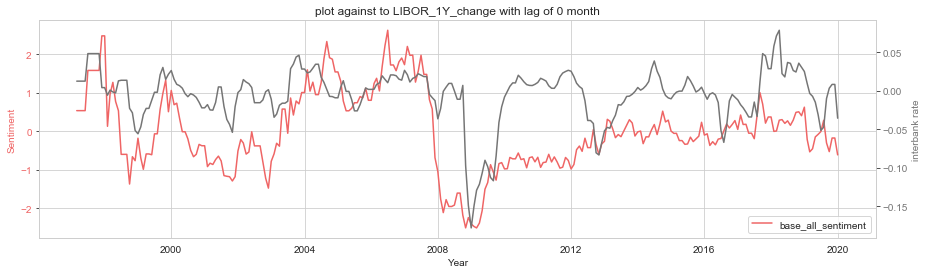

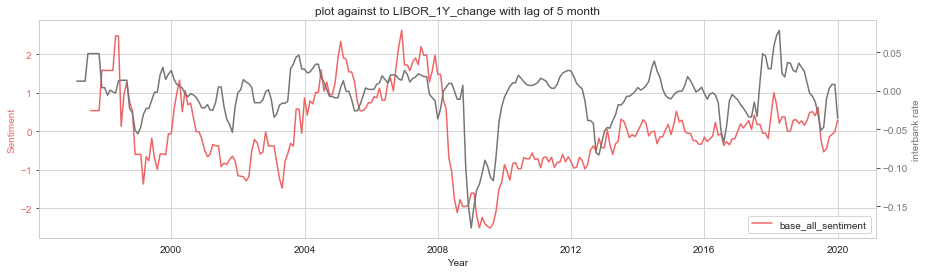

                   lag -5    lag -4    lag -3   lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.352238  0.393593  0.437503  0.47772  0.491598  0.507871   

                    lag 1     lag 2     lag 3     lag 4    lag 5  
LIBOR_1Y_change  0.508513  0.511481  0.502546  0.475421  0.45752  







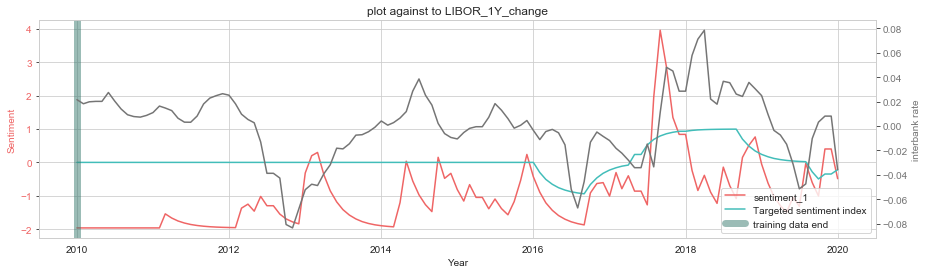

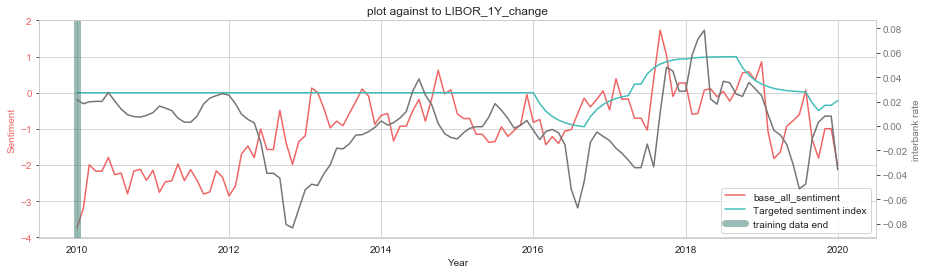

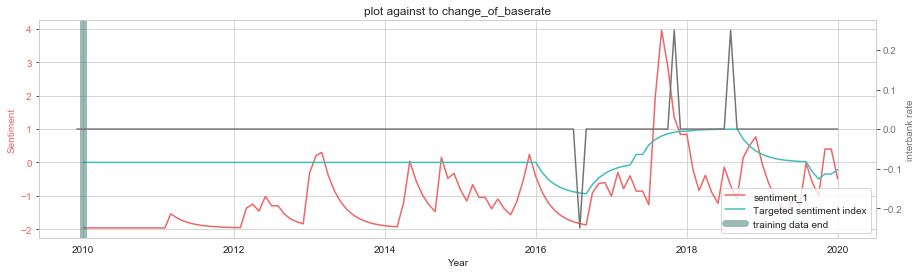

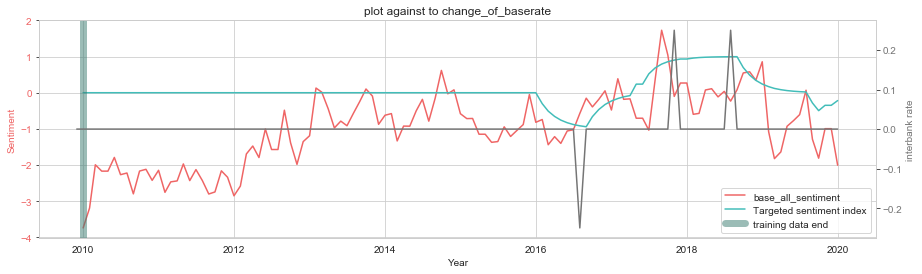

Correlation with Averaging
                 sentiment_1  base_all_sentiment
label_2             0.446830            0.333535
LIBOR_1Y_change     0.123028           -0.033543
Interest_rate      -0.484158           -0.701517
change_of_rate      0.210145            0.035140
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.240712
base_all_sentiment         0.240712            1.000000


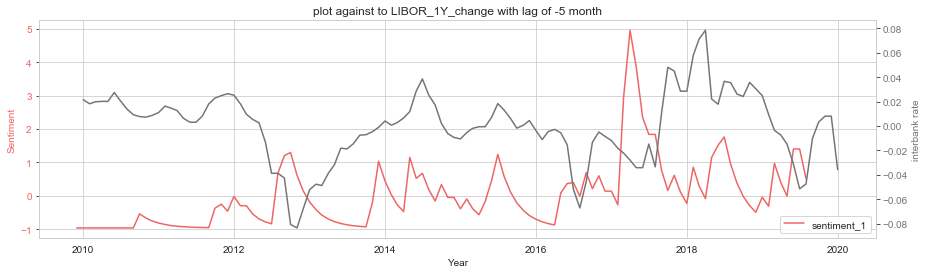

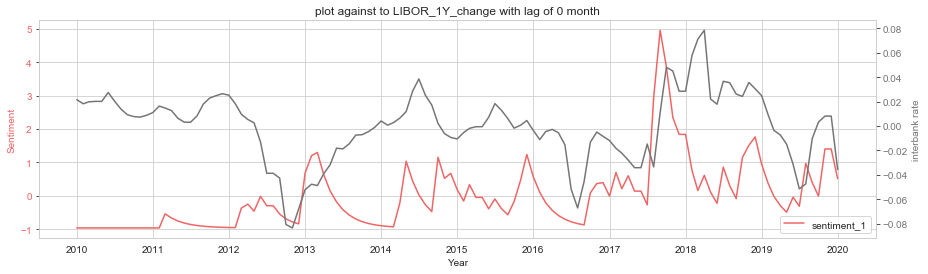

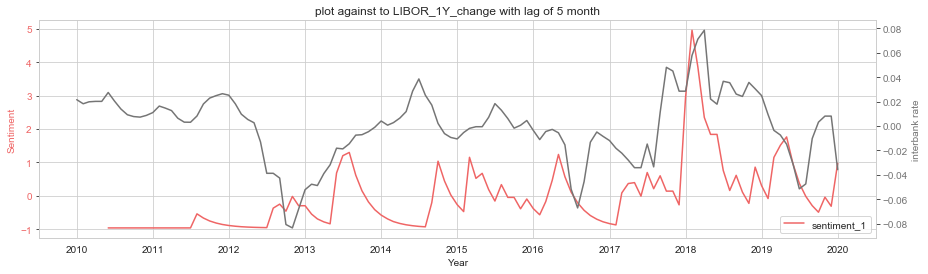

                  lag -5    lag -4    lag -3   lag -2    lag -1     lag 0  \
LIBOR_1Y_change -0.21132 -0.200107 -0.148317 -0.07637  0.020123  0.123028   

                    lag 1     lag 2     lag 3    lag 4     lag 5  
LIBOR_1Y_change  0.210358  0.223156  0.219368  0.19475  0.209113  


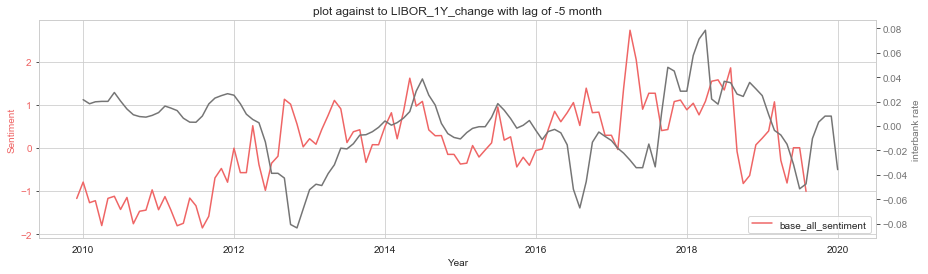

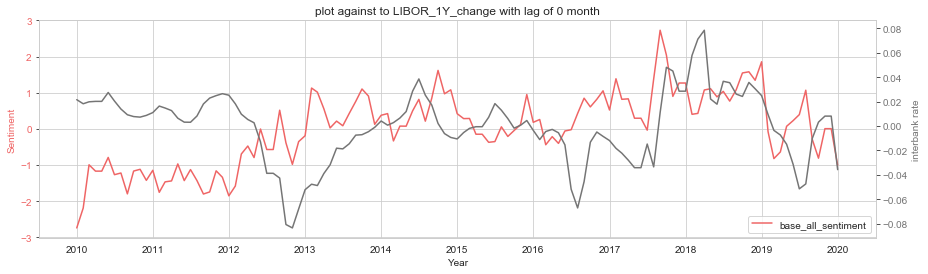

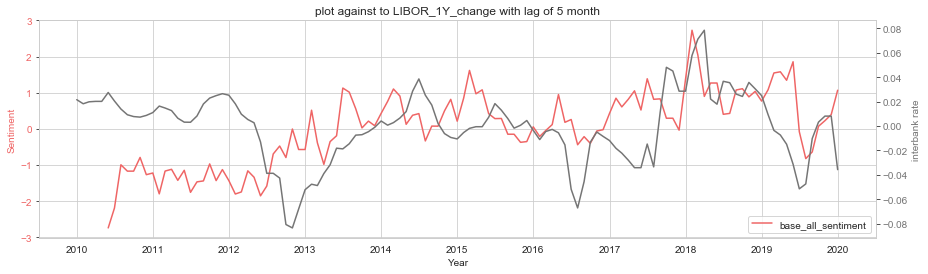

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change -0.159825 -0.164946 -0.119073 -0.086883 -0.071933 -0.033543   

                    lag 1     lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change -0.001247  0.031349  0.068578  0.078373  0.081996  


In [444]:
train_multiNB(merged_timeseries_labelled.loc[merged_timeseries_labelled.loc[:,'Type']=='Speech',:],end_date)

C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s
C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


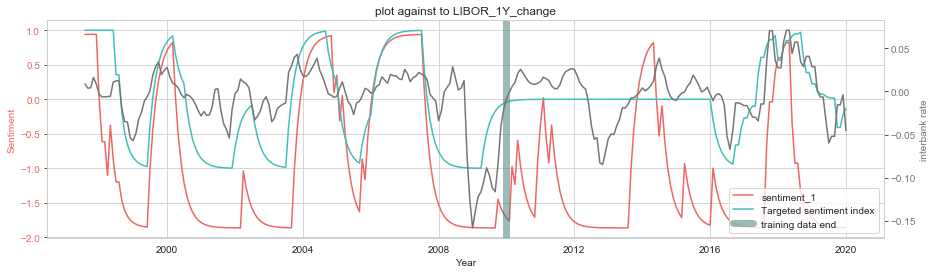

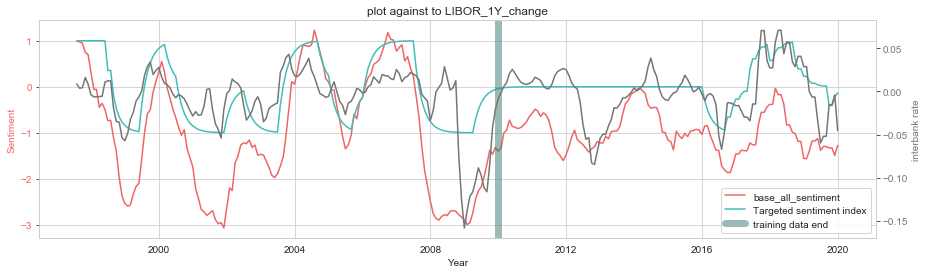

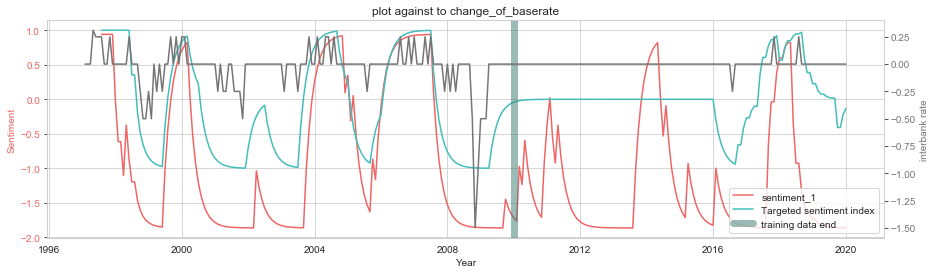

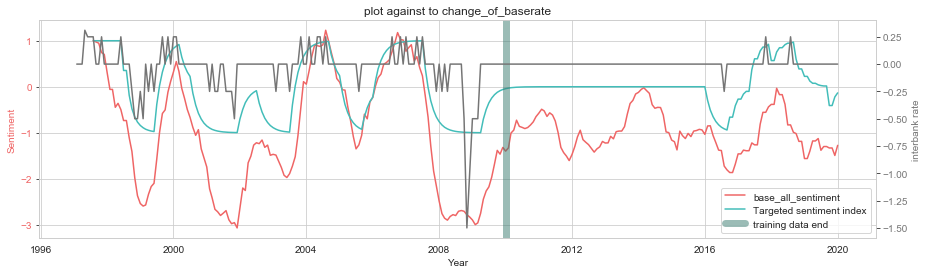

Correlation with Averaging
                 sentiment_1  base_all_sentiment
label_2             0.727926            0.844335
LIBOR_1Y_change     0.509654            0.518067
Interest_rate       0.325871            0.151492
change_of_rate      0.341435            0.340426
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.343224
base_all_sentiment         0.343224            1.000000


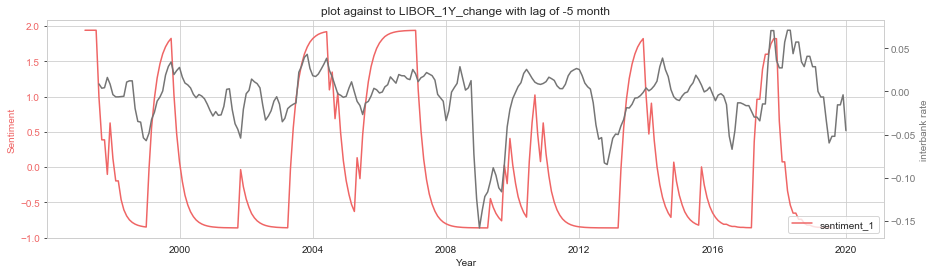

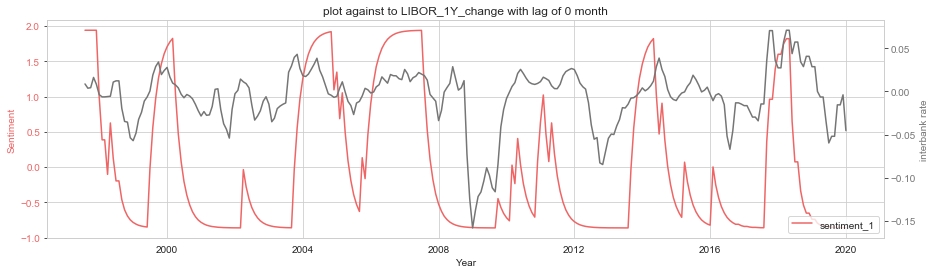

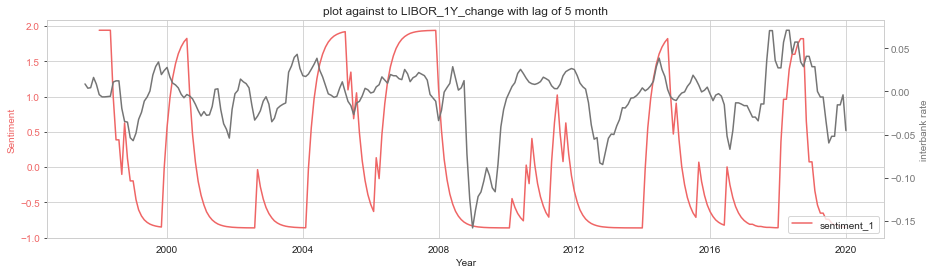

                   lag -5   lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.324593  0.38953  0.437944  0.477334  0.500055  0.509654   

                    lag 1     lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.497922  0.471757  0.438016  0.397249  0.361711  


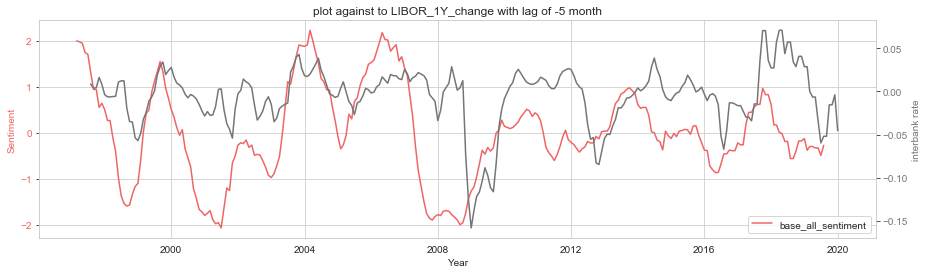

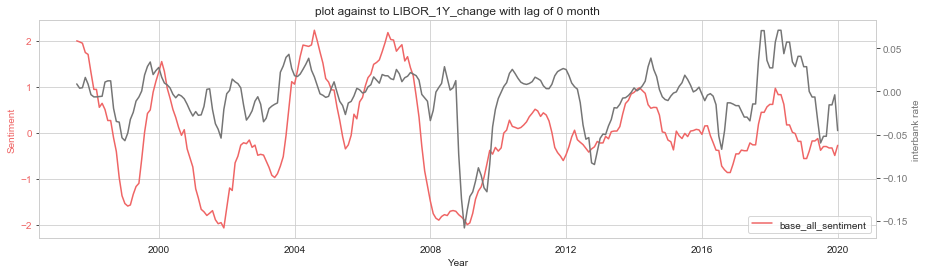

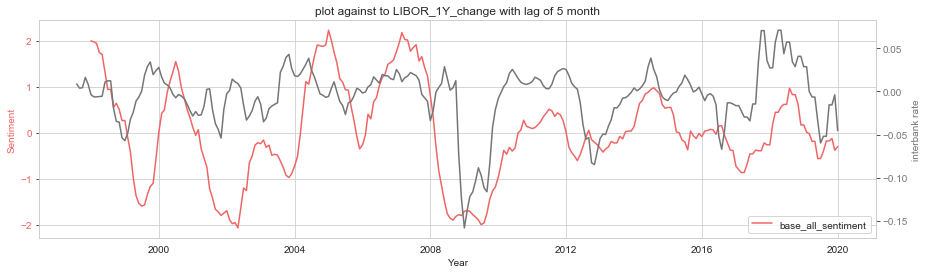

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.333859  0.404458  0.460793  0.501207  0.520801  0.518067   

                    lag 1     lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.501442  0.471651  0.436704  0.404773  0.380695  







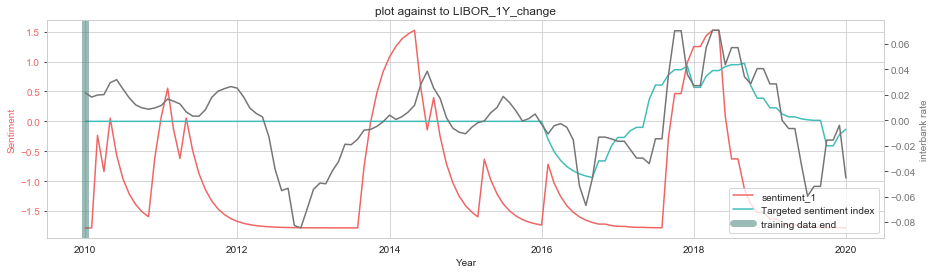

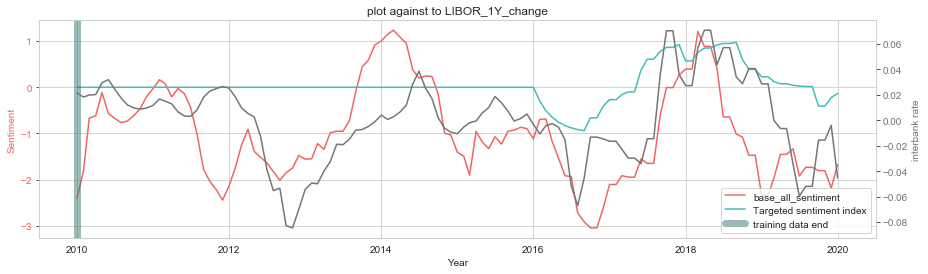

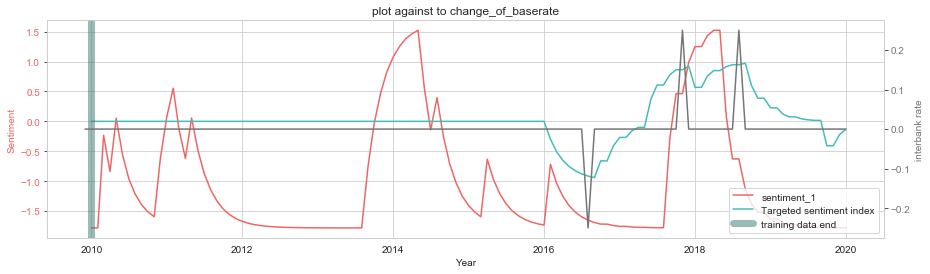

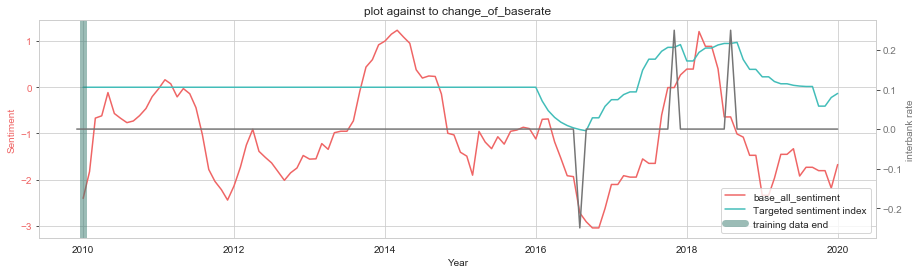

Correlation with Averaging
                 sentiment_1  base_all_sentiment
label_2             0.403606            0.440359
LIBOR_1Y_change     0.547348            0.481955
Interest_rate      -0.109315           -0.028509
change_of_rate      0.395630            0.328926
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.343224
base_all_sentiment         0.343224            1.000000


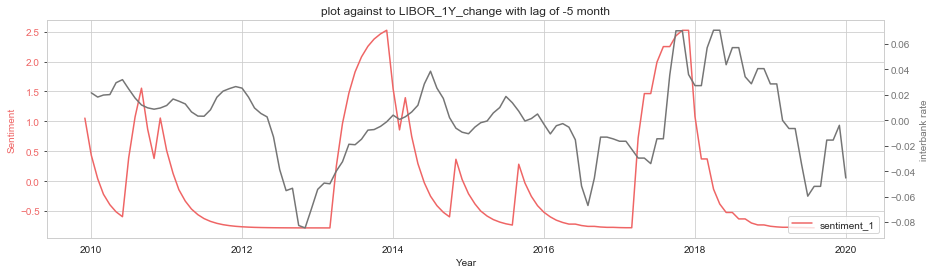

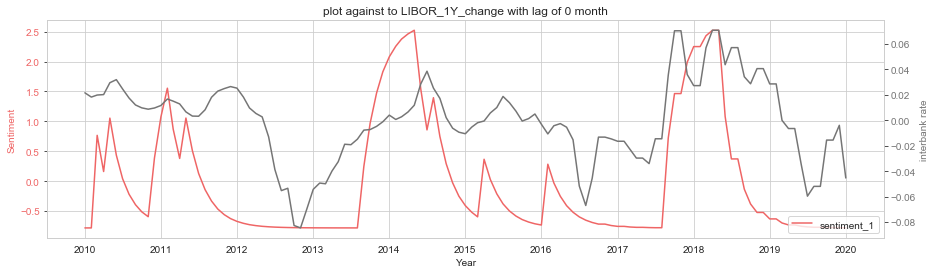

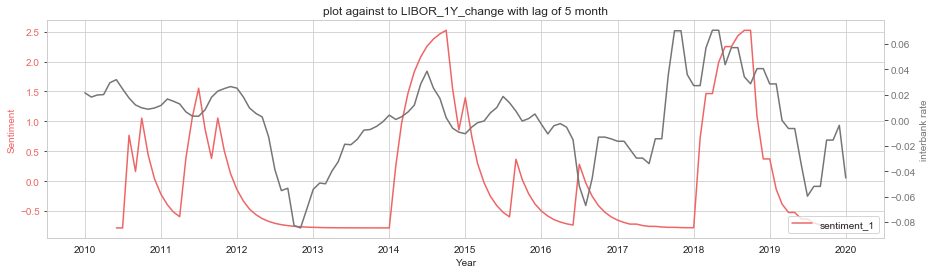

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.160272  0.253535  0.340227  0.429506  0.495255  0.547348   

                   lag 1    lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.56692  0.56677  0.554045  0.530215  0.506164  


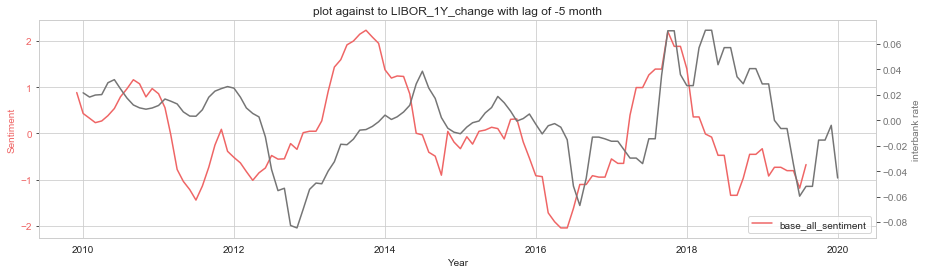

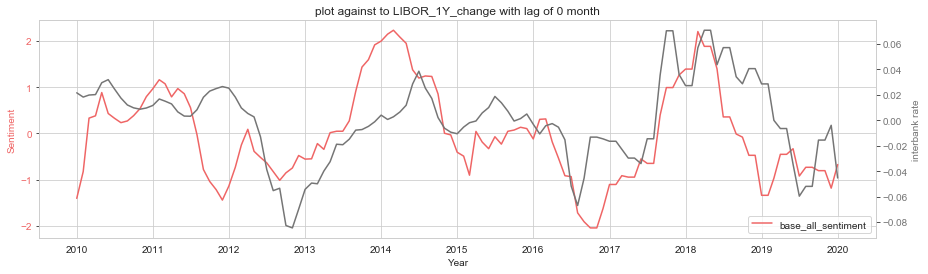

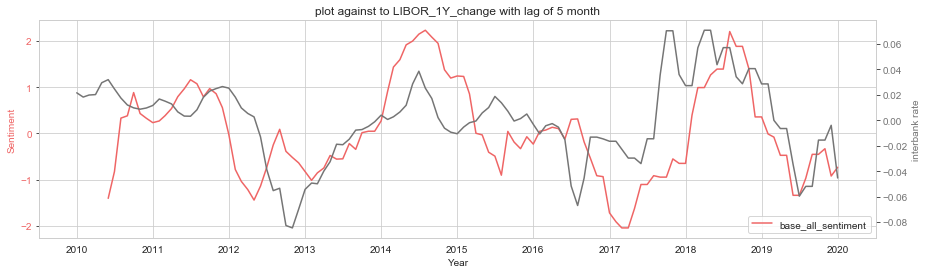

                   lag -5    lag -4    lag -3    lag -2    lag -1     lag 0  \
LIBOR_1Y_change  0.142518  0.251403  0.340731  0.409964  0.458227  0.481955   

                    lag 1    lag 2     lag 3     lag 4     lag 5  
LIBOR_1Y_change  0.497537  0.48771  0.466993  0.455097  0.451642  


In [445]:
train_multiNB(merged_timeseries_labelled.loc[merged_timeseries_labelled.loc[:,'Type']=='Minutes',:],end_date)

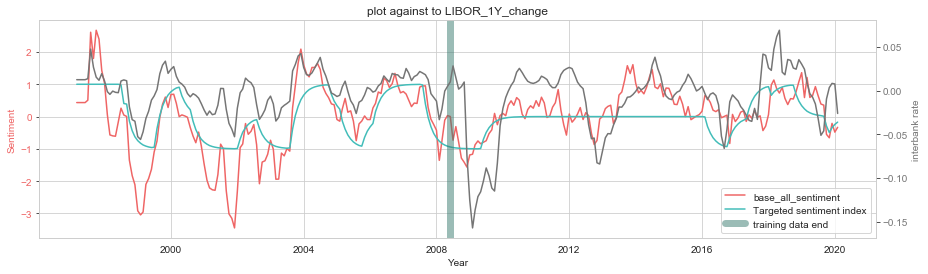

Correlation with Averaging
                 base_all_sentiment
label_2                    0.685230
LIBOR_1Y_change            0.509662
Interest_rate             -0.214512
change_of_rate             0.482841
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.335009
base_all_sentiment         0.335009            1.000000


In [181]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.svm import SVR
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor

end_date='2008-05-31'
merged_timeseries_labelled_rate = merged_timeseries_labelled.copy()
merged_dataset.loc[:,'LIBOR_1Y_change'] = [np.nan]+list((merged_dataset.LIBOR_1Y.values[1:] - merged_dataset.LIBOR_1Y.values[:-1])/merged_dataset.LIBOR_1Y.values[:-1])
merged_timeseries_labelled_rate = merged_timeseries_labelled_rate.join(merged_dataset.loc[:,'LIBOR_1Y_change'],how='inner').dropna()


X_train = merged_timeseries_labelled_rate.loc[:end_date,'cleaned string']
X_test = merged_timeseries_labelled_rate.loc[end_date:,'cleaned string']
y_train = merged_timeseries_labelled_rate.loc[:end_date,'LIBOR_1Y_change']
y_test = merged_timeseries_labelled_rate.loc[end_date:,'LIBOR_1Y_change']


text_clf = Pipeline([('vect', CountVectorizer()),
                     ('tfidf', TfidfTransformer()),
                     #('clf', RandomForestRegressor(n_estimators=10,random_state=0)),
                     ('clf', Ridge(alpha=0.5)),
                     ])



text_clf.fit(X_train, y_train)

predicted_train_prob = text_clf.predict(X_train)
predicted_test_prob = text_clf.predict(X_test)
merged_timeseries_labelled_rate.loc[:,'base_all_sentiment'] = list(predicted_train_prob)+list(predicted_test_prob)



result_NB,result_NB2 = rolling_averaging_ewm(merged_timeseries_labelled_rate.loc[:,['label_2','base_all_sentiment']])
result_NB.loc[:,'base_all_sentiment'] = (result_NB.loc[:,'base_all_sentiment']-result_NB.loc[:,'base_all_sentiment'].mean())/np.std(result_NB.loc[:,'base_all_sentiment'])
create_comparison_plot(result_NB,'base_all_sentiment',rate = 'LIBOR_1Y_change', end_date=end_date)
print('Correlation with Averaging')
print(result_NB.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment']])
print('Correlation No Averaging')
print(result_NB2.corr())


In [ ]:
# word_df = dictionary_model_97_15_merged[0].set_index('Entry')
# d1,d2,d3=[],[],[]
# for n,i in enumerate(vectorizer.get_feature_names()):
#     d1.append([text_clf.coef_[0][n],i,word_df.loc[i].values[0]])
#     d2.append([text_clf.coef_[1][n],i,word_df.loc[i].values[0]])
#     d3.append([text_clf.coef_[2][n],i,word_df.loc[i].values[0]])

In [183]:
merged_timeseries_labelled_rate

,title,N_topics,Type,label,label_2,cleaned,cleaned string,sentiment_1,sentiment_2,base_all_sentiment,LIBOR_1Y_change
1997-03-01,Speech by Edward George for the 3rd Euromoney ...,"[[Financial markets, One concern at the time w...",Speech,0,1,"[one, concern, time, face, global, capit, shor...",shortag strengthen remark someth worsen macro ...,-1,-0.038892,0.005807,0.012387
1997-07-01,Lord Mayors Banquet - speech by Edward George,"[[Financial markets, It operates with long and...",Speech,0,1,"[oper, long, unpredict, time, lag, necessarili...",lag strain upon principl technic implement pre...,1,0.159440,0.025449,0.056904
1997-07-01,The Sixteenth Mais Lecture - speech by Edward ...,"[[Financial markets, Sweeping generalisations ...",Speech,0,1,"[sweep, generalis, cours, alway, danger, parti...",danger away macro macro respond damag good lif...,-1,-0.015138,0.032292,0.056904
1997-08-01,Minutes of the MPC Meeting held on 5 and 6 Jun...,"[[Financial markets, Short-term interest rates...",Minutes,0,1,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,1,0.337077,0.010653,0.008657
1997-09-01,Minutes of the MPC Meeting held on 9 and 10 Ju...,"[[Financial markets, The estimated change in n...",Minutes,0,1,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,1,0.518462,0.034723,0.000265
...,...,...,...,...,...,...,...,...,...,...,...
2020-04-01,Bank Rate maintained at 01% - March 2020_1st,"[[Growth and inflation projections, The Bank o...",Minutes,0,0,"[bank, england, monetari, polici, committe, mp...",challeng respond sever disrupt contain evolv s...,-1,-0.368959,-0.019709,0.200617
2020-04-01,The grand unifying theory (and practice) of ma...,"[[Financial markets, Macroprudential policy is...",Speech,0,0,"[macroprudenti, polici, core, respons, central...",better improv improv prolong threaten crisi re...,-1,-0.554923,0.002681,0.200617
2020-04-01,Inflation and beliefs about inflation - speech...,"[[Financial markets, Precisely for that reason...",Speech,0,0,"[precis, reason, may, therefor, role, econom, ...",precis ensur disrupt damag offici fast centuri...,-1,-0.282737,-0.026675,0.200617
2020-05-01,Monetary policy during pandemics inflation bef...,"[[Financial markets, Second, the policy respon...",Speech,0,0,"[second, polici, respons, mpc, make, one, part...",ensur failur loss persist neg expenditur diffi...,-1,-0.253375,0.019961,-0.216137


## Step 3: word2vec representation

In [10]:
dataset = pd.read_hdf('cleaned_all.h5', key='cleaned_all')
word_list = pd.read_hdf('cleaned_all.h5', key='word_list').words.values
dataset.head()

,title,all_string,N_topics,Type,label,label_2,cleaned_filtered,cleaned_filtered_wordlsit,cleaned_all,cleaned_all_wordlsit,LIBOR_1Y_change
1997-03-01,Speech by Edward George for the 3rd Euromoney ...,honour invit open rd euromoney intern bond con...,"[[Financial markets, One concern at the time w...",Speech,0,1,"[one, concern, time, face, global, capit, shor...",shortag strengthen remark someth worsen macro ...,"[honour, invit, open, rd, euromoney, intern, b...",event financ better weak enjoy shortag strengt...,0.012387
1997-07-01,Lord Mayors Banquet - speech by Edward George,let begin congratul chancellor overwhelm elect...,"[[Financial markets, It operates with long and...",Speech,0,1,"[oper, long, unpredict, time, lag, necessarili...",lag strain upon principl technic implement pre...,"[let, begin, congratul, chancellor, overwhelm,...",banker challeng technic implement lag strain u...,0.056904
1997-07-01,The Sixteenth Mais Lecture - speech by Edward ...,delight invit deliv sixteenth mai lectur two t...,"[[Financial markets, Sweeping generalisations ...",Speech,0,1,"[sweep, generalis, cours, alway, danger, parti...",danger away macro macro respond damag good lif...,"[delight, invit, deliv, sixteenth, mai, lectur...",someth introduct danger away macro macro respo...,0.056904
1997-08-01,Minutes of the MPC Meeting held on 5 and 6 Jun...,Short-term interest rates expected over the ne...,"[[Financial markets, Short-term interest rates...",Minutes,0,1,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,0.008657
1997-09-01,Minutes of the MPC Meeting held on 9 and 10 Ju...,The estimated change in notes and coin in May ...,"[[Financial markets, The estimated change in n...",Minutes,0,1,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,0.000265


In [41]:
from gensim.models import Word2Vec
word2vec = Word2Vec(dataset['cleaned_filtered'], min_count=10)


In [42]:
def show_close_word(word_list,n):
    print(word_list[n])
    print(word2vec.wv.most_similar(word_list[n]))
    return None

In [43]:
from sklearn.manifold import TSNE
model_97_10_word2vec = dictionary_model_97_10_merged[0].copy()
model_97_10_word2vec.loc[:,'vector'] = model_97_10_word2vec.loc[:,'Entry'].apply(lambda x: word2vec[x])
uncomposed = np.array([i for i in model_97_10_word2vec.loc[:,'vector']])

tsne_model_en_2d = TSNE(perplexity=15, n_components=2, init='pca', n_iter=3500, random_state=32)
uncomposed = tsne_model_en_2d.fit_transform(uncomposed)

C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  This is separate from the ipykernel package so we can avoid doing imports until


In [44]:
model_97_10_word2vec.loc[:,'vector_x'] = [i[0] for i in uncomposed]
model_97_10_word2vec.loc[:,'vector_y'] = [i[1] for i in uncomposed]
model_97_10_word2vec = model_97_10_word2vec.set_index('Entry')
colors = ['#ef6565','#42bdb9']
colors = ['#ef6565' if i == 'Positive' else '#42bdb9' for i in model_97_10_word2vec.sentiment]

In [45]:
model_97_10_word2vec

,sentiment,vector,vector_x,vector_y
Entry,,,,
examin,Positive,"[0.43955314, 0.1443891, -0.66497946, 0.0991521...",8.543087,-9.797858
german,Positive,"[0.06923561, -0.3969735, 0.46533844, 0.4586122...",-1.399881,12.144945
smooth,Positive,"[-0.068000436, -0.29370934, 0.29645893, -0.584...",7.019006,0.927254
pension,Positive,"[1.0890621, -1.3575709, -0.25175384, 0.6911633...",-13.903734,-15.754080
pickup,Positive,"[0.7347977, -0.2047394, 0.51111525, -1.3856692...",2.794442,22.302628
...,...,...,...,...
weakest,Negative,"[0.2119038, -0.26864284, 0.14966738, -0.050156...",-3.667068,8.758601
weak,Negative,"[1.2922024, -0.22771676, -0.6455223, -1.271514...",3.974253,21.662291
worri,Negative,"[0.14719552, 0.06835055, -0.36851028, -0.61846...",8.411234,-3.367375


ValueError: 'c' argument has 293 elements, which is not acceptable for use with 'x' with size 776, 'y' with size 776.

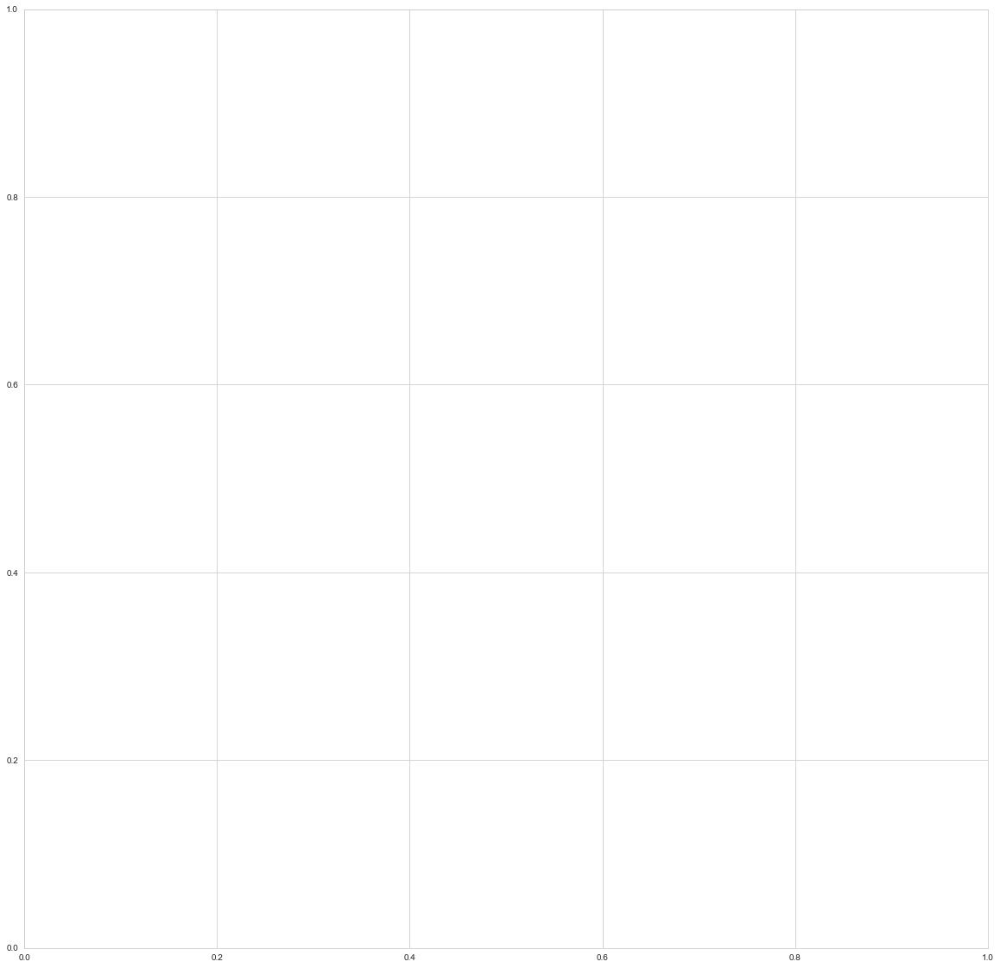

In [446]:
x = model_97_10_word2vec.loc[:,'vector_x'].values
y = model_97_10_word2vec.loc[:,'vector_y'].values
plt.figure(figsize = (20,20))
plt.scatter(x,y, c=colors,label=model_97_10_word2vec.loc[:,'sentiment'])
for i,word in enumerate(model_97_10_word2vec.index):
    plt.annotate(word, alpha=0.5, xy=(x[i], y[i]), xytext=(5, 2),textcoords='offset points', ha='right', va='bottom', size=12)


In [47]:
postive_mean = []
negative_mean = []
for i in model_97_10_word2vec.loc[model_97_10_word2vec.loc[:,'sentiment']=='Positive',:].index:
    postive_mean.append(word2vec[i])
    
for i in model_97_10_word2vec.loc[model_97_10_word2vec.loc[:,'sentiment']=='Negative',:].index:
    negative_mean.append(word2vec[i])
np.mean(postive_mean,axis=0)

C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:4: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  after removing the cwd from sys.path.
C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


array([ 0.136219  , -0.08357165, -0.01669835, -0.17771655,  0.00851446,
       -0.12703136,  0.04174177,  0.11351785, -0.05113257, -0.17758912,
        0.148824  ,  0.10782264, -0.02364634,  0.03321397, -0.20497999,
        0.00089716,  0.14513089, -0.0351543 ,  0.0815863 , -0.21562299,
        0.0074754 ,  0.07457103, -0.14760353,  0.01990828, -0.00247733,
       -0.15623596,  0.17639747, -0.16410597, -0.0082113 ,  0.14505014,
       -0.06685562,  0.16015765,  0.15901199, -0.03554586, -0.1828981 ,
        0.13313587, -0.00609921, -0.27020708, -0.09265675, -0.12866215,
       -0.08970864,  0.08102133,  0.04463709, -0.02612103, -0.03325019,
        0.05293712, -0.16441455, -0.20471442,  0.10389742,  0.05745959,
       -0.16890024,  0.01258292, -0.03207335,  0.04264235,  0.20966297,
       -0.16958183,  0.13740493,  0.14350426,  0.02353909,  0.12258644,
       -0.1806316 , -0.11611118,  0.07030413,  0.04974939, -0.03599917,
       -0.44095415, -0.00496359, -0.00564206,  0.19941477, -0.35

In [23]:
np.mean(negative_mean,axis=0)

array([ 8.49617124e-02, -1.30253941e-01,  5.99183738e-02, -3.39170992e-01,
       -2.51076430e-01, -2.55207568e-02,  1.56928822e-02, -1.55757964e-01,
       -1.52158797e-01, -1.68824121e-01,  6.40456676e-02, -4.21193838e-02,
       -1.81840554e-01, -2.35041216e-01, -1.62322134e-01,  1.53500438e-01,
        6.96907518e-03, -4.49106693e-02,  1.13190815e-01, -2.69017428e-01,
       -6.64191991e-02, -5.79584278e-02, -2.72907615e-01,  7.32877851e-02,
        5.76476417e-02, -1.72352651e-04,  3.46085787e-01, -2.29268700e-01,
        1.55039698e-01,  2.36988470e-01,  1.66469321e-01,  1.19677007e-01,
        2.87644148e-01, -1.76048592e-01, -1.22269932e-02, -7.84878898e-03,
        4.70457345e-01, -3.40344131e-01,  6.60042539e-02,  1.00760892e-01,
       -1.34904146e-01, -6.60070628e-02,  1.43841505e-01,  3.67552927e-03,
       -1.12295255e-01,  9.80964079e-02, -1.67933702e-01, -6.52881190e-02,
        3.44009161e-01,  6.24323525e-02, -2.86177903e-01, -8.66442099e-02,
       -4.28792574e-02,  

**Now try to ridge on word2vec representation**

In [48]:
print(model_97_10_word2vec.head())
dataset = pd.read_hdf('cleaned_all.h5', key='cleaned_all')
dataset = dataset.loc[dataset.loc[:,'cleaned_filtered_wordlsit']!='',:]
dataset.head()

        sentiment                                             vector  \
Entry                                                                  
examin   Positive  [0.43955314, 0.1443891, -0.66497946, 0.0991521...   
german   Positive  [0.06923561, -0.3969735, 0.46533844, 0.4586122...   
smooth   Positive  [-0.068000436, -0.29370934, 0.29645893, -0.584...   
pension  Positive  [1.0890621, -1.3575709, -0.25175384, 0.6911633...   
pickup   Positive  [0.7347977, -0.2047394, 0.51111525, -1.3856692...   

          vector_x   vector_y  
Entry                          
examin    8.543087  -9.797858  
german   -1.399881  12.144945  
smooth    7.019006   0.927254  
pension -13.903734 -15.754080  
pickup    2.794442  22.302628  


,title,all_string,N_topics,Type,label,label_2,cleaned_filtered,cleaned_filtered_wordlsit,cleaned_all,cleaned_all_wordlsit,LIBOR_1Y_change
1997-03-01,Speech by Edward George for the 3rd Euromoney ...,honour invit open rd euromoney intern bond con...,"[[Financial markets, One concern at the time w...",Speech,0,1,"[one, concern, time, face, global, capit, shor...",shortag strengthen remark someth worsen macro ...,"[honour, invit, open, rd, euromoney, intern, b...",event financ better weak enjoy shortag strengt...,0.012387
1997-07-01,Lord Mayors Banquet - speech by Edward George,let begin congratul chancellor overwhelm elect...,"[[Financial markets, It operates with long and...",Speech,0,1,"[oper, long, unpredict, time, lag, necessarili...",lag strain upon principl technic implement pre...,"[let, begin, congratul, chancellor, overwhelm,...",banker challeng technic implement lag strain u...,0.056904
1997-07-01,The Sixteenth Mais Lecture - speech by Edward ...,delight invit deliv sixteenth mai lectur two t...,"[[Financial markets, Sweeping generalisations ...",Speech,0,1,"[sweep, generalis, cours, alway, danger, parti...",danger away macro macro respond damag good lif...,"[delight, invit, deliv, sixteenth, mai, lectur...",someth introduct danger away macro macro respo...,0.056904
1997-08-01,Minutes of the MPC Meeting held on 5 and 6 Jun...,Short-term interest rates expected over the ne...,"[[Financial markets, Short-term interest rates...",Minutes,0,1,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,0.008657
1997-09-01,Minutes of the MPC Meeting held on 9 and 10 Ju...,The estimated change in notes and coin in May ...,"[[Financial markets, The estimated change in n...",Minutes,0,1,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,0.000265


In [49]:
def calculate_word_embedding(word2vec,i):
    if type(i)==str:
        i = i.split()
    result = []
    for word in i:
        if word in word2vec.wv.vocab:
            result.append(word2vec[word])
    return np.mean(result,axis=0)
word2vec = Word2Vec(dataset['cleaned_filtered'], min_count=2)
dataset_1 = np.array([calculate_word_embedding(word2vec,i) for i in dataset.cleaned_filtered])
dataset_2 = np.array([calculate_word_embedding(word2vec,i) for i in dataset.cleaned_filtered_wordlsit])
word2vec = Word2Vec(dataset['cleaned_all'], min_count=2)
dataset_3 = np.array([calculate_word_embedding(word2vec,i) for i in dataset.cleaned_all])
dataset_4 = np.array([calculate_word_embedding(word2vec,i) for i in dataset.cleaned_all_wordlsit])

C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


In [196]:
np.shape(dataset_1)

(1042, 100)

In [50]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.svm import SVR
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
import scipy.stats.mstats as ssm


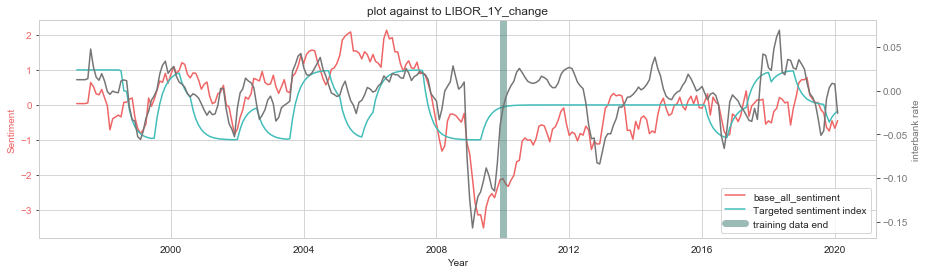

Correlation with Averaging
                 base_all_sentiment
label_2                    0.297947
LIBOR_1Y_change            0.506397
Interest_rate              0.497006
change_of_rate             0.212232
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.326863
base_all_sentiment         0.326863            1.000000


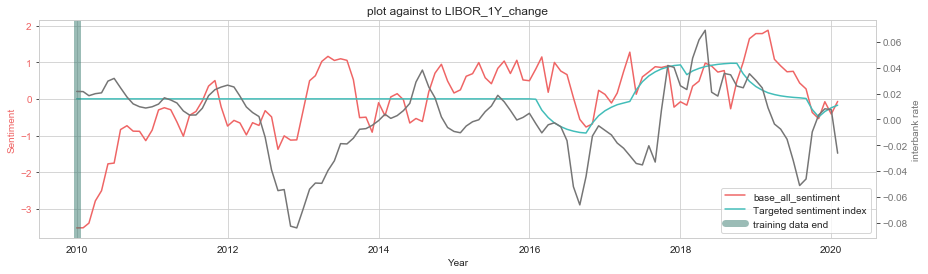

Correlation with Averaging
                 base_all_sentiment
label_2                    0.197041
LIBOR_1Y_change           -0.057264
Interest_rate              0.102383
change_of_rate             0.085591
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.326863
base_all_sentiment         0.326863            1.000000


In [51]:
def ML_method_on_word2vec(dataset_1,n,a=0.5):
    end_date = dataset.index[n]
    X_train = dataset_1[:n,:]
    X_test  = dataset_1[n:,:]
    y = ssm.winsorize(dataset.iloc[:,-1].values, limits=[0.05, 0.05])
    y_train = y[:n]
    y_test = y[n:]
    text_clf = Pipeline([
                         ('clf', Ridge(alpha=a)),
                         ])



    text_clf.fit(X_train, y_train)

    predicted_train_prob = text_clf.predict(X_train)
    predicted_test_prob = text_clf.predict(X_test)

    result = dataset.copy()
    result.iloc[:,-1] =ssm.winsorize(result.iloc[:,-1].values, limits=[0.05, 0.05])
    result.loc[:,'base_all_sentiment'] = list(predicted_train_prob)+list(predicted_test_prob)
    result_NB,result_NB2 = rolling_averaging_ewm(result.loc[:,['label_2','base_all_sentiment']])
    result_NB.loc[:,'base_all_sentiment'] = (result_NB.loc[:,'base_all_sentiment']-result_NB.loc[:,'base_all_sentiment'].mean())/np.std(result_NB.loc[:,'base_all_sentiment'])
    create_comparison_plot(result_NB,'base_all_sentiment',rate = 'LIBOR_1Y_change', end_date=end_date)
    print('Correlation with Averaging')
    print(result_NB.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment']])
    print('Correlation No Averaging')
    print(result_NB2.corr())
    result_NB,result_NB2 = rolling_averaging_ewm(result.loc[:,['label_2','base_all_sentiment']],start=end_date)
    result_NB.loc[:,'base_all_sentiment'] = (result_NB.loc[:,'base_all_sentiment']-result_NB.loc[:,'base_all_sentiment'].mean())/np.std(result_NB.loc[:,'base_all_sentiment'])
    create_comparison_plot(result_NB,'base_all_sentiment',rate = 'LIBOR_1Y_change', end_date=end_date)
    print('Correlation with Averaging')
    print(result_NB.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment']])
    print('Correlation No Averaging')
    print(result_NB2.corr())
    return None

ML_method_on_word2vec(dataset_1,500,0.5)

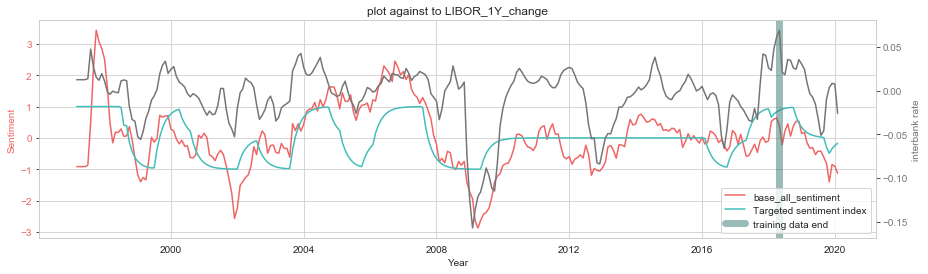

Correlation with Averaging
                 base_all_sentiment
label_2                    0.558500
LIBOR_1Y_change            0.586870
Interest_rate              0.301521
change_of_rate             0.306879
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.378552
base_all_sentiment         0.378552            1.000000


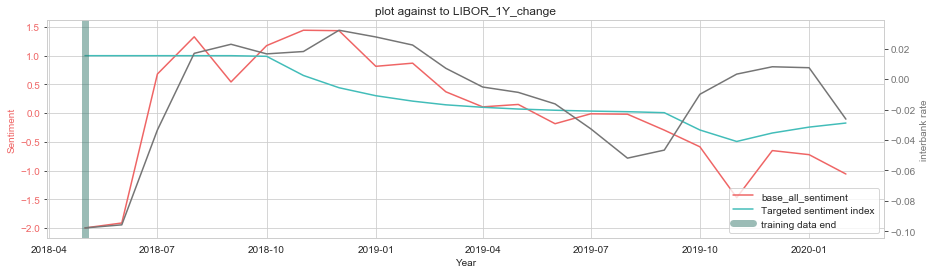

Correlation with Averaging
                 base_all_sentiment
label_2                    0.307753
LIBOR_1Y_change            0.713429
Interest_rate              0.224285
change_of_rate             0.289925
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.378552
base_all_sentiment         0.378552            1.000000


In [52]:
ML_method_on_word2vec(dataset_2,950,0.5)

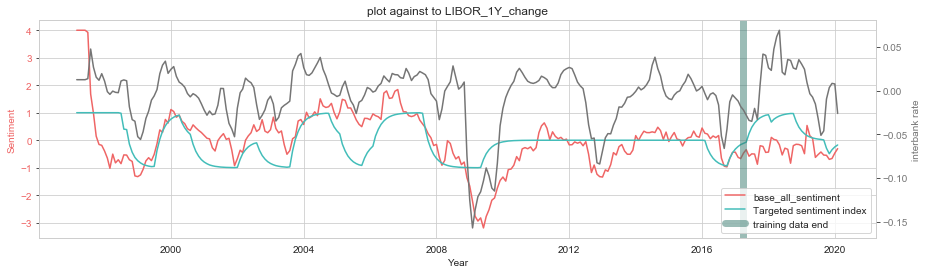

Correlation with Averaging
                 base_all_sentiment
label_2                    0.433462
LIBOR_1Y_change            0.602984
Interest_rate              0.385029
change_of_rate             0.353525
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.448849
base_all_sentiment         0.448849            1.000000


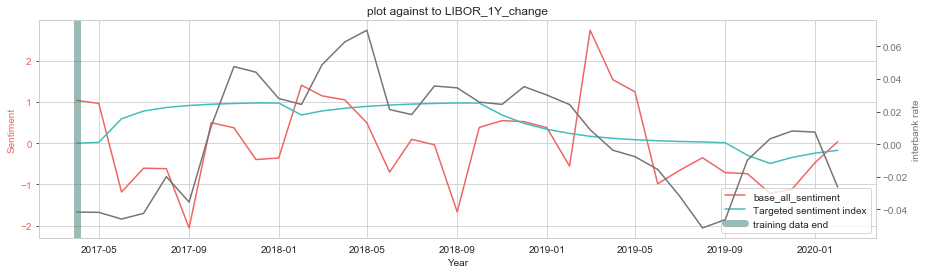

Correlation with Averaging
                 base_all_sentiment
label_2                    0.025056
LIBOR_1Y_change            0.273821
Interest_rate              0.017563
change_of_rate             0.040939
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.448849
base_all_sentiment         0.448849            1.000000


In [53]:
ML_method_on_word2vec(dataset_3,900)

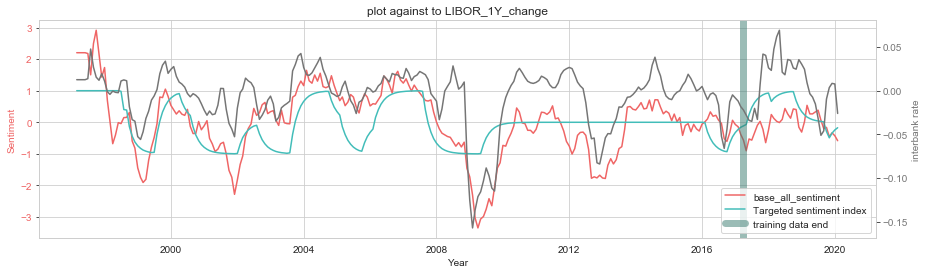

Correlation with Averaging
                 base_all_sentiment
label_2                    0.578731
LIBOR_1Y_change            0.705565
Interest_rate              0.353691
change_of_rate             0.378578
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.415707
base_all_sentiment         0.415707            1.000000


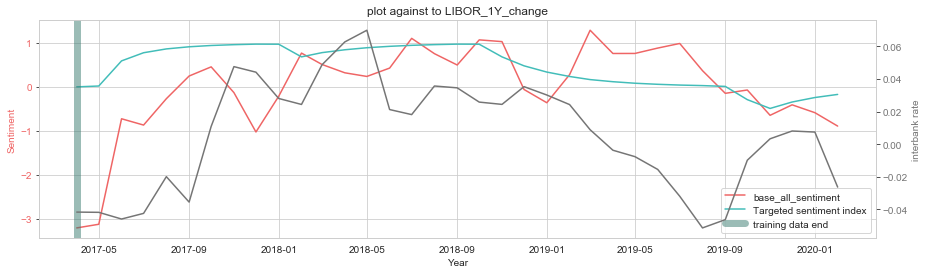

Correlation with Averaging
                 base_all_sentiment
label_2                    0.295441
LIBOR_1Y_change            0.374466
Interest_rate              0.435381
change_of_rate             0.076985
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.415707
base_all_sentiment         0.415707            1.000000


In [54]:
ML_method_on_word2vec(dataset_4,900)

**Including new words into the dictionary**

In [55]:
positive_list = model_97_10_word2vec.loc[model_97_10_word2vec.loc[:,'sentiment']=='Positive',:]
negative_list = model_97_10_word2vec.loc[model_97_10_word2vec.loc[:,'sentiment']=='Negative',:]

In [56]:
frequency_df = word_document_frequency_97_10_merged[1]['All']

In [90]:
def expanding_word2vec_dict(df,frequency_df):
    output = df.copy().set_index('Entry')
    for word in df.Entry:
        word_list = frequency_df.index
        k = 0 
        for word in [i[0] for i in word2vec.most_similar(positive=[word])]:
            if word in word_list:
                if frequency_df.loc[word,'p percentage no neutral'] > 0.55:
                    output.loc[word,'sentiment'] = 'Positive'
                    k+=1
                elif frequency_df.loc[word,'p percentage no neutral'] < 0.45:
                    output.loc[word,'sentiment'] = 'Negative'
                    k+=1
            if k>3:
                break
    return output.reset_index()

In [83]:
model_97_10_word2vec

,sentiment,vector,vector_x,vector_y
Entry,,,,
examin,Positive,"[0.43955314, 0.1443891, -0.66497946, 0.0991521...",8.543087,-9.797858
german,Positive,"[0.06923561, -0.3969735, 0.46533844, 0.4586122...",-1.399881,12.144945
smooth,Positive,"[-0.068000436, -0.29370934, 0.29645893, -0.584...",7.019006,0.927254
pension,Positive,"[1.0890621, -1.3575709, -0.25175384, 0.6911633...",-13.903734,-15.754080
pickup,Positive,"[0.7347977, -0.2047394, 0.51111525, -1.3856692...",2.794442,22.302628
...,...,...,...,...
attack,Negative,NaN,NaN,NaN
undu,Negative,NaN,NaN,NaN
overhang,Negative,NaN,NaN,NaN


In [89]:
#word_document_frequency_97_10_merged,dictionary_model_97_10_merged = training_dictionary_sentiment(training_data2,para_set=[[50,0.55,0.55],[30,0.55,0.55]],doc_name='9710_speech_minutes_second')
#dictionary_model_97_10_merged = remove_duplicates(dictionary_model_97_10_merged)
#model2 = create_probability_model(word_document_frequency_97_10_merged,dictionary_model_97_10_merged)
#(word_list_libor,word_list_baserate),(custome_base_all,custome_libor_all,custome_base_topic,custome_libor_topic)
dictionary_model_97_10_merged[0].set_index('Entry').reset_index()

,Entry,sentiment
0,examin,Positive
1,german,Positive
2,smooth,Positive
3,pension,Positive
4,pickup,Positive
...,...,...
288,weakest,Negative
289,weak,Negative
290,worri,Negative
291,worsen,Negative


In [95]:
dictionary_model_97_10_merged_expanded = (expanding_word2vec_dict(dictionary_model_97_10_merged[0],frequency_df),dictionary_model_97_10_merged[1],dictionary_model_97_10_merged[2],dictionary_model_97_10_merged[3])
model3 = create_probability_model(word_document_frequency_97_10_merged,dictionary_model_97_10_merged_expanded)

C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:6: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  


calculating all
calculating topic: Financial markets
calculating topic: The immediate policy decision
calculating topic: Growth and inflation projections
calculating topic: Money, credit, demand and output
calculating topic: Supply, costs and prices
calculating topic: The international economy
calculating dictionary sentiment


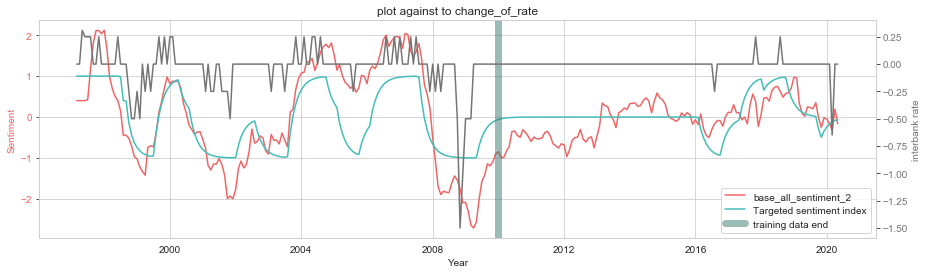

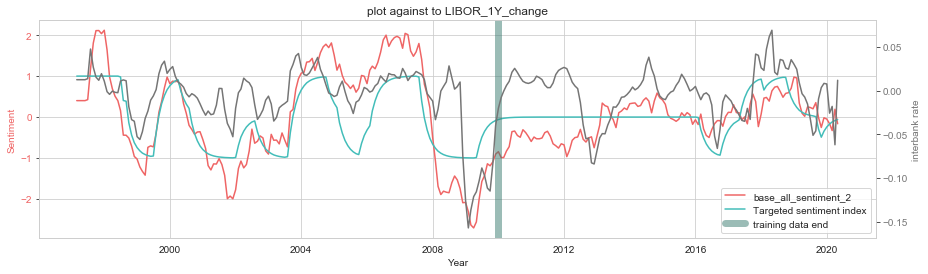

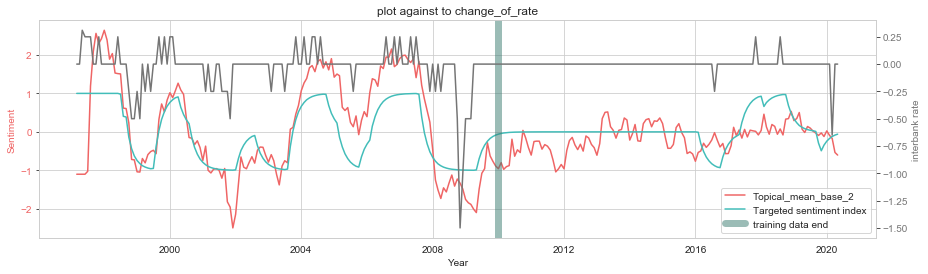

Correlation with Averaging
                 base_all_sentiment_2  Topical_mean_base_2  FS_sentiment
label_2                      0.756791             0.733437      0.416025
LIBOR_1Y_change              0.541009             0.447420      0.345964
Interest_rate                0.223438             0.319598      0.183623
change_of_rate               0.446707             0.365622      0.371591
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.294382
base_all_sentiment         0.294382            1.000000


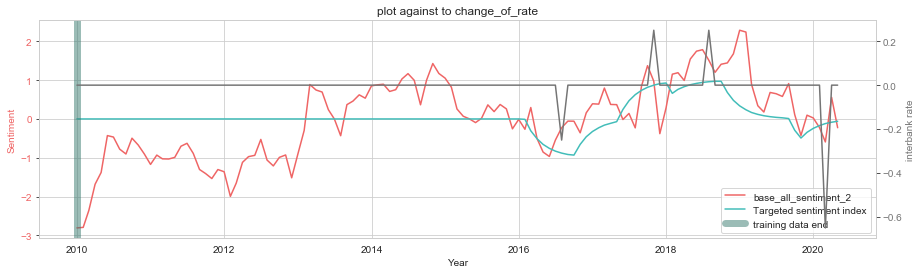

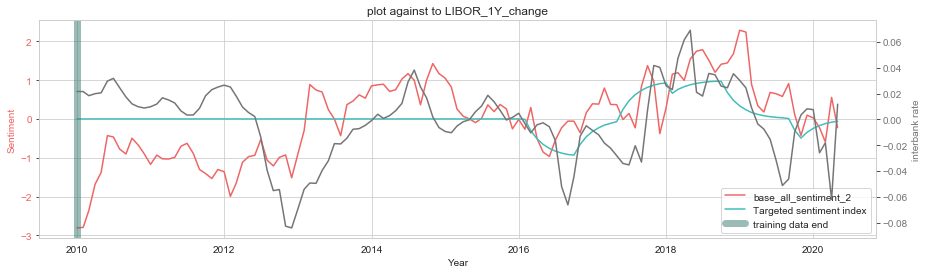

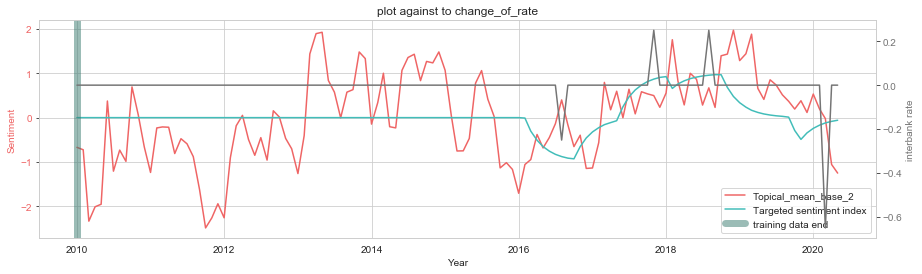

Correlation with Averaging
                 base_all_sentiment_2  Topical_mean_base_2  FS_sentiment
label_2                      0.404138             0.305103      0.181010
LIBOR_1Y_change              0.105015             0.008679     -0.054334
Interest_rate                0.112559             0.263899      0.012932
change_of_rate               0.121797             0.023757      0.015814
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment
LIBOR_1Y_change            1.000000            0.294382
base_all_sentiment         0.294382            1.000000


,label,label_2,base_all_sentiment,base_Financial markets_sentiment,base_The immediate policy decision_sentiment,base_Growth and inflation projections_sentiment,"base_Money, credit, demand and output_sentiment","base_Supply, costs and prices_sentiment",base_The international economy_sentiment,Topical_mean_base,FS_sentiment,LM_sentiment,LIBOR_1Y_change,Interest_rate,change_of_rate,base_all_sentiment_2,Topical_mean_base_2
label,1.000000,0.379603,-0.028158,0.039836,0.099240,-0.175701,0.255431,-0.068021,0.196947,0.031242,0.199694,-0.154466,0.412518,-0.257833,0.083936,-0.028158,0.031242
label_2,0.379603,1.000000,0.404138,0.319546,0.143431,0.246110,0.425895,-0.079151,0.432010,0.305103,0.181010,0.194132,0.439206,0.105995,0.234792,0.404138,0.305103
base_all_sentiment,-0.028158,0.404138,1.000000,0.625174,0.323749,0.719802,0.362698,-0.008526,0.295665,0.711829,0.636049,0.537056,0.105015,0.112559,0.121797,1.000000,0.711829
base_Financial markets_sentiment,0.039836,0.319546,0.625174,1.000000,-0.018553,0.513825,0.071874,-0.049434,0.279071,0.569537,0.400928,0.110091,-0.096626,0.177060,-0.013434,0.625174,0.569537
base_The immediate policy decision_sentiment,0.099240,0.143431,0.323749,-0.018553,1.000000,0.044509,0.111173,0.096597,-0.073434,0.527211,-0.060200,0.144202,0.219404,-0.020210,0.073813,0.323749,0.527211
base_Growth and inflation projections_sentiment,-0.175701,0.246110,0.719802,0.513825,0.044509,1.000000,0.248176,-0.153811,0.330050,0.557131,0.476114,0.375455,-0.139209,0.142346,0.067086,0.719802,0.557131
"base_Money, credit, demand and output_sentiment",0.255431,0.425895,0.362698,0.071874,0.111173,0.248176,1.000000,-0.038298,0.312806,0.440907,0.383763,0.443850,0.370880,0.152814,0.144009,0.362698,0.440907
"base_Supply, costs and prices_sentiment",-0.068021,-0.079151,-0.008526,-0.049434,0.096597,-0.153811,-0.038298,1.000000,0.233823,0.290571,0.031818,-0.123164,0.003327,0.363693,-0.096693,-0.008526,0.290571
base_The international economy_sentiment,0.196947,0.432010,0.295665,0.279071,-0.073434,0.330050,0.312806,0.233823,1.000000,0.394527,0.412528,0.278896,0.179489,0.359300,-0.040085,0.295665,0.394527
Topical_mean_base,0.031242,0.305103,0.711829,0.569537,0.527211,0.557131,0.440907,0.290571,0.394527,1.000000,0.421480,0.355705,0.008679,0.263899,0.023757,0.711829,1.000000


In [96]:
end_date, start_date='2009-12-31','1997-08-01'
sentiment_97_10_merged_prob_expanded = result_dictionary_sentiment_prob(model3,interested_topics,merged_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob_expanded,end ='2020-06-28')
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment_2','Topical_mean_base_2','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

end_date, start_date='2009-12-31','1997-08-01'
#sentiment_97_10_merged_prob = result_dictionary_sentiment_prob(model2,interested_topics,merged_timeseries_labelled)
result,result2 = rolling_averaging_ewm(sentiment_97_10_merged_prob_expanded,start=end_date,end ='2020-06-28')
visualise_prob_model(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment_2','Topical_mean_base_2','FS_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

# Appendix:
## A.1: topical distribution of speech & minutes and its evolvement over time

In [223]:
from gensim.models.ldamodel import LdaModel
from gensim.models import CoherenceModel
from gensim.models import TfidfModel
from gensim.models.ldamulticore import LdaMulticore
from gensim.models import CoherenceModel
from gensim import corpora
from gensim.models import TfidfModel
import multiprocessing
num_cores = multiprocessing.cpu_count() 


''' using parallel joblist'''
from joblib import Parallel, delayed
from tqdm import tqdm



# compute coherence
def calculate_coherence(corpus,dictionary,n_topics):
    lda = LdaModel(corpus, num_topics = n_topics, id2word = dictionary, passes=10)
    cohm = CoherenceModel(model=lda, corpus=corpus, dictionary=dictionary, coherence='u_mass')
    coh = cohm.get_coherence()
    return coh



'''
All the text documents combined is known as the corpus. To run any mathematical model on text corpus, it is a good practice to convert it into a matrix representation. LDA model looks for repeating term patterns in the entire DT matrix. Python provides many great libraries for text mining practices, “gensim” is one such clean and beautiful library to handle text data. It is scalable, robust and efficient. Following code shows how to convert a corpus into a document-term matrix.
'''
def prepare_corpus(doc_clean):
    """
    Input  : clean document
    Purpose: create term dictionary of our courpus and Converting list of documents (corpus) into Document Term Matrix
    Output : term dictionary and Document Term Matrix
    """
    # Creating the term dictionary of our courpus, where every unique term is assigned an index. dictionary = corpora.Dictionary(doc_clean)
    dictionary = corpora.Dictionary(doc_clean)
    # Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
    doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_clean]
    # generate LDA model
    return dictionary,doc_term_matrix
def topic_assignment(model,corps):
    a = model.get_document_topics(corps)
    a.sort(key=lambda x:-x[1])
    return a[0][0]

In [207]:



def filter_para(paragraph_list):                                  
    paragraph_list = [i for i in paragraph_list if i != '']
    for n in range(len(paragraph_list)-1,-1,-1):
        if 'were present:' in paragraph_list[n]:
            paragraph_list = paragraph_list[:n]
    return paragraph_list

def clean_text(file):
    #file = 'Minutes of the MPC Meeting held on 12 and 13 January 2000_1st.docx'
    document = docx.Document("./scripter/converted_files/{}/{}".format(folder,file))
    Document_list = []   # each element represent one heading (section)
    paragraph_list = []  # each element represent one paragraph in each section
    start_record = False
    force_stop = False

    if sum(['Heading' in para.style.name for para in document.paragraphs])>=2:
        for para in document.paragraphs:
            if 'Heading' in para.style.name and force_stop == False:
                if 'ANNEX:' in para.text and start_record==True:   
                    force_stop = True

                elif start_record == False:
                    paragraph_list.append(para.text)
                    start_record = True

                elif start_record == True: 
                    Document_list.append(filter_para(paragraph_list))
                    paragraph_list = [para.text]

            elif para.style.name in ['List Paragraph','Body Text'] and start_record == True and force_stop == False:
                if len(para.text.split())>=4:
                    paragraph_list.append(re.sub(r'[0-9]+', '',re.sub(r'[^\x00-\x7F]+',' ',para.text.replace('\uf0be','').replace('\t','').replace("\'","'"))))

    Document_list.append(filter_para(paragraph_list))
    try:
        doc2 = []
        for i in Document_list:
            doc2.append(i)
            if 'immediate policy decision' in i[0]:
                break
        Document_list = [i for n,i in enumerate(doc2) if len(i)>=3 or n>=3]
    except:
        Document_list = [i for n,i in enumerate(Document_list) if len(i)>=3 or n>=3]
    return Document_list

def encode_doc_minutes(Document_list):
    return '##NewTopic##'.join(['##NewPara##'.join(i) for i in Document_list])

def decode_doc_minutes(Doc_string):
    return [i.split('##NewPara##') for i in Doc_string.split('##NewTopic##')]

def load_up_from_cleaned_minutes():
    MPC_minutes = pd.read_excel('./scripter/cleaned_dataset/MPC_minutes.xlsx')
    file_list = os.listdir("./scripter/cleaned_dataset/Minutes_MPC")
    for n,file in enumerate(file_list):
        text_file = open("./scripter/cleaned_dataset/Minutes_MPC/{}".format(file), "r").read()
        MPC_minutes.loc[MPC_minutes['title']==file[:-4],'document_string'] = text_file
    return MPC_minutes
def write_file(Document_list,folder,file):
    Word_set = encode_doc_minutes(Document_list)
    text_file = open("./scripter/cleaned_dataset/{}/{}.txt".format(folder,file[:-5]), "w")
    text_file.write(Word_set)
    text_file.close()    
    return None
    
def show_section_name(document_list):
    return [[k[0] for k in i] for i in document_list]

def show_unique_section_name(document_list):
    result = {}
    for i in document_list:
        for k in i:
            if k[0] not in result:
                result[k[0]]=1
            else:
                result[k[0]]+=1
    return {k: v for k, v in sorted(result.items(), key=lambda item: -item[1])}



def rule_for_merge(list_of_names,target_name,document_list):
    new_document_list = document_list.copy()
    list_of_names = list_of_names+[target_name]
    for n,document in enumerate(document_list):
        new_document = []
        merged_paragraph = [target_name]
        for paragraph in document:
            if paragraph[0] not in list_of_names:
                new_document.append(paragraph)
            else:
                merged_paragraph = merged_paragraph + paragraph[1:]
        if merged_paragraph!=[target_name]:
            new_document.append(merged_paragraph)
        new_document_list[n] = new_document
    return new_document_list

def rule_for_replace(dict1,document_list):
    for orignal_name in dict1.keys():
        target_name = dict1[orignal_name]
        for n,document in enumerate(document_list):
            for k,paragraph in enumerate(document):
                if paragraph[0] == orignal_name:
                    document_list[n][k][0]= target_name
    return document_list

def remove_topics(x):
    x = decode_doc_minutes(x)
    result =[]
    for i in x:
        result += i[1:]
    return result

def unstructured_speech_language(string):
    string1 = str(string).split(' ###newline### ')
    doc_list = []
    for string in string1:
        doc_list += [i for i in string.split('. ') if len(i.split())>=5 and 'thank' not in i.lower() and 'grate' not in i.lower()  and 'gratitude' not in i.lower() ]
    return doc_list



In [201]:
black_list = ['These are the minutes of the special Monetary Policy Committee meeting held on 8 October 2008.',
             'MINUTES OF THE SPECIAL MONETARY POLICY COMMITTEE MEETING HELD ON 18 SEPTEMBER 2001',
             'These are the Minutes of the special Monetary Policy Committee meeting held on 18 September 2001.',
             'Minutes of the special Monetary Policy Committee meeting on 19 March 2020 and the Monetary Policy Committee meeting ending on 25 March 2020']

all_minutes_cleaned = load_up_from_cleaned_minutes()
all_minutes_cleaned.loc[:,'N_topics'] = [len(decode_doc_minutes(i)) for i in all_minutes_cleaned.document_string]
all_minutes_cleaned = all_minutes_cleaned.loc[all_minutes_cleaned['N_topics']>=2,:]
all_minutes_cleaned.loc[:,'unstructured_string'] = all_minutes_cleaned.loc[:,'document_string'].apply(lambda x: remove_topics(x))
all_minutes_cleaned.head()


,Unnamed: 0,title,link,date,tag,content,download,document_string,N_topics,unstructured_string
0,0,Bank Rate maintained at 01% - May 2020_1st,https://www.bankofengland.co.uk/monetary-polic...,07 May 2020,// News // Monetary Policy Committee (MPC),NaN,https://www.bankofengland.co.uk/-/media/boe/fi...,"Monetary Policy Summary, May 2020##NewPara##Au...",7,[Authorities around the world are taking actio...
1,1,Bank Rate maintained at 01% - March 2020_1st,https://www.bankofengland.co.uk/monetary-polic...,26 March 2020,// News // Monetary Policy Committee (MPC),NaN,https://www.bankofengland.co.uk/-/media/boe/fi...,"Monetary Policy Summary, Monetary Policy Commi...",9,[The Bank of England s Monetary Policy Committ...
2,2,Minutes of the special Monetary Policy Committ...,https://www.bankofengland.co.uk/monetary-polic...,13 March 2020,// News // Monetary Policy Committee (MPC),NaN,https://www.bankofengland.co.uk/-/media/boe/fi...,Monetary and financial conditions##NewPara##Si...,4,"[Since the January MPC meeting, risk appetite ..."
3,3,Bank Rate maintained at 075% - January 2020_1st,https://www.bankofengland.co.uk/monetary-polic...,30 January 2020,// News // Monetary Policy Committee (MPC),NaN,https://www.bankofengland.co.uk/-/media/boe/fi...,"Monetary Policy Summary, January 2020##NewPara...",6,[The Bank of England s Monetary Policy Committ...
4,4,Bank Rate maintained at 075% - December 2019_1st,https://www.bankofengland.co.uk/monetary-polic...,19 December 2019,// News // Monetary Policy Committee (MPC),NaN,https://www.bankofengland.co.uk/-/media/boe/fi...,"Monetary Policy Summary, December 2019##NewPar...",6,[The Bank of England s Monetary Policy Committ...


In [208]:
#MPC_speech = load_up_from_cleaned_speech()
MPC_speech_cleaned = MPC_speech.copy()
MPC_speech_cleaned.loc[:,'unstructured_string'] = MPC_speech_cleaned.loc[:,'document_string'].apply(lambda x: unstructured_speech_language(x))
MPC_speech_cleaned.head()

,Unnamed: 0,title,link,date,tag,document_string,unstructured_string
0,0,Covid-19 and monetary policy - speech by Micha...,https://www.bankofengland.co.uk/speech/2020/sp...,28 May 2020,// Speech // Michael Saunders,The views expressed here are not necessarily ...,[ The views expressed here are not necessarily...
1,1,Monetary policy and the Bank of England’s bala...,https://www.bankofengland.co.uk/speech/2020/ge...,23 April 2020,// Speech // Gertjan Vlieghe,"I would like to thank Rodrigo Guimaraes, Lenn...","[ The Covid- pandemic is, first and foremost, ..."
2,2,Monetary policy during pandemics inflation bef...,https://www.bankofengland.co.uk/speech/2020/si...,16 April 2020,// Speech // Silvana Tenreyro,The views are not necessarily those of the Ba...,[ The views are not necessarily those of the B...
3,3,The grand unifying theory (and practice) of ma...,https://www.bankofengland.co.uk/speech/2020/ma...,05 March 2020,// Speech // Mark Carney,"I would like to thank Daisy McGregor, Nicola ...",[ We covet its neat equations and crave its de...
4,4,Inflation and beliefs about inflation - speech...,https://www.bankofengland.co.uk/speech/2020/be...,04 March 2020,// Speech // Ben Broadbent,I ve received helpful comments from colleague...,[ I ve received helpful comments from colleagu...


In [218]:
df1 =  all_minutes_cleaned.loc[:,['date','unstructured_string']]
df1.loc[:,'type'] = 'minutes'
df2 =  MPC_speech_cleaned.loc[:,['date','unstructured_string']]
df2.loc[:,'type'] = 'speech'
merged_unstructured_dataset = pd.concat([df1,df2]).set_index('date')
merged_unstructured_dataset.index = pd.DatetimeIndex(merged_unstructured_dataset.index)
merged_unstructured_dataset.sort_index()
all_sentences = []
for i in merged_unstructured_dataset.unstructured_string:
    all_sentences+=i

In [225]:
BOE_corpus = preprocess_data(all_sentences)
BOE_dictionary, BOE_corpus =  prepare_corpus(BOE_corpus)
tfidf = TfidfModel(BOE_corpus)
corpus_tfidf = tfidf[BOE_corpus]


100%|██████████| 35/35 [38:16<00:00, 65.63s/it] 

100%|██████████| 35/35 [45:06<00:00, 77.34s/it]


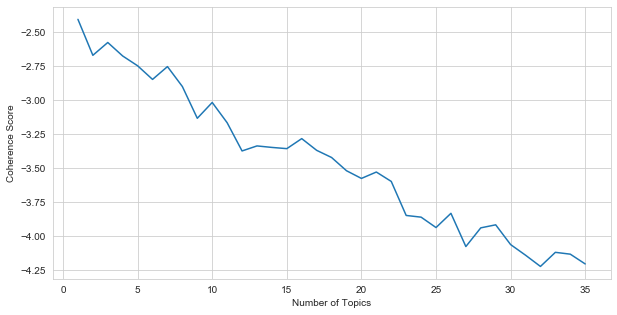

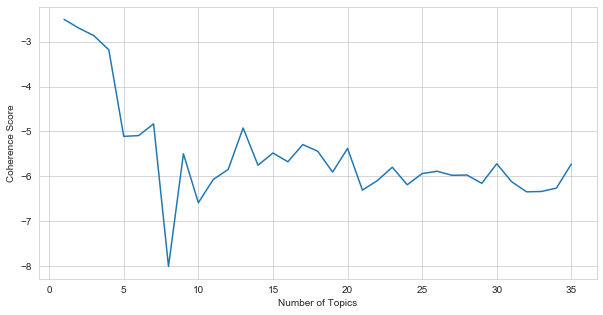

In [226]:
num_cores = multiprocessing.cpu_count() 
BOE_coherence = Parallel(n_jobs=num_cores)(delayed(calculate_coherence)(BOE_corpus,BOE_dictionary,i) for i in tqdm(range(1,36)))
# visualize coherence
plt.figure(figsize=(10,5))
plt.plot(range(1,36),BOE_coherence)
plt.xlabel("Number of Topics")
plt.ylabel("Coherence Score");


BOE_coherence_2 = Parallel(n_jobs=num_cores)(delayed(calculate_coherence)(corpus_tfidf,BOE_dictionary,i) for i in tqdm(range(1,36)))
# visualize coherence
plt.figure(figsize=(10,5))
plt.plot(range(1,36),BOE_coherence_2)
plt.xlabel("Number of Topics")
plt.ylabel("Coherence Score");

In [ ]:
BOE_lda = LdaMulticore(corpus=BOE_corpus, num_topics = 7, id2word = BOE_dictionary, passes=10,workers=num_cores-1)

In [244]:
minutes_sentences = []
speech_sentences = []
for i in merged_unstructured_dataset.loc[merged_unstructured_dataset.loc[:,'type']=='minutes','unstructured_string']:
    minutes_sentences+=i
for i in merged_unstructured_dataset.loc[merged_unstructured_dataset.loc[:,'type']=='speech','unstructured_string']:
    speech_sentences+=i    

BOE_minutes_corpus = preprocess_data(minutes_sentences)
BOE_minutes_dictionary, BOE_minutes_corpus =  prepare_corpus(BOE_minutes_corpus)
BOE_speech_corpus = preprocess_data(speech_sentences)
BOE_speech_dictionary, BOE_speech_corpus =  prepare_corpus(BOE_speech_corpus)

In [ ]:
def visualise_lda(BOE_lda,n_words = 15):

    top_words = [[word for word,_ in BOE_lda.show_topic(topic_id, topn=n_words)] for topic_id in range(BOE_lda.num_topics)]
    top_betas = [[beta for _,beta in BOE_lda.show_topic(topic_id, topn=n_words)] for topic_id in range(BOE_lda.num_topics)]


    for i in range(7):
        plt.figure(figsize=(10,4))
        ax = plt.subplot(1,1,1)
        plt.barh(range(n_words), top_betas[i][:n_words], align='center',color='blue', ecolor='black')
        ax.invert_yaxis()
        ax.set_yticks(range(n_words))
        ax.set_yticklabels(top_words[i][:n_words])
        plt.title("Topic "+str(i))
        plt.show()
    return None

def count_topics(data,BOE_speech_lda):
    data = preprocess_data(data)
    _, corpus =  prepare_corpus(data)
    corpus_tfidf = TfidfModel(corpus)[corpus]
    result = np.array([0 for i in range(7)])
    for n,sentence in enumerate(corpus_tfidf):
        a = BOE_speech_lda.get_document_topics(sentence)
        a.sort(key=lambda x:-x[1])
        if a[0][1]>= 0.6:
            result[a[0][0]]+=1
    return result 

def count_topics_prob(data,BOE_speech_lda):
    data = preprocess_data(data)
    _, corpus =  prepare_corpus(data)
    corpus_tfidf = TfidfModel(corpus)[corpus]
    result = np.array([0.0 for i in range(7)])
    for n,sentence in enumerate(corpus_tfidf):
        a = BOE_speech_lda.get_document_topics(sentence)
        result+=np.array([i[1] for i in a])
    return result 


def visualize_topic_distribution(speech_dataset):
    from scipy.stats import entropy
    lda_topics = ['0','1','2','3','4','5','6']
    df = speech_dataset.copy().loc[:,'topics']
    df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
    df = df.groupby(df.index).apply(lambda x: np.sum(x)/np.sum(np.sum(x)))
    
    
    plt.figure(figsize=(10,5))
    plt.stackplot(pd.to_datetime(df.index),[i[0] for i in df],[i[1] for i in df],[i[2] for i in df],
                  [i[3] for i in df],[i[4] for i in df],[i[5] for i in df],[i[6] for i in df],
                  labels=lda_topics)
    plt.legend()
    plt.title('topic assignment')
    plt.show()
    
    df = speech_dataset.copy().loc[:,'topics']
    df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
    df = df.groupby(df.index).apply(lambda x: entropy(np.sum(x)/np.sum(np.sum(x))))
    
    plt.figure(figsize=(10,5))
    plt.plot(pd.to_datetime(df.index),df.values)
    plt.title('topic assignment entropy')
    plt.show()    
    
    
    
    
    df = speech_dataset.copy().loc[:,'topics_dis']
    df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
    df = df.groupby(df.index).apply(lambda x: np.sum(x)/np.sum(np.sum(x)))

    plt.figure(figsize=(10,5))
    plt.stackplot(pd.to_datetime(df.index),[i[0] for i in df],[i[1] for i in df],[i[2] for i in df],
                  [i[3] for i in df],[i[4] for i in df],[i[5] for i in df],[i[6] for i in df],
                  labels=lda_topics)
    plt.legend()
    plt.title('topic assignment')
    plt.show()
    
    
    df = speech_dataset.copy().loc[:,'topics_dis']
    df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
    df = df.groupby(df.index).apply(lambda x: entropy(np.sum(x)/np.sum(np.sum(x))))
    
    plt.figure(figsize=(10,5))
    plt.plot(pd.to_datetime(df.index),df.values)
    plt.title('topic assignment entropy')
    plt.show()    
    
    
    return None

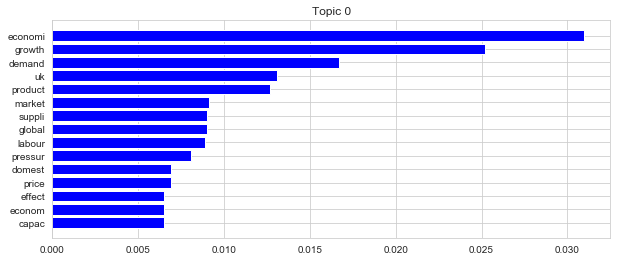

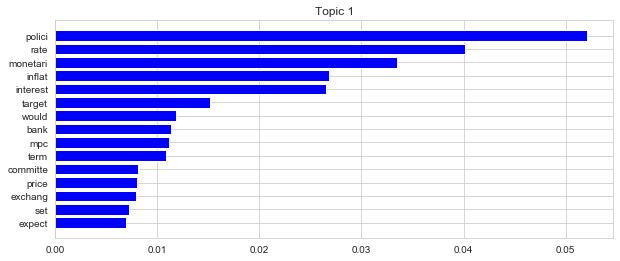

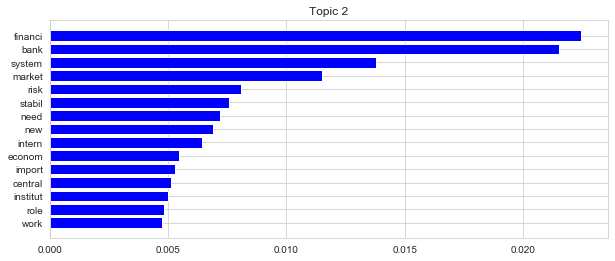

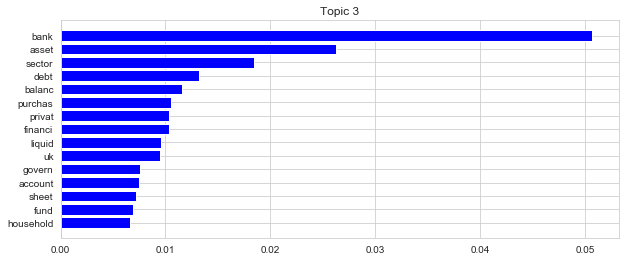

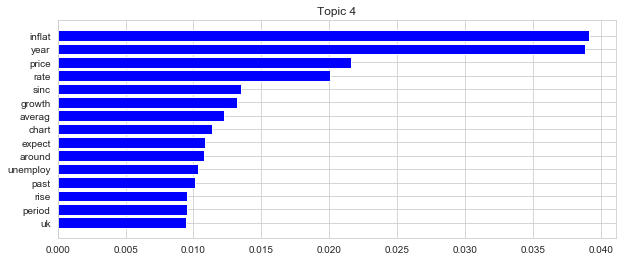

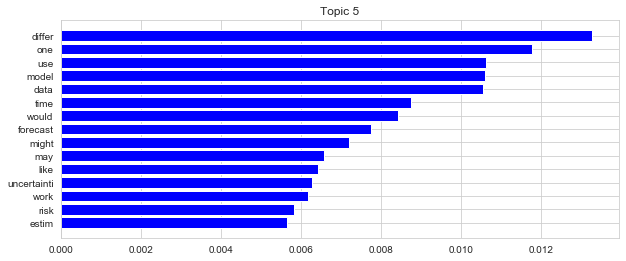

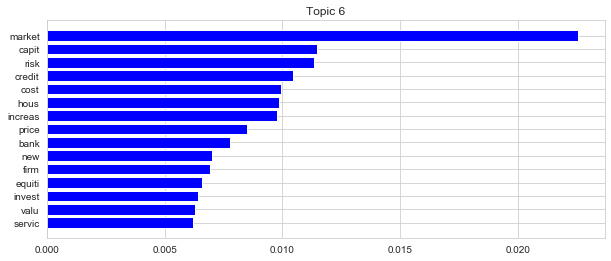

C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:1047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item_labels[indexer[info_axis]]] = value
C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

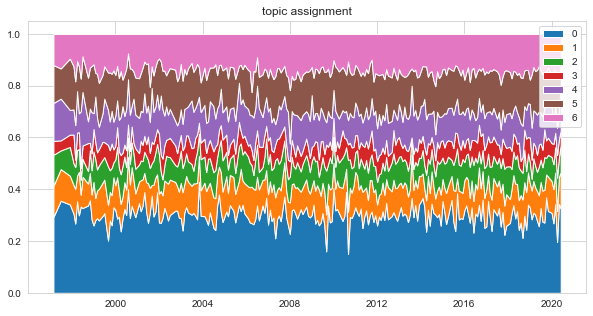

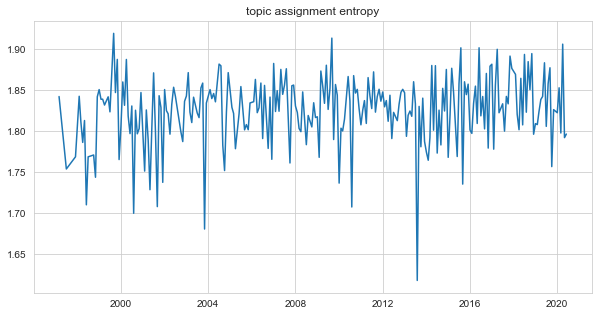

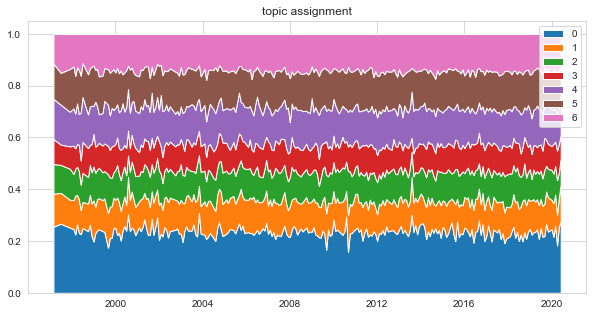

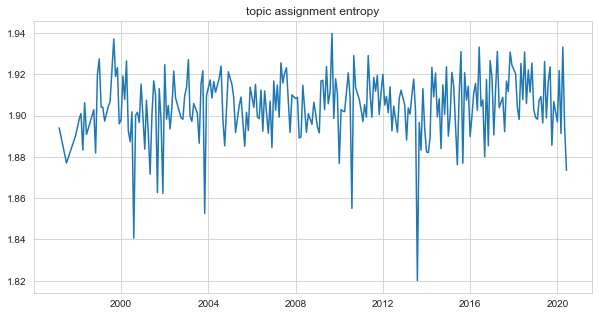

In [312]:
#BOE_speech_lda = LdaMulticore(corpus=BOE_speech_corpus, num_topics = 7, id2word = BOE_speech_dictionary, passes=10,workers=num_cores-1)
visualise_lda(BOE_speech_lda)
speech_dataset = merged_unstructured_dataset.loc[merged_unstructured_dataset.loc[:,'type']=='speech',]
speech_dataset.loc[:,'topics'] = speech_dataset.loc[:,'unstructured_string'].apply(lambda x: count_topics(x,BOE_speech_lda))
speech_dataset.loc[:,'topics_dis'] = speech_dataset.loc[:,'unstructured_string'].apply(lambda x: count_topics_prob(x,BOE_speech_lda))
visualize_topic_distribution(speech_dataset)

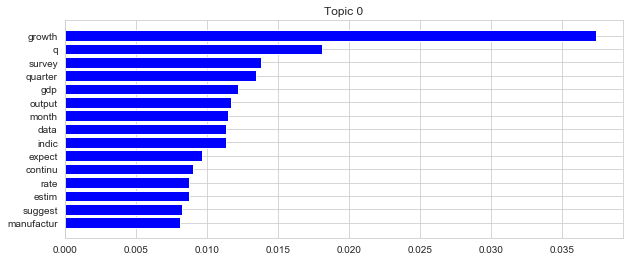

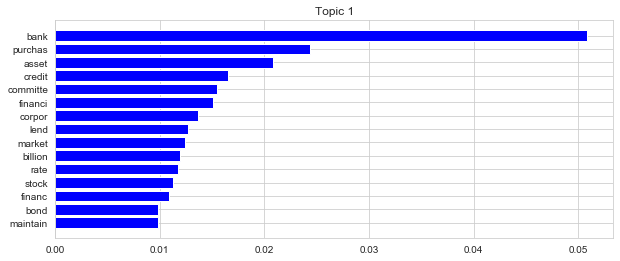

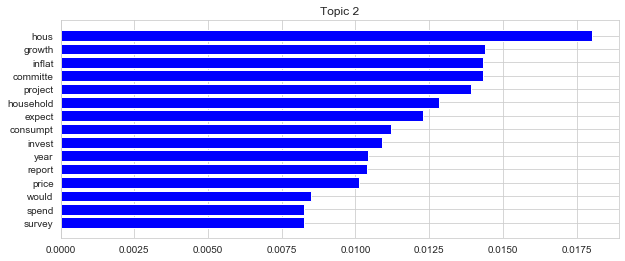

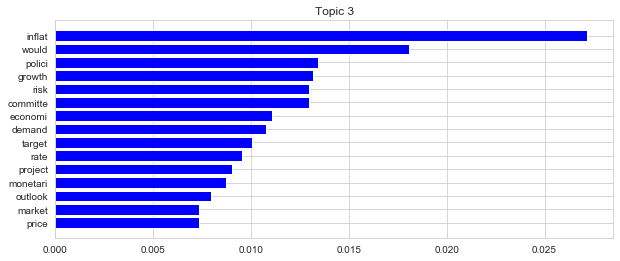

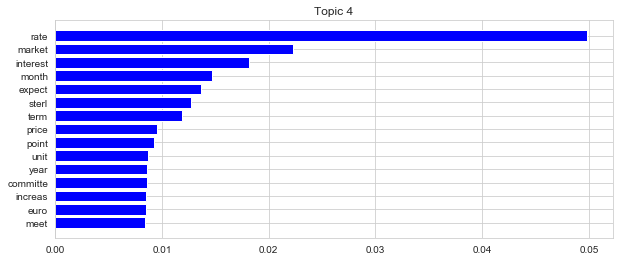

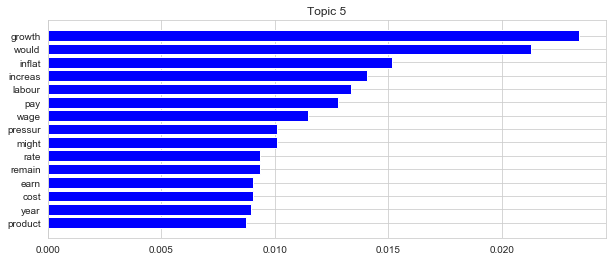

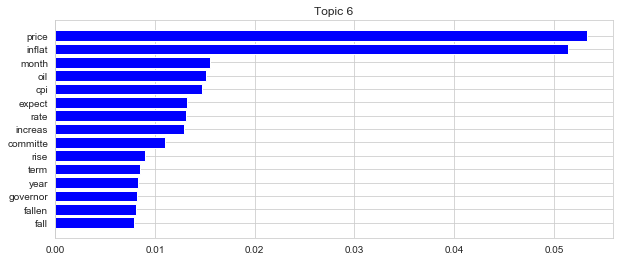

C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:1047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item_labels[indexer[info_axis]]] = value
C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:844: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\indexing.py:965: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

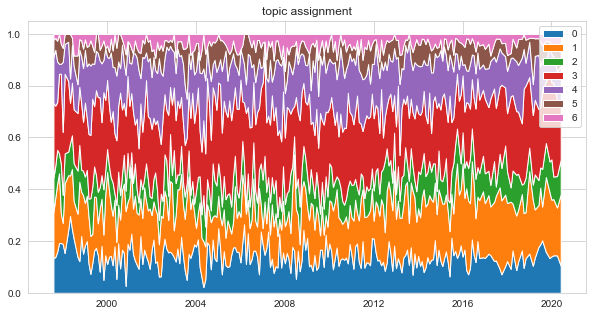

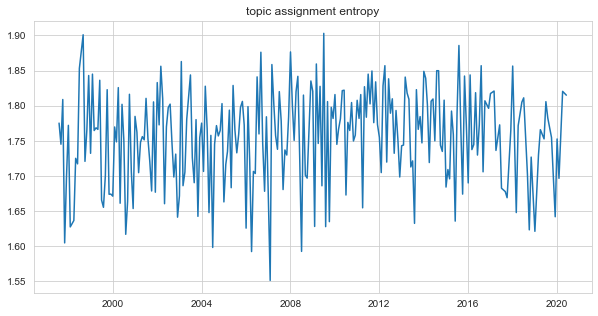

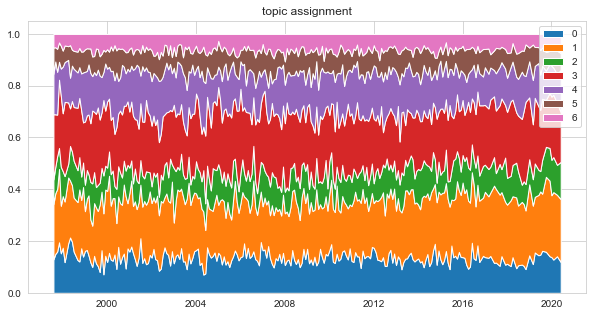

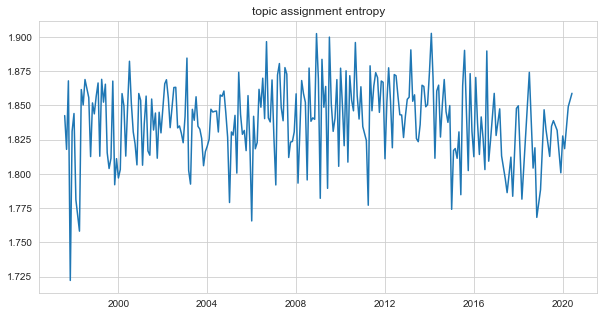

In [313]:
#BOE_minutes_lda = LdaMulticore(corpus=BOE_minutes_corpus, num_topics = 7, id2word = BOE_minutes_dictionary, passes=10,workers=num_cores-1)
visualise_lda(BOE_minutes_lda)
minute_dataset = merged_unstructured_dataset.loc[merged_unstructured_dataset.loc[:,'type']=='minutes',]
minute_dataset.loc[:,'topics'] = minute_dataset.loc[:,'unstructured_string'].apply(lambda x: count_topics(x,BOE_minutes_lda))
minute_dataset.loc[:,'topics_dis'] = minute_dataset.loc[:,'unstructured_string'].apply(lambda x: count_topics_prob(x,BOE_minutes_lda))
visualize_topic_distribution(minute_dataset)

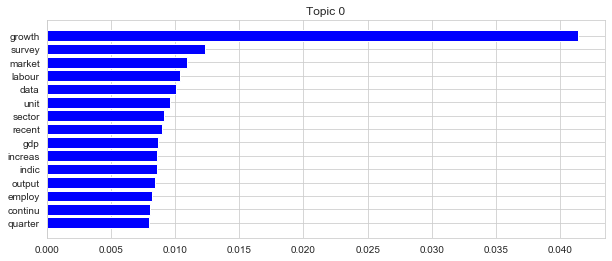

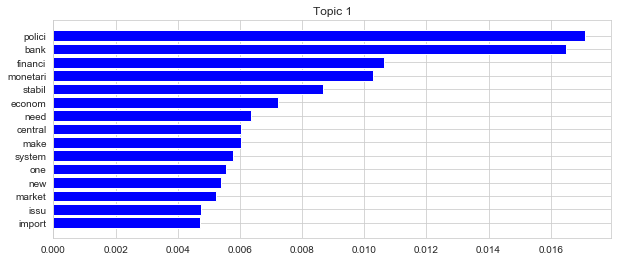

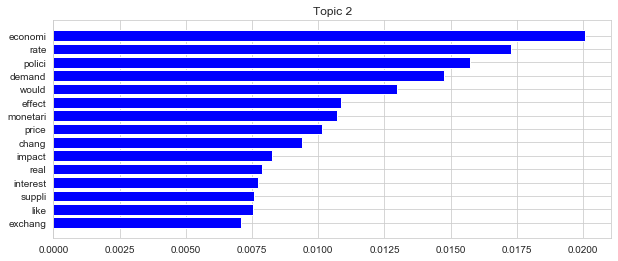

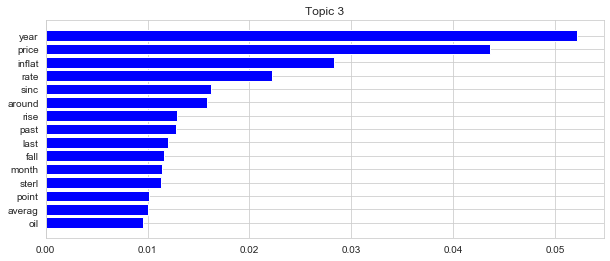

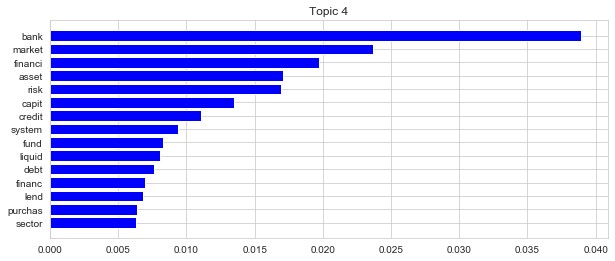

...

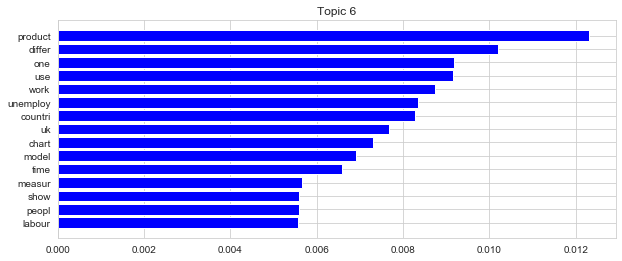

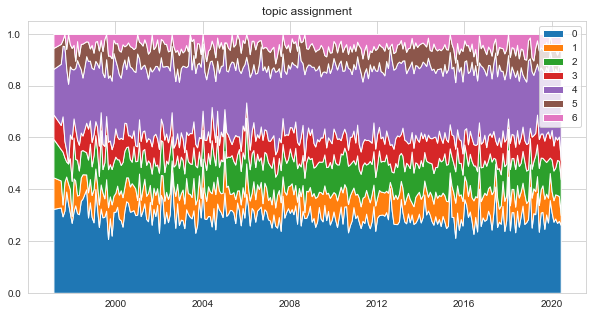

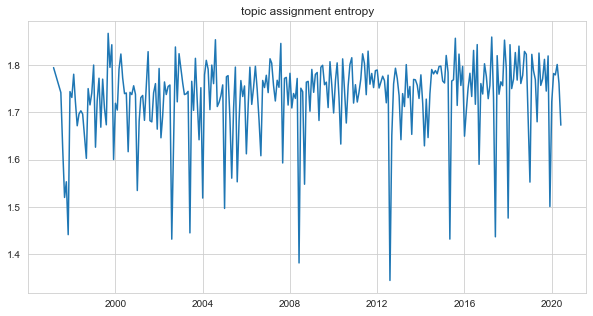

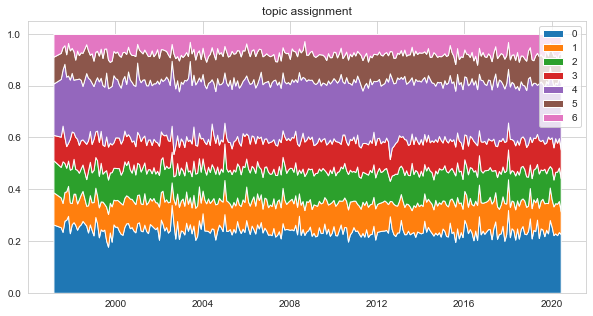

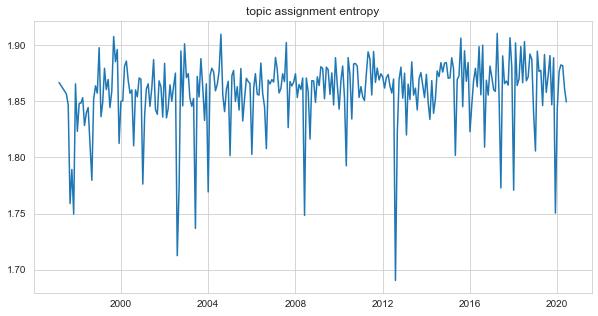

In [314]:
visualise_lda(BOE_lda)
merged_unstructured_dataset.loc[:,'topics'] = merged_unstructured_dataset.loc[:,'unstructured_string'].apply(lambda x: count_topics(x,BOE_lda))
merged_unstructured_dataset.loc[:,'topics_dis'] = merged_unstructured_dataset.loc[:,'unstructured_string'].apply(lambda x: count_topics_prob(x,BOE_lda))
visualize_topic_distribution(merged_unstructured_dataset)

In [333]:
#result,result2 = rolling_averaging_ewm(sentiment_97_15_minutes_prob)
Entropy_score  = sentiment_97_15_merged_prob.copy()
df = merged_unstructured_dataset.loc[:,'topics_dis']
df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
df = df.groupby(df.index).apply(lambda x: entropy(np.sum(x)/np.sum(np.sum(x))))
df = (df-df.mean())/np.std(df)
Entropy_score = Entropy_score.join(df,how='inner')


df = merged_unstructured_dataset.loc[:,'topics']
df.index = pd.DatetimeIndex(df.index)+pd.offsets.MonthBegin(0)
df = df.groupby(df.index).apply(lambda x: entropy(np.sum(x)/np.sum(np.sum(x))))
df = (df-df.mean())/np.std(df)
Entropy_score = Entropy_score.join(df,how='inner')

Entropy_score,result2 = rolling_averaging_ewm(Entropy_score,addition = ['topics_dis','topics'])

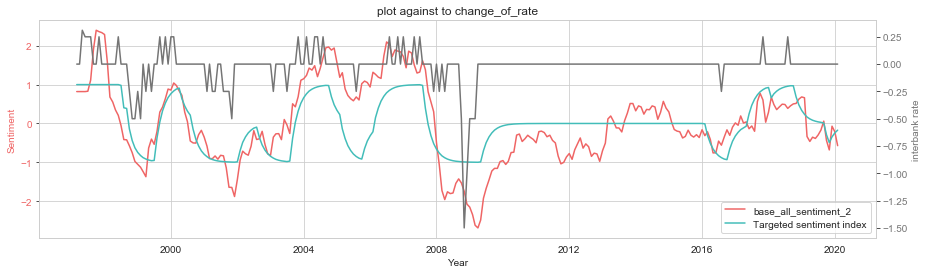

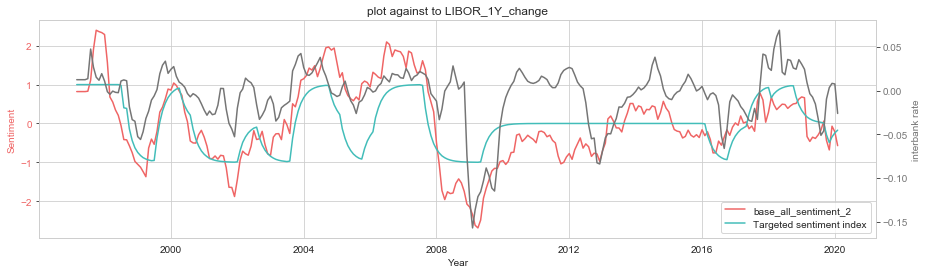

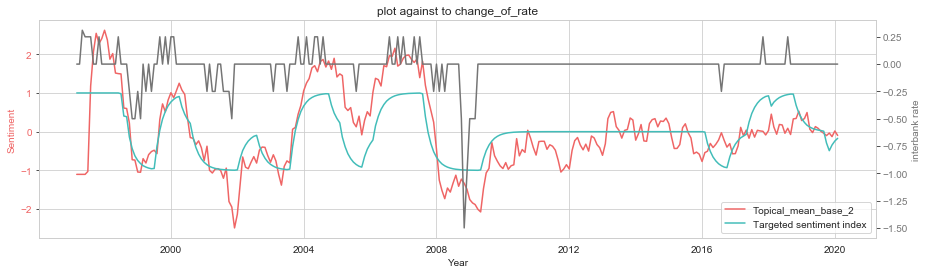

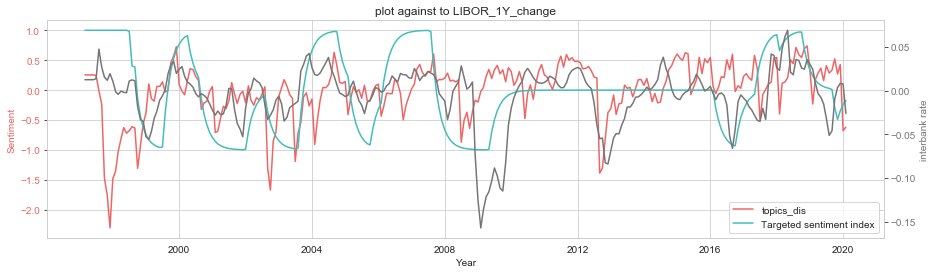

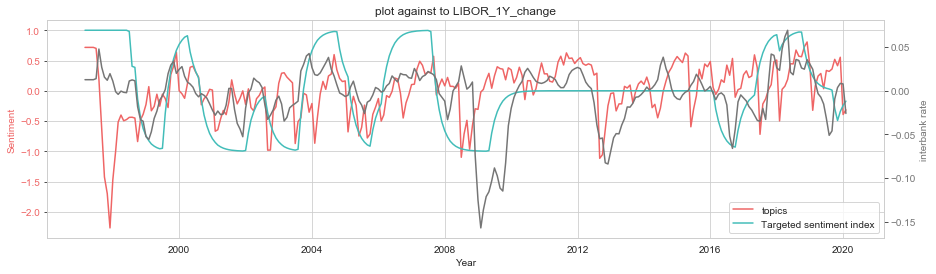

In [340]:
end_date =''
visualise_prob_model(Entropy_score)
create_comparison_plot(Entropy_score,'topics_dis',rate = 'LIBOR_1Y_change')
create_comparison_plot(Entropy_score,'topics',rate = 'LIBOR_1Y_change')

In [328]:
print('Correlation with Averaging')
print(Entropy_score.corr().loc[['label_2','LIBOR_1Y_change','Interest_rate','change_of_rate'],['base_all_sentiment_2','topics_dis','topics']])
print('Correlation No Averaging')
print(result2.corr())

Correlation with Averaging
                 base_all_sentiment  topics_dis    topics
label_2                    0.792457   -0.029294  0.001372
LIBOR_1Y_change            0.561908    0.064349  0.033931
Interest_rate              0.194781   -0.405719 -0.424219
change_of_rate             0.465796    0.087790  0.095900
Correlation No Averaging
                    LIBOR_1Y_change  base_all_sentiment  topics_dis    topics
LIBOR_1Y_change            1.000000            0.385039    0.036307  0.008060
base_all_sentiment         0.385039            1.000000   -0.035927 -0.022580
topics_dis                 0.036307           -0.035927    1.000000  0.936858
topics                     0.008060           -0.022580    0.936858  1.000000


In [ ]:
.set_index('title').join(df3,how='inner')

## A.2: Posterious distribution sentiment
Previously we have treat each positive and negative document equally and word sentiment ranking is simply the rate of coocurrence with positive.negative document. But now, we could give discrimination on different documents. In another word, here i am going to reconstruct word-frequency matrix and re-construct dictioanry.

In [404]:
def filter_speech_language_unconditional(string):
    result = {i:[] for i in topics}
    string1 = str(string).split(' ###newline### ')
    doc_list = []
    for string in string1:
        doc_list += [i for i in string.split('. ') if len(i.split())>=5 and 'thank' not in i.lower() and 'grate' not in i.lower()  and 'gratitude' not in i.lower() ]
    doc_list_cleaned = preprocess_data(doc_list)
    result = []
    for i in doc_list_cleaned:
        result+=i
    result = ' '.join(result)
    return result

In [427]:
topics =['Financial markets','The immediate policy decision','Growth and inflation projections',
         'Money, credit, demand and output','Supply, costs and prices','The international economy','All']
interested_topics =['The immediate policy decision','Money, credit, demand and output','Supply, costs and prices','The international economy']

MPC_speech2 = load_up_from_cleaned_speech()
MPC_speech2.loc[:,'all_string'] = MPC_speech2.loc[:,'document_string'].apply(lambda x: filter_speech_language_unconditional(x))
MPC_speech2.loc[:,'N_topics'] = MPC_speech2.loc[:,'document_string'].apply(lambda x: filter_speech_language(x,topics[:-1],thre=0.65))
speech_timeseries2 = MPC_speech2.set_index('date')
speech_timeseries2.index = pd.DatetimeIndex(speech_timeseries2.index)+pd.offsets.MonthBegin(0)
speech_timeseries2 = speech_timeseries2.loc[:,['title','all_string','N_topics']]
speech_timeseries2.loc[:,'Type'] = 'Speech'
speech_timeseries2

0.397 of all sentences in speech were kept

,title,all_string,N_topics,Type
date,,,,
2020-06-01,Covid-19 and monetary policy - speech by Micha...,view express necessarili bank england monetari...,"[[Financial markets, Moreover, with limited mo...",Speech
2020-05-01,Monetary policy and the Bank of England’s bala...,covid pandem first foremost global health issu...,"[[Financial markets, It is far more complex th...",Speech
2020-05-01,Monetary policy during pandemics inflation bef...,view necessarili bank england monetari polici ...,"[[Financial markets, Second, the policy respon...",Speech
2020-04-01,The grand unifying theory (and practice) of ma...,covet neat equat crave determinist system inev...,"[[Financial markets, Macroprudential policy is...",Speech
2020-04-01,Inflation and beliefs about inflation - speech...,receiv help comment colleagu bank england view...,"[[Financial markets, Precisely for that reason...",Speech
...,...,...,...,...
1998-02-01,The Chemical Industries Association Business O...,particularli plea associ confer theme sustain ...,"[[Financial markets, Many people think that - ...",Speech
1997-12-01,Developments in UK financial markets - speech ...,perhap singl moment chang financi landscap uk ...,"[[Financial markets, The framework put in plac...",Speech
1997-07-01,The Sixteenth Mais Lecture - speech by Edward ...,delight invit deliv sixteenth mai lectur two t...,"[[Financial markets, Sweeping generalisations ...",Speech


In [429]:
MPC_minutes = pd.read_hdf('data.h5', 'minutes')
minutes_timeseries2 = MPC_minutes.loc[:,['date','title','N_topics']]
result = []
for doc_list in minutes_timeseries2.loc[:,'N_topics']:
    document = ''
    for para in doc_list:      
        document += ' '.join(para[1:])
    result.append(document)
minutes_timeseries2.loc[:,'all_string'] = result    
    
minutes_timeseries2 = minutes_timeseries2.set_index('date')
minutes_timeseries2.index = pd.DatetimeIndex(minutes_timeseries2.index)+pd.offsets.MonthBegin(0)
minutes_timeseries2.loc[:,'Type'] = 'Minutes'
minutes_timeseries2.head()

merged_timeseries_all = pd.concat([speech_timeseries2,minutes_timeseries2]).sort_index(ascending=False)
label_df = pd.DataFrame(data={'label':rate_change},index = pd.DatetimeIndex(date_range))
label_list = [label_df.loc[i,'label'] for i in merged_timeseries_all.index]
merged_timeseries_all.loc[:,'label'] = label_list

label_df = pd.DataFrame(data={'label':rate_change_2},index = pd.DatetimeIndex(date_range))
label_list = [label_df.loc[i,'label'] for i in merged_timeseries_all.index]
merged_timeseries_all.loc[:,'label_2'] = label_list
merged_timeseries_all.head()

,title,all_string,N_topics,Type,label,label_2
date,,,,,,
2020-06-01,Covid-19 and monetary policy - speech by Micha...,view express necessarili bank england monetari...,"[[Financial markets, Moreover, with limited mo...",Speech,0,0
2020-06-01,Bank Rate maintained at 01% - May 2020_1st,Authorities around the world are taking action...,"[[Growth and inflation projections, Authoritie...",Minutes,0,0
2020-05-01,Monetary policy during pandemics inflation bef...,view necessarili bank england monetari polici ...,"[[Financial markets, Second, the policy respon...",Speech,0,0
2020-05-01,Monetary policy and the Bank of England’s bala...,covid pandem first foremost global health issu...,"[[Financial markets, It is far more complex th...",Speech,0,0
2020-04-01,Minutes of the special Monetary Policy Committ...,"Since the January MPC meeting, risk appetite i...","[[Financial markets, Since the January MPC mee...",Minutes,0,0


In [430]:
result = []
for doc_list in merged_timeseries_all.loc[:,'N_topics']:
    document = ''
    for para in doc_list:      
        document += ' '.join(para[1:])
    result.append(document)
merged_timeseries_all.loc[:,'cleaned_filtered'] = result
merged_timeseries_all.loc[:,'cleaned_filtered'] = preprocess_data(list(merged_timeseries_all.loc[:,'cleaned_filtered']))
merged_timeseries_all.loc[:,'cleaned_filtered_wordlsit'] = merged_timeseries_all.loc[:,'cleaned_filtered'].apply(lambda x: ' '.join([i for i in x if i in word_list]))
merged_timeseries_all.loc[:,'cleaned_all'] = preprocess_data(list(merged_timeseries_all.loc[:,'all_string']))
merged_timeseries_all.loc[:,'cleaned_all_wordlsit'] = merged_timeseries_all.loc[:,'cleaned_all'].apply(lambda x: ' '.join([i for i in x if i in word_list]))

In [432]:
merged_timeseries_all.join(merged_dataset.loc[:,'LIBOR_1Y_change'],how='inner').to_hdf('cleaned_all.h5', key='cleaned_all', mode='w')
pd.DataFrame({'words':word_list}).to_hdf('cleaned_all.h5', key='word_list', mode='r+')

C:\Users\lunarhero\anaconda3\lib\site-packages\pandas\core\generic.py:2505: PerformanceWarning: 
your performance may suffer as PyTables will pickle object types that it cannot
map directly to c-types [inferred_type->mixed,key->block2_values] [items->Index(['title', 'all_string', 'N_topics', 'Type', 'cleaned_filtered',
       'cleaned_filtered_wordlsit', 'cleaned_all', 'cleaned_all_wordlsit'],
      dtype='object')]

  encoding=encoding,


In [38]:
def create_vector_frequency(x,word_list):
    vector = [0 for i in word_list]
    for n,word in enumerate(word_list):
        a = x.count(word)
        if a!=a:
            vector[n] = 0
        else:
            vector[n] = a
    return vector

In [39]:
dataset = pd.read_hdf('cleaned_all.h5', key='cleaned_all')
word_list = pd.read_hdf('cleaned_all.h5', key='word_list').words.values

In [40]:
filtered_dataset = dataset.loc[:,['title','Type','cleaned_filtered','cleaned_filtered_wordlsit','LIBOR_1Y_change']]
all_dataset = dataset.loc[:,['title','Type','cleaned_all','cleaned_all_wordlsit','LIBOR_1Y_change']]

In [42]:
end_date, start_date='2015-12-31','1997-08-01'

training_data = all_dataset.loc[start_date:end_date,:]
testing_data = all_dataset.loc[end_date:,:]
training_data = training_data.sort_values('LIBOR_1Y_change')
training_data = training_data.dropna()
training_data = training_data.loc[training_data.loc[:,'cleaned_all_wordlsit']!= '' ,:]
training_data.loc[:,'probability'] = [(i+1)/len(training_data) for i in range(len(training_data))]
training_data.loc[:,'length'] = training_data.loc[:,'cleaned_all_wordlsit'].apply(lambda x: len(x.split()))
training_data.loc[:,'count_vector'] = training_data.loc[:,'cleaned_all_wordlsit'].apply(lambda x: np.array(create_vector_frequency(x,word_list)))
training_data.loc[:,'count_vector'] = training_data.loc[:,'count_vector'] / training_data.loc[:,'length'] 


In [44]:
end_date, start_date='2015-12-31','1997-08-01'

training_data = filtered_dataset.loc[start_date:end_date,:]
testing_data = filtered_dataset.loc[end_date:,:]
training_data = training_data.sort_values('LIBOR_1Y_change')
training_data = training_data.dropna()
training_data = training_data.loc[training_data.loc[:,'cleaned_filtered_wordlsit']!= '' ,:]
training_data.loc[:,'probability'] = [i/len(training_data) for i in range(len(training_data))]
training_data.loc[:,'length'] = training_data.loc[:,'cleaned_filtered_wordlsit'].apply(lambda x: len(x.split()))
training_data.loc[:,'count_vector'] = training_data.loc[:,'cleaned_filtered_wordlsit'].apply(lambda x: np.array(create_vector_frequency(x,word_list)))
training_data.loc[:,'count_vector'] = training_data.loc[:,'count_vector'] / training_data.loc[:,'length'] 


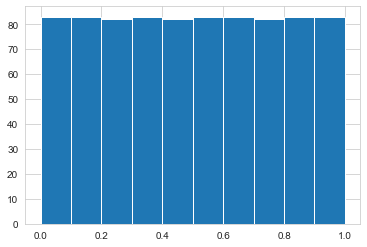

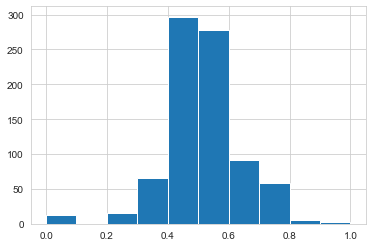

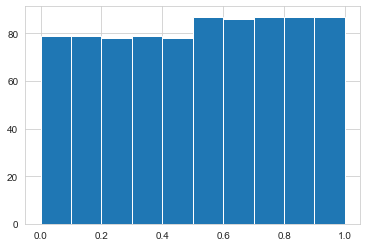

In [64]:
plt.hist(training_data.loc[:,'probability'])
plt.show()

training_data.loc[training_data.loc[:,'LIBOR_1Y_change']>0,'probability_2'] = (training_data.loc[training_data.loc[:,'LIBOR_1Y_change']>0,'LIBOR_1Y_change']-0)/(2 * max(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']>0,'LIBOR_1Y_change']))+0.5
training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'probability_2'] = (training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'LIBOR_1Y_change']-min(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'LIBOR_1Y_change']))/( 0 - 2 * min(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'LIBOR_1Y_change']))
plt.hist(training_data.loc[:,'probability_2'])
plt.show()

training_data.loc[training_data.loc[:,'LIBOR_1Y_change']>0,'probability_3'] = [0.5+0.5*i/len(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']>0,'LIBOR_1Y_change']) for i in range(len(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']>0,'LIBOR_1Y_change']))]
training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'probability_3'] = [0.5*i/len(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'LIBOR_1Y_change']) for i in range(len(training_data.loc[training_data.loc[:,'LIBOR_1Y_change']<=0,'LIBOR_1Y_change']))]
plt.hist(training_data.loc[:,'probability_3'])
plt.show()

In [612]:
def prediction_probability(p,d,s,lam,Matrix_O):
    return -np.nansum(d*(np.log(Matrix_O[:,0]*p+Matrix_O[:,0]*(1-p))))/s + lam*np.log(p*(1-p))
n_row = len(training_data.loc[:,'count_vector'].values[0])
n_col = len(training_data)
D_matrix = np.zeros((n_row,n_col))
Prob_vector = training_data.loc[:,'probability'].values
for n,i in enumerate(training_data.loc[:,'count_vector']):
    D_matrix[:,n]=i.reshape(1,-1)
W_matrix = np.zeros((2,n_col))
for i in range(n_col):
    W_matrix[:,i] = [Prob_vector[i],1-Prob_vector[i]]
Matrix_O = D_matrix.dot(W_matrix.T).dot(np.linalg.inv(W_matrix.dot(W_matrix.T)))

In [615]:
d_list = training_data.count_vector.values
s_list = training_data.length.values
lam = 0.5
predicted = [0 for i in d_list]
for i in range(len(predicted)):
    predicted[i] = optimize.minimize(prediction_probability,x0 = [0.7], args=(d_list[i],s_list[i],lam,Matrix_O), bounds=((0, 1),), tol=1e-10).x

C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  
C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log
  
C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in multiply
  


---
---
## A.3: trained on inflation



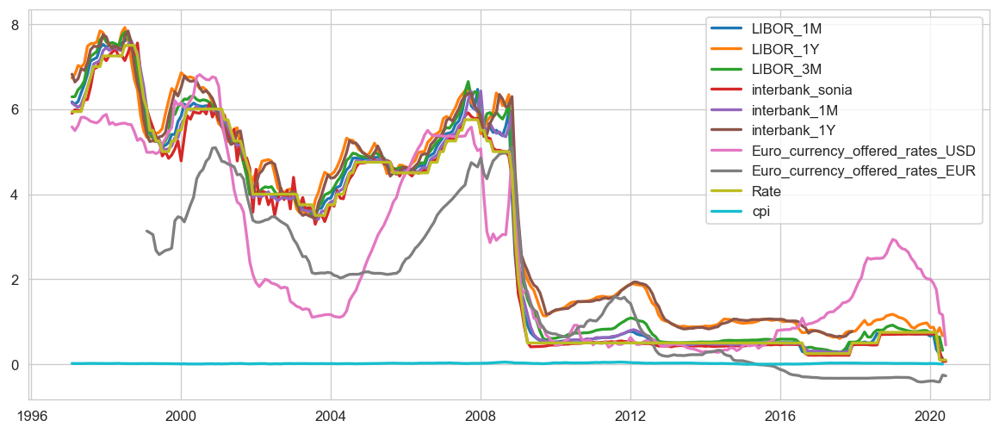

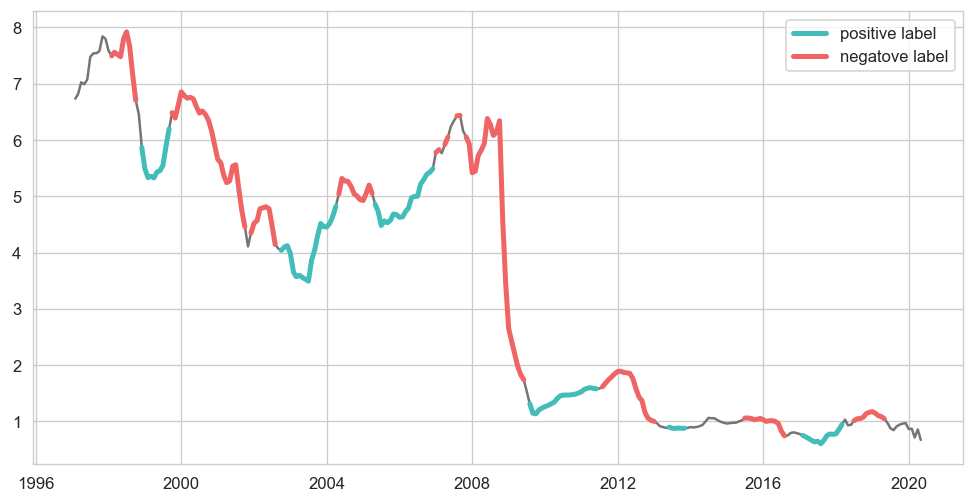

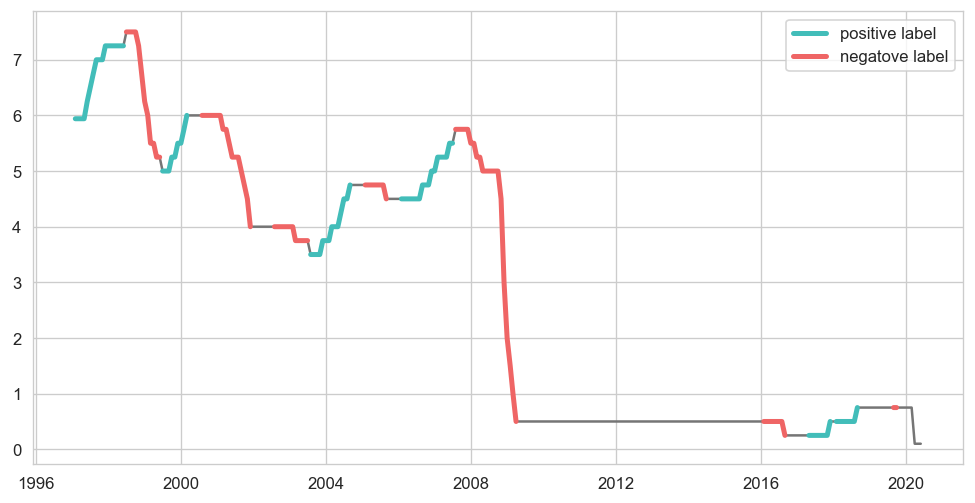

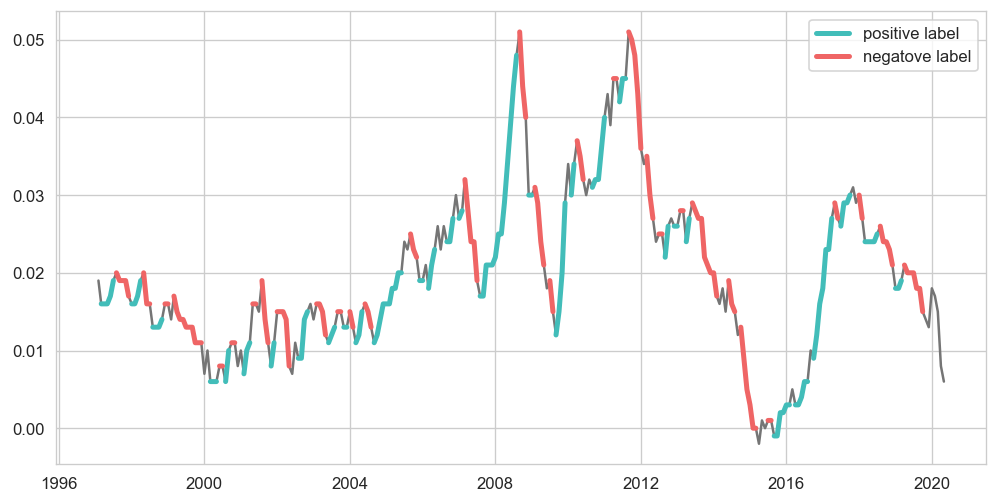

In [184]:
merged_dataset = load_interest_rate()

base_rate = pd.read_csv('./scripter/cleaned_dataset/Bank Rate  Bank of England Database.csv',index_col = 0)
base_rate.index = pd.DatetimeIndex(base_rate.index)
base_rate = base_rate.reindex(pd.date_range(start = base_rate.index[-1], end = merged_dataset.index[-1]))
for i in range(1,len(base_rate)):
    if base_rate.iloc[i,0]!=base_rate.iloc[i,0]:
        base_rate.iloc[i,0]=base_rate.iloc[i-1,0]
merged_dataset = merged_dataset.join(base_rate,how='inner')
df1 = pd.read_excel('./scripter/cleaned_dataset/monthly_cpi.xlsx',index_col=0)
dates = []
values = []
for year in df1.index[::-1]:
    for month in df1.columns[:-1]:
        dates.append(month+' '+str(year))
        values.append(df1.loc[year,month])
cpi_data = pd.DataFrame({'cpi':values},index=pd.DatetimeIndex(dates))
merged_dataset = merged_dataset.join(cpi_data,how='inner')


items = list(merged_dataset)
plt.figure(figsize=(12,5),dpi=120)
for i in range(len(items)):
    plt.plot(merged_dataset.index,merged_dataset.iloc[:,i].values,label = items[i],lw=2)
plt.legend()
plt.show()

date_range = merged_dataset.index
list_of_value = merged_dataset.LIBOR_1Y.values
rate_change = create_label_for_dictionary(list_of_value,date_range)
date_range = merged_dataset.index
list_of_value_2 = merged_dataset.Rate.values
rate_change_2 = create_label_for_dictionary_2(list_of_value_2,date_range)


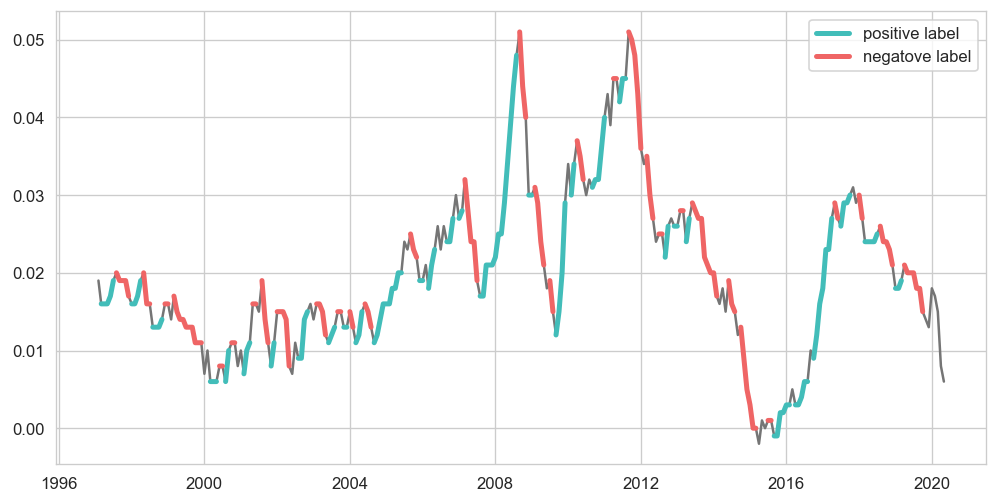

In [188]:
date_range = merged_dataset.index
list_of_value_3 = merged_dataset.cpi.values
rate_change_3 = create_label_for_dictionary_2(list_of_value_3,date_range)

In [190]:
label_df = pd.DataFrame(data={'label':rate_change_3},index = pd.DatetimeIndex(date_range))
label_list = [label_df.loc[i,'label'] for i in merged_timeseries_labelled.index]
merged_timeseries_labelled.loc[:,'label_3'] = label_list
merged_timeseries_labelled

,title,N_topics,Type,label,label_2,cleaned,cleaned string,sentiment_1,base_all_sentiment,label_3
date,,,,,,,,,,
2020-06-01,Covid-19 and monetary policy - speech by Micha...,"[[Financial markets, Moreover, with limited mo...",Speech,0,0,"[moreov, limit, monetari, polici, space, would...",favour downsid worri lose failur illustr decli...,-1,-0.602197,0
2020-06-01,Bank Rate maintained at 01% - May 2020_1st,"[[Growth and inflation projections, Authoritie...",Minutes,0,0,"[author, around, world, take, action, halt, sp...",challeng respond sever disrupt unanim financ c...,-1,-0.434723,0
2020-05-01,Monetary policy during pandemics inflation bef...,"[[Financial markets, Second, the policy respon...",Speech,0,0,"[second, polici, respons, mpc, make, one, part...",ensur failur loss persist neg expenditur diffi...,-1,-0.253375,0
2020-05-01,Monetary policy and the Bank of England’s bala...,"[[Financial markets, It is far more complex th...",Speech,0,0,"[far, complex, consequ, far, scope, activ, pol...",social ensur sever disrupt principl sheet trea...,-1,-0.151604,0
2020-04-01,Minutes of the special Monetary Policy Committ...,"[[Financial markets, Since the January MPC mee...",Minutes,0,0,"[sinc, januari, mpc, meet, risk, appetit, glob...",deterior escal downsid partli pick declin liqu...,-1,-0.201388,0
...,...,...,...,...,...,...,...,...,...,...
1997-09-01,Minutes of the MPC Meeting held on 9 and 10 Ju...,"[[Financial markets, The estimated change in n...",Minutes,0,1,"[estim, chang, note, coin, may, revis, upward,...",upward weaken broad strengthen wholesal broad ...,1,0.518462,-1
1997-08-01,Minutes of the MPC Meeting held on 5 and 6 Jun...,"[[Financial markets, Short-term interest rates...",Minutes,0,1,"[short, term, interest, rate, expect, next, co...",grow grow evolv summer grow difficult problem ...,1,0.337077,-1
1997-07-01,Lord Mayors Banquet - speech by Edward George,"[[Financial markets, It operates with long and...",Speech,0,1,"[oper, long, unpredict, time, lag, necessarili...",lag strain upon principl technic implement pre...,1,0.159440,1


In [239]:
def create_custom_dictionary_inflation(word_list,topic,para=[20,0.55,0.6]):
    sentiment = []
    FS_dict = load_FS_dictionary().set_index('Entry')
    word_list_all = word_list[topic]
    FS_dict = FS_dict.join(word_list_all,how='inner')

    word_list_all = word_list_all.loc[(word_list_all['postive count']+word_list_all['negative count'])>para[0],:]
    positive = word_list_all.loc[word_list_all['p percentage no neutral']>para[1],:].sort_values(by=['p percentage no neutral'],ascending=False)
    
    negative = word_list_all.loc[word_list_all['n percentage no neutral']>para[2],:].sort_values(by=['n percentage no neutral'],ascending=False)
    positive = positive.iloc[:min(100,len(positive)),:]
    negative = negative.iloc[:min(100,len(negative)),:]

    selected = pd.concat([positive,negative])

    Positive = FS_dict.loc[FS_dict.loc[:,'sentiment']=='Positive',:].loc[FS_dict.loc[:,'p percentage no neutral']>0.5,:]
    positive = list(positive.index) #+list(Positive.index)
    sentiment += ['Positive' for i in enumerate(positive)]


    Negative = FS_dict.loc[FS_dict.loc[:,'sentiment']=='Negative',:].loc[FS_dict.loc[:,'n percentage no neutral']>0.5,:]
    negative = list(negative.index) #+list(Negative.index)
    sentiment += ['Negative' for i in enumerate(negative)]

    Entry = positive+negative
    New_dictionary = pd.DataFrame(data={'Entry':Entry,'sentiment':sentiment})


    a = pd.concat([Positive.iloc[:,1:],Negative.iloc[:,1:],selected]).drop_duplicates()
    FS_dict = load_FS_dictionary().set_index('Entry')
    FS_dict.columns = ['FS_sentiment']
    FS_dict = FS_dict.join(a,how='outer')

    FS_dict.loc[:,'Model_sentiment']=np.nan
    for word in positive:
        FS_dict.loc[word,'Model_sentiment'] = 'Positive'
    for word in negative:
        FS_dict.loc[word,'Model_sentiment'] = 'Negative'
    
    return New_dictionary,FS_dict

def training_dictionary_sentiment_inflation(minutes_timeseries,para_set=[[20,0.55,0.6],[10,0.55,0.6]],doc_name='untitled'):
    # approximate 3 mins
    writer = pd.ExcelWriter('./Dictionary_based_method/Dictionary_data/{}.xlsx'.format(doc_name), engine='xlsxwriter')

    word_list_baserate = create_cooccurence_list(minutes_timeseries,'label_3')
    
    custome_base_all,FS_dict  = create_custom_dictionary_inflation(word_list_baserate,'All',para=para_set[0]) 
    FS_dict.to_excel(writer, sheet_name='custome_inflation_all')
    
    custome_base_topic  = {}
    custome_libor_topic = {}
    for n,topic in enumerate(topics):
        if topic !='All':
            custome_base_topic[topic],FS_dict  = create_custom_dictionary_inflation(word_list_baserate,topic,para=para_set[1])
            FS_dict.to_excel(writer, sheet_name='inflation_topic_{}'.format(n+1), startrow = 1)
            worksheet = writer.sheets['inflation_topic_{}'.format(n+1)]
            worksheet.write_string(0, 0, topic)
    writer.save()
    return word_list_baserate,(custome_base_all,custome_base_topic)

def result_dictionary_sentiment_prob_inflation(dictionary_model_2020,interested_topics,testing_data=pd.read_hdf('data.h5', 'minutes')):
    print('calculating all')
    dictionary_sentiment = testing_data.copy()
    dictionary_sentiment.loc[:,'inflation_all_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator_prob(dictionary_model_2020[0],x))
    for topic in interested_topics:
        print('calculating topic: {}'.format(topic))
        dictionary_sentiment.loc[:,'inflation_{}_sentiment'.format(topic)] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator_topic_prob(dictionary_model_2020[1][topic],x,topic))
    dictionary_sentiment.loc[:,'Topical_mean_inflation'] = dictionary_sentiment.loc[:,['inflation_{}_sentiment'.format(topic) for topic in interested_topics]].mean(axis=1)
    FS_dict = load_FS_dictionary()
    LM_dict = load_LM_dictionary()
    print('calculating dictionary sentiment')
    dictionary_sentiment.loc[:,'FS_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator(FS_dict,x))
    dictionary_sentiment.loc[:,'LM_sentiment'] = dictionary_sentiment.loc[:,'N_topics'].apply(lambda x: sentiment_calculator(LM_dict,x))
    return dictionary_sentiment

def rolling_averaging_ewm_inflation(df,start = '1997-02-25', end ='2020-01-28',addition=[]):
    df1 = df.groupby(df.index).mean()
    merged_dataset.loc[:,'cpi_change'] = [np.nan]+list((merged_dataset.cpi.values[1:] - merged_dataset.cpi.values[:-1])/merged_dataset.cpi.values[:-1])
    df1 = df1.join(merged_dataset.loc[:,'cpi_change'],how='inner')
    df1 = df1.join(merged_dataset.loc[:,'cpi'],how='inner')
    df2 = df1.loc[:,['cpi_change','inflation_all_sentiment']+addition]
    df2 = (df2-df2.mean())/df2.std()
    df1 = df1.reindex(pd.date_range(start, end))
    df1 = df1.ewm(halflife=60).mean()
    df1.index = df1.index+pd.offsets.MonthBegin(0)
    df1 = df1.groupby(df1.index).mean()
    df1 =  df1.join(pd.DataFrame(data={'CPI_rate':list_of_value_3},index = date_range),how = 'inner')
    y = list_of_value_3[1:] - list_of_value_3[:-1]
    df1 =  df1.join(pd.DataFrame(data={'change_of_rate':y},index = date_range[:-1]),how = 'inner')
    
    return df1,df2


def remove_duplicates_inflation(dictionary_model_97_11):
    a = dictionary_model_97_11[0].drop_duplicates()
    c={}
    for topic in dictionary_model_97_11[1].keys():
        c[topic] = dictionary_model_97_11[1][topic].drop_duplicates()
    return (a,c)

def create_probability_model_inflation(word_document_frequency_97_11,dictionary_model_97_11):
    base_word =  word_document_frequency_97_11
    a = dictionary_model_97_11[0].set_index('Entry').join(base_word['All'].loc[:,'p percentage no neutral'])
    c={}
    for topic in dictionary_model_97_11[1].keys():
        c[topic] = dictionary_model_97_11[1][topic].set_index('Entry').join(base_word[topic].loc[:,'p percentage no neutral'])
    return (a,c)

def create_comparison_plot_inflation(df1,column,rate = 'Interest_rate',end_date=''):
    fig, ax1 = plt.subplots(figsize=(15,4))
    ax1.set_xlabel('Year')
    ax1.set_ylabel('Sentiment', color=my_color[0])
    ax1.plot(df1.index,df1.loc[:,column].values,color = my_color[0],label = column)
    ax1.plot(df1.index,df1.label_3.values,color = my_color[1],label = 'Targeted sentiment index')
    if end_date!='':
        ax1.axvline(pd.to_datetime(end_date), -1, 1, color='#387a6f',alpha=0.5,lw=7, label='training data end')
    ax1.tick_params(axis='y', labelcolor=my_color[0])
    ax1.legend(loc='lower right')
    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
    ax2.grid(False)
    ax2.set_ylabel('interbank rate', color='#757575')  # we already handled the x-label with ax1
    ax2.plot(df1.index,df1.loc[:,rate].values,color='#757575')
    ax2.tick_params(axis='y', labelcolor='#757575')
    plt.title('plot against to '+rate)
    plt.show()
    return None   
    
def visualise_prob_model_inflation(sentiment_97_15_merged_prob):
    for i in ['cpi','inflation_all_sentiment','Topical_mean_inflation','FS_sentiment','LM_sentiment','inflation_Growth and inflation projections_sentiment']:
        sentiment_97_15_merged_prob.loc[:,i] = (sentiment_97_15_merged_prob.loc[:,i]-sentiment_97_15_merged_prob.loc[:,i].mean())/np.std(sentiment_97_15_merged_prob.loc[:,i])
    create_comparison_plot_inflation(sentiment_97_15_merged_prob,'FS_sentiment',rate = 'CPI_rate', end_date=end_date)
    create_comparison_plot_inflation(sentiment_97_15_merged_prob,'LM_sentiment',rate = 'CPI_rate', end_date=end_date)
    create_comparison_plot_inflation(sentiment_97_15_merged_prob,'inflation_all_sentiment',rate = 'CPI_rate', end_date=end_date)
    create_comparison_plot_inflation(sentiment_97_15_merged_prob,'inflation_Growth and inflation projections_sentiment',rate = 'CPI_rate', end_date=end_date)
    create_comparison_plot_inflation(sentiment_97_15_merged_prob,'Topical_mean_inflation',rate = 'CPI_rate', end_date=end_date)
    return None

def describe_lagged_information(df1,rate='LIBOR_1Y_change',sentiment ='base_all_sentiment'):   
    create_comparison_plot_for_lagged(df1,sentiment,rate = rate,end_date='',lag=-2)    
    create_comparison_plot_for_lagged(df1,sentiment,rate = rate,end_date='',lag=0)    
    create_comparison_plot_for_lagged(df1,sentiment,rate = rate,end_date='',lag=2)    
    y = df1.loc[:,rate]
    return pd.DataFrame({'lag {}'.format(i):df1.loc[:,sentiment].shift(i).corr(y) for i in range(-5,6)},index=[rate])

In [199]:
end_date, start_date='2015-12-31','1997-08-01'
interested_topics = [
    'Financial markets',
    'The immediate policy decision',
    'Growth and inflation projections',
    'Money, credit, demand and output',
    'Supply, costs and prices',
    'The international economy',
]
topics =['Financial markets','The immediate policy decision','Growth and inflation projections',
         'Money, credit, demand and output','Supply, costs and prices','The international economy','All']


training_data = merged_timeseries_labelled.loc[end_date:start_date,:]
word_document_frequency_97_15_merged_inflation,dictionary_model_97_15_merged_inflation = training_dictionary_sentiment_inflation(training_data,para_set=[[50,0.55,0.55],[30,0.55,0.55]],doc_name='9715_speech_minutes_inflation')
dictionary_model_97_15_merged_inflation = remove_duplicates_inflation(dictionary_model_97_15_merged_inflation)
model = create_probability_model_inflation(word_document_frequency_97_15_merged_inflation,dictionary_model_97_15_merged_inflation)
sentiment_97_15_merged_prob_inflation = result_dictionary_sentiment_prob_inflation(model,interested_topics,merged_timeseries_labelled)

Positive count:391   Negative count:437   Neutral count:0
calculate word frequency
create dictionary for topic: Financial markets
create dictionary for topic: The immediate policy decision
create dictionary for topic: Growth and inflation projections
create dictionary for topic: Money, credit, demand and output
create dictionary for topic: Supply, costs and prices
create dictionary for topic: The international economy
create dictionary for topic: All


C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide


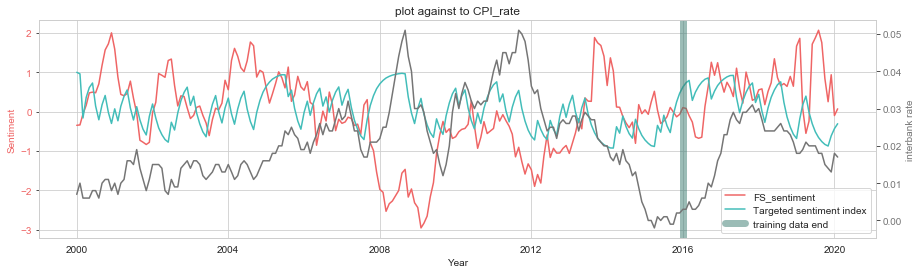

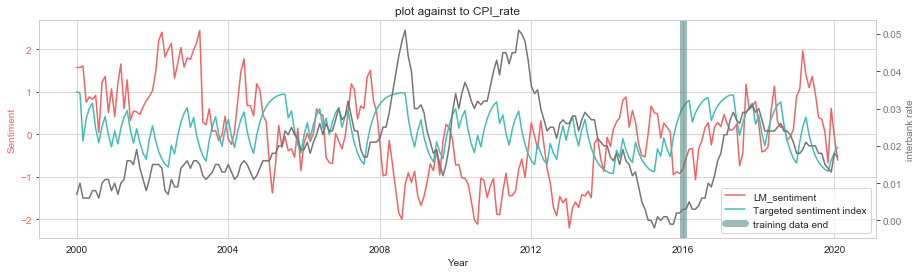

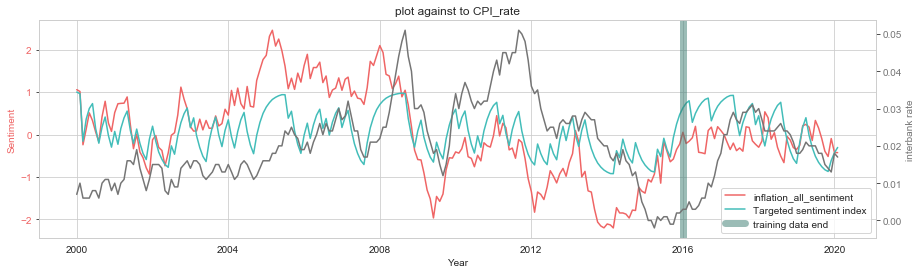

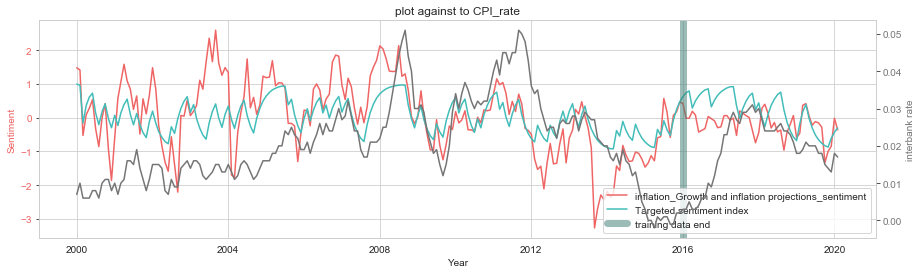

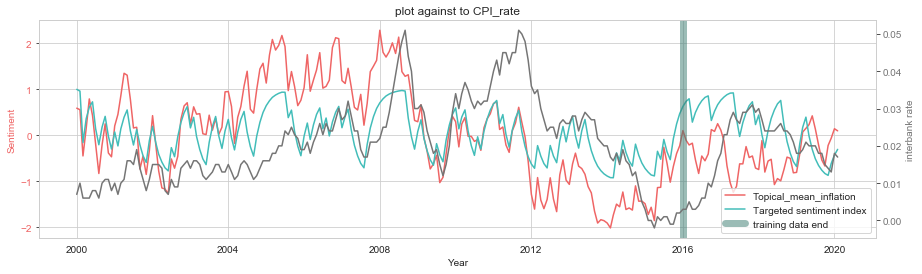

Correlation with Averaging
                inflation_all_sentiment  Topical_mean_inflation  FS_sentiment  \
label_3                        0.582964                0.611263     -0.135007   
cpi_change                     0.184778                0.221881      0.058226   
cpi                           -0.152017                0.011446     -0.453877   
CPI_rate                       0.037962                0.210938     -0.411051   
change_of_rate                 0.168785                0.163534      0.038439   

                LM_sentiment  \
label_3            -0.079764   
cpi_change          0.055486   
cpi                -0.498389   
CPI_rate           -0.497984   
change_of_rate     -0.009485   

                inflation_Growth and inflation projections_sentiment  
label_3                                                  0.612305     
cpi_change                                               0.086700     
cpi                                                     -0.039399     
CPI_rate 

,label,label_2,sentiment_1,base_all_sentiment,label_3,inflation_all_sentiment,inflation_Financial markets_sentiment,inflation_The immediate policy decision_sentiment,inflation_Growth and inflation projections_sentiment,"inflation_Money, credit, demand and output_sentiment","inflation_Supply, costs and prices_sentiment",inflation_The international economy_sentiment,Topical_mean_inflation,FS_sentiment,LM_sentiment,cpi_change,cpi,CPI_rate,change_of_rate
label,1.000000,0.357758,0.301288,0.386623,0.003594,0.032900,-0.006848,0.060942,0.045919,0.158998,-0.005208,0.191452,0.044542,0.202121,-0.124814,0.129214,0.237029,0.287221,0.049733
label_2,0.357758,1.000000,0.656056,0.756463,-0.031254,0.077449,0.022854,-0.143764,-0.073560,0.000468,-0.072994,0.120129,-0.058500,0.321217,0.104232,-0.110340,0.097246,0.050809,-0.047598
sentiment_1,0.301288,0.656056,1.000000,0.901069,0.104505,0.529755,0.450453,0.218346,0.208713,0.402770,0.456270,0.430469,0.409526,0.323712,0.241936,0.009794,-0.128808,-0.137432,-0.035018
base_all_sentiment,0.386623,0.756463,0.901069,1.000000,0.040775,0.390600,0.296243,0.050533,0.056878,0.192557,0.270786,0.270888,0.211428,0.531081,0.256487,-0.020213,-0.186039,-0.189120,-0.016896
label_3,0.003594,-0.031254,0.104505,0.040775,1.000000,0.582964,0.538536,0.512287,0.612305,0.315227,0.469573,0.425911,0.611263,-0.135007,-0.079764,0.179517,-0.074025,0.239822,0.214422
inflation_all_sentiment,0.032900,0.077449,0.529755,0.390600,0.582964,1.000000,0.823330,0.734089,0.700539,0.630489,0.767708,0.625855,0.887160,0.097435,0.185240,0.184778,-0.152017,0.037962,0.168785
inflation_Financial markets_sentiment,-0.006848,0.022854,0.450453,0.296243,0.538536,0.823330,1.000000,0.682613,0.694375,0.597052,0.737507,0.547262,0.883726,-0.068681,-0.021783,0.159667,-0.000353,0.160894,0.119753
inflation_The immediate policy decision_sentiment,0.060942,-0.143764,0.218346,0.050533,0.512287,0.734089,0.682613,1.000000,0.609683,0.595156,0.664771,0.625698,0.875293,-0.164288,-0.084895,0.200262,0.113618,0.315153,0.170747
inflation_Growth and inflation projections_sentiment,0.045919,-0.073560,0.208713,0.056878,0.612305,0.700539,0.694375,0.609683,1.000000,0.505700,0.583864,0.432371,0.781749,-0.244002,0.000144,0.086700,-0.039399,0.165085,0.147053
"inflation_Money, credit, demand and output_sentiment",0.158998,0.000468,0.402770,0.192557,0.315227,0.630489,0.597052,0.595156,0.505700,1.000000,0.594103,0.572190,0.727993,-0.104679,0.115725,0.228945,0.147548,0.222360,0.031265


In [235]:
result,result2 = rolling_averaging_ewm_inflation(sentiment_97_15_merged_prob_inflation,start='2000-01-01')
visualise_prob_model_inflation(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_3','cpi_change','cpi','CPI_rate','change_of_rate'],['inflation_all_sentiment','Topical_mean_inflation','FS_sentiment','LM_sentiment','inflation_Growth and inflation projections_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()

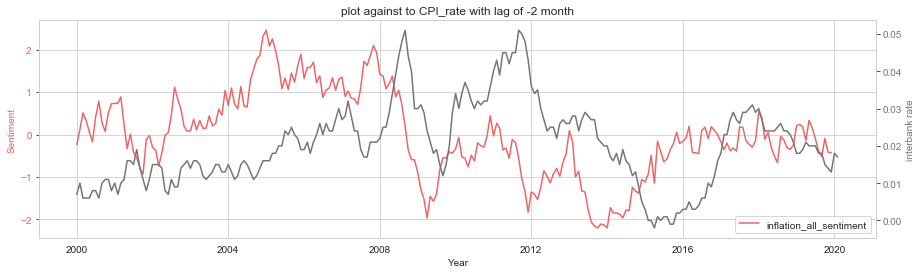

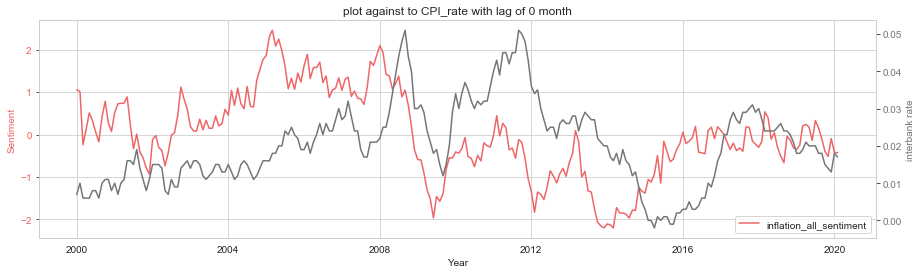

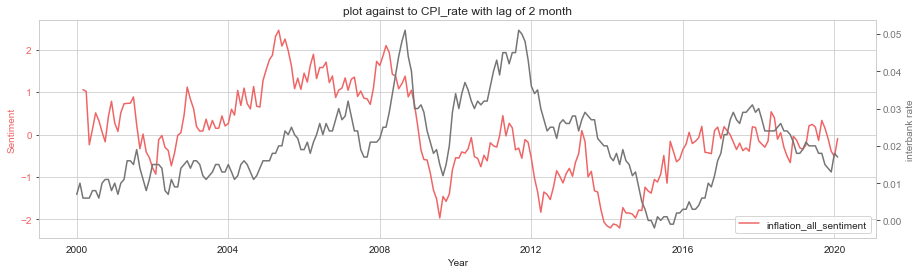

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
CPI_rate,-0.2327,-0.194519,-0.146208,-0.088197,-0.029022,0.037962,0.079672,0.118719,0.153564,0.185803,0.204236


In [237]:
describe_lagged_information(result,rate='CPI_rate',sentiment ='inflation_all_sentiment')

In [240]:
end_date, start_date='2010-12-31','1997-08-01'
interested_topics = [
    'Financial markets',
    'The immediate policy decision',
    'Growth and inflation projections',
    'Money, credit, demand and output',
    'Supply, costs and prices',
    'The international economy',
]
topics =['Financial markets','The immediate policy decision','Growth and inflation projections',
         'Money, credit, demand and output','Supply, costs and prices','The international economy','All']


training_data = merged_timeseries_labelled.loc[end_date:start_date,:]
word_document_frequency_97_10_merged_inflation,dictionary_model_97_10_merged_inflation = training_dictionary_sentiment_inflation(training_data,para_set=[[50,0.55,0.55],[30,0.55,0.55]],doc_name='9710_speech_minutes_inflation')
dictionary_model_97_10_merged_inflation = remove_duplicates_inflation(dictionary_model_97_10_merged_inflation)
model = create_probability_model_inflation(word_document_frequency_97_10_merged_inflation,dictionary_model_97_10_merged_inflation)
sentiment_97_10_merged_prob_inflation = result_dictionary_sentiment_prob_inflation(model,interested_topics,merged_timeseries_labelled)

Positive count:292   Negative count:253   Neutral count:0
calculate word frequency
create dictionary for topic: Financial markets
create dictionary for topic: The immediate policy decision
create dictionary for topic: Growth and inflation projections
create dictionary for topic: Money, credit, demand and output
create dictionary for topic: Supply, costs and prices
create dictionary for topic: The international economy
create dictionary for topic: All
calculating all
calculating topic: Financial markets
calculating topic: The immediate policy decision
calculating topic: Growth and inflation projections
calculating topic: Money, credit, demand and output
calculating topic: Supply, costs and prices
calculating topic: The international economy
calculating dictionary sentiment


C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:79: RuntimeWarning: divide by zero encountered in true_divide
C:\Users\lunarhero\anaconda3\lib\site-packages\ipykernel_launcher.py:79: RuntimeWarning: invalid value encountered in true_divide


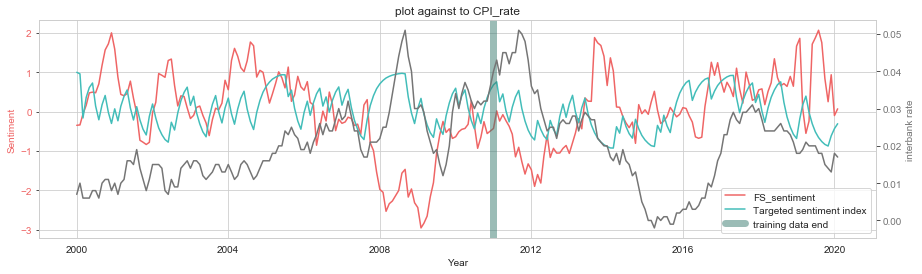

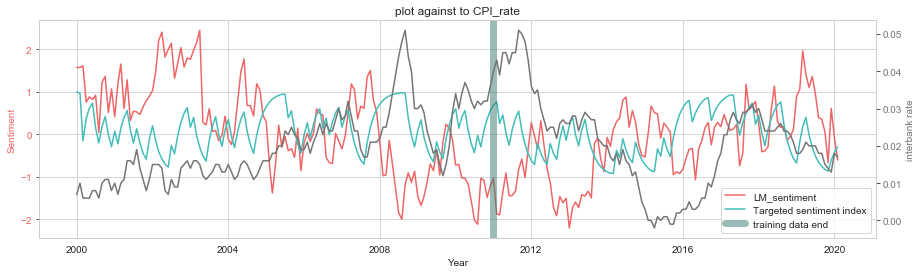

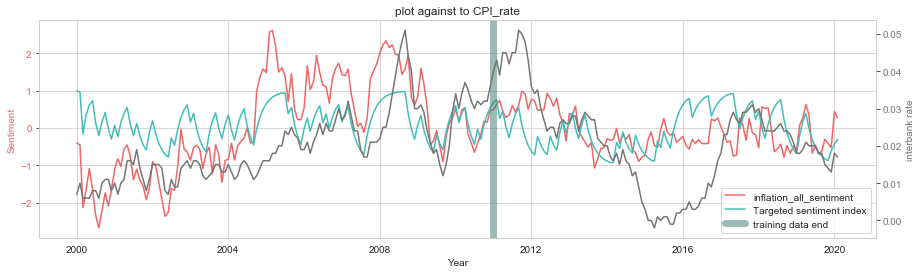

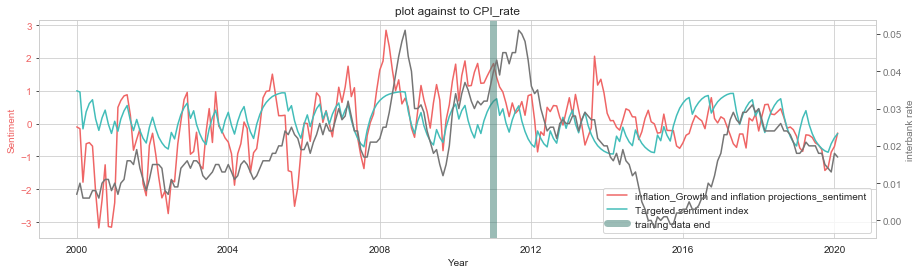

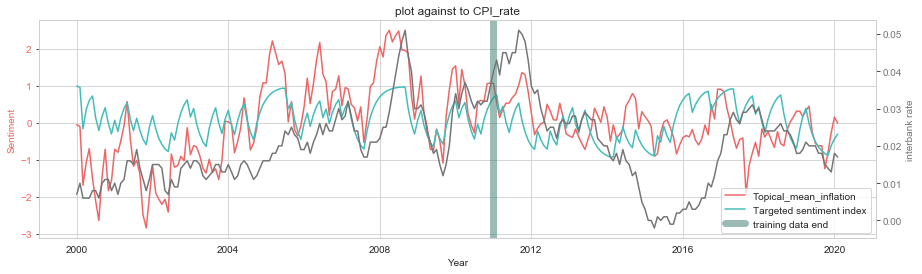

Correlation with Averaging
                inflation_all_sentiment  Topical_mean_inflation  FS_sentiment  \
label_3                        0.400380                0.421289     -0.135007   
cpi_change                     0.071810                0.126603      0.058226   
cpi                            0.443487                0.389811     -0.453877   
CPI_rate                       0.518479                0.513380     -0.411051   
change_of_rate                 0.073539                0.083404      0.038439   

                LM_sentiment  \
label_3            -0.079764   
cpi_change          0.055486   
cpi                -0.498389   
CPI_rate           -0.497984   
change_of_rate     -0.009485   

                inflation_Growth and inflation projections_sentiment  
label_3                                                  0.325026     
cpi_change                                               0.089337     
cpi                                                      0.394295     
CPI_rate 

,label,label_2,sentiment_1,base_all_sentiment,label_3,inflation_all_sentiment,inflation_Financial markets_sentiment,inflation_The immediate policy decision_sentiment,inflation_Growth and inflation projections_sentiment,"inflation_Money, credit, demand and output_sentiment","inflation_Supply, costs and prices_sentiment",inflation_The international economy_sentiment,Topical_mean_inflation,FS_sentiment,LM_sentiment,cpi_change,cpi,CPI_rate,change_of_rate
label,1.000000,0.357758,0.301288,0.386623,0.003594,0.094553,-0.003080,0.135406,0.202137,0.234103,-0.009242,0.245360,0.119690,0.202121,-0.124814,0.129214,0.237029,0.287221,0.049733
label_2,0.357758,1.000000,0.656056,0.756463,-0.031254,0.028417,0.030445,-0.149775,0.010450,0.077878,0.003396,0.226488,0.019479,0.321217,0.104232,-0.110340,0.097246,0.050809,-0.047598
sentiment_1,0.301288,0.656056,1.000000,0.901069,0.104505,0.282507,0.186082,-0.105304,-0.080967,0.399274,0.423845,0.236462,0.173484,0.323712,0.241936,0.009794,-0.128808,-0.137432,-0.035018
base_all_sentiment,0.386623,0.756463,0.901069,1.000000,0.040775,0.112428,0.074253,-0.179897,-0.125091,0.274805,0.262068,0.188815,0.059392,0.531081,0.256487,-0.020213,-0.186039,-0.189120,-0.016896
label_3,0.003594,-0.031254,0.104505,0.040775,1.000000,0.400380,0.405465,0.299476,0.325026,0.389372,0.178218,0.161468,0.421289,-0.135007,-0.079764,0.179517,-0.074025,0.239822,0.214422
inflation_all_sentiment,0.094553,0.028417,0.282507,0.112428,0.400380,1.000000,0.807320,0.680943,0.605875,0.588562,0.526405,0.675639,0.852933,-0.461183,-0.422854,0.071810,0.443487,0.518479,0.073539
inflation_Financial markets_sentiment,-0.003080,0.030445,0.186082,0.074253,0.405465,0.807320,1.000000,0.660920,0.564284,0.508903,0.453600,0.619570,0.875118,-0.339771,-0.379281,0.042788,0.298087,0.400211,0.103946
inflation_The immediate policy decision_sentiment,0.135406,-0.149775,-0.105304,-0.179897,0.299476,0.680943,0.660920,1.000000,0.544439,0.300049,0.266275,0.629653,0.826243,-0.392930,-0.539233,0.056603,0.452458,0.571296,0.063407
inflation_Growth and inflation projections_sentiment,0.202137,0.010450,-0.080967,-0.125091,0.325026,0.605875,0.564284,0.544439,1.000000,0.359243,0.217552,0.446931,0.693904,-0.435181,-0.464166,0.089337,0.394295,0.473603,0.075964
"inflation_Money, credit, demand and output_sentiment",0.234103,0.077878,0.399274,0.274805,0.389372,0.588562,0.508903,0.300049,0.359243,1.000000,0.353220,0.376934,0.556012,-0.100459,-0.080943,0.171195,0.106698,0.203136,0.035832


In [241]:
result,result2 = rolling_averaging_ewm_inflation(sentiment_97_10_merged_prob_inflation,start='2000-01-01')
visualise_prob_model_inflation(result)
print('Correlation with Averaging')
print(result.corr().loc[['label_3','cpi_change','cpi','CPI_rate','change_of_rate'],['inflation_all_sentiment','Topical_mean_inflation','FS_sentiment','LM_sentiment','inflation_Growth and inflation projections_sentiment']])
print('Correlation No Averaging')
print(result2.corr())
result.corr()



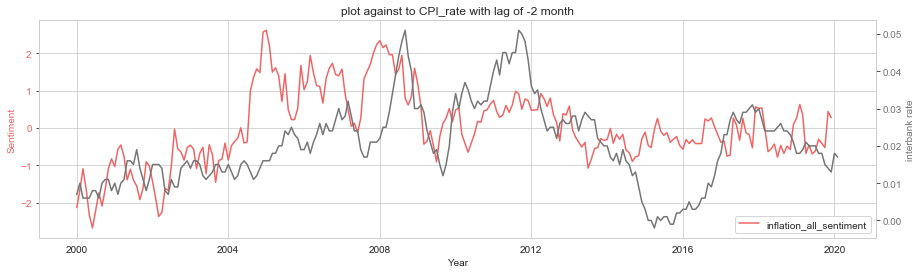

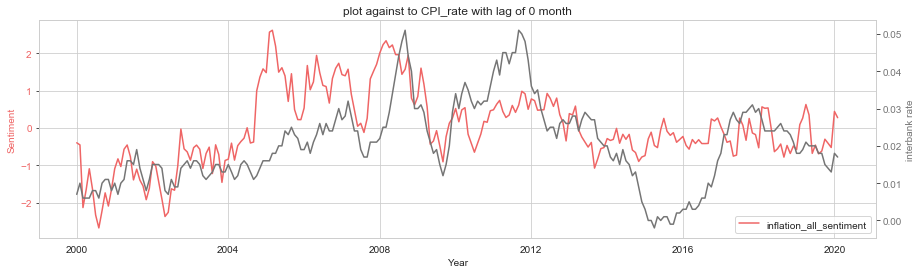

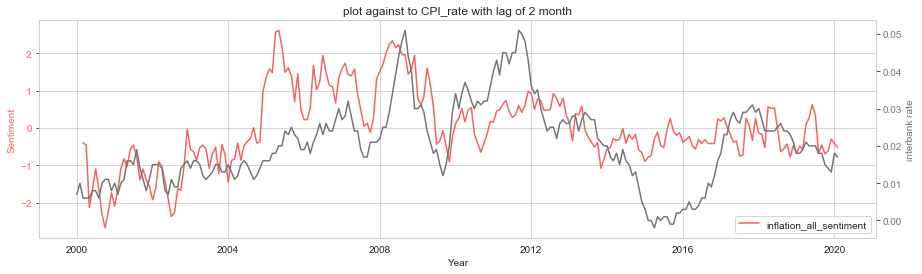

,lag -5,lag -4,lag -3,lag -2,lag -1,lag 0,lag 1,lag 2,lag 3,lag 4,lag 5
CPI_rate,0.366342,0.378048,0.39955,0.426918,0.468299,0.518479,0.539195,0.543973,0.545306,0.545698,0.528615


In [242]:
describe_lagged_information(result,rate='CPI_rate',sentiment ='inflation_all_sentiment')

In [246]:
model[0]

,sentiment,p percentage no neutral
Entry,,
alongsid,Positive,0.661765
properti,Positive,0.652174
pension,Positive,0.646154
intermedi,Positive,0.637931
disrupt,Positive,0.625000
...,...,...
rose,Negative,0.440678
credibl,Negative,0.440860
meant,Negative,0.441176
